### Step 1: Obtain Data

### Step 2: Create baseline x_train and y_train (without the splits)

In [ ]:
# Suppress warnings
import os
import pandas as pd

from PIL import Image
import warnings

# Define base folders
pangolin_folder = "Pangolin_Images_3_12_Preprocessed"
other_animals_folder = "Other_Animal_Images_TREE_Preprocessed"

# Get the list of files in each folder
pangolin_files = [f for f in os.listdir(pangolin_folder) if f.endswith('.JPG')]
other_animal_files = [f for f in os.listdir(other_animals_folder) if f.endswith('.JPG')]

# Create file paths for each image
pangolin_filepaths = [os.path.join(pangolin_folder, f) for f in pangolin_files]
other_animal_filepaths = [os.path.join(other_animals_folder, f) for f in other_animal_files]

# Suppress warnings
warnings.filterwarnings("ignore")

# Convert each image in Other_Animal_Images_TREE to grayscale
for filepath in other_animal_filepaths:
    img = Image.open(filepath)
    grayscale_img = img.convert("L")  # Convert to grayscale
    grayscale_img.save(filepath)  # Overwrite the original file


# Combine file paths and create labels
filepaths = pangolin_filepaths + other_animal_filepaths
labels = [1] * len(pangolin_filepaths) + [0] * len(other_animal_filepaths)

# Create the DataFrame for x_train
x_train = pd.DataFrame(filepaths, columns=['filepath'])

# Create the DataFrame for y_train with binary labels
y_train = pd.DataFrame(labels, columns=['label'])

# Set the index to be the filename without the '.JPG' extension
x_train.index = [os.path.splitext(os.path.basename(f))[0] for f in filepaths]
y_train.index = x_train.index  # Use the same index for y_train

# Set column names
x_train.index.name = 'id'
y_train.index.name = 'id'

# Combine x_train and y_train into a single DataFrame
combined_df = pd.concat([x_train], axis=1)
#y_train = y_train.to_numpy().argmax(axis=1)
# Print the combined DataFrame
#print(combined_df.head())
#print(x_train.head)
y_train = y_train["label"].to_numpy()
print(y_train)
print(len(y_train))

[1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1
 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 

In [2]:
from PIL import Image

# Check if all images in x_train are grayscale
all_grayscale = True

for path in x_train['filepath']:
    with Image.open(path) as img:
        if img.mode != 'L':  # 'L' means 8-bit pixels, black and white
            print(f"Not grayscale: {path} (mode: {img.mode})")
            all_grayscale = False

if all_grayscale:
    print("✅ All images in x_train are grayscale.")
else:
    print("❌ Some images in x_train are not grayscale.")


✅ All images in x_train are grayscale.


### Step 3: The Dataset

First, we'll create an `ImagesDataset` class that will define how we access our data and any transformations we might want to apply. 

This new class will inherit from the PyTorch [`Dataset`](https://pytorch.org/tutorials/beginner/basics/data_tutorial.html) class, but we'll also need to define our own `__init__`, `__len__` and `__getitem__` **special methods**:
* **`__init__`** will instantiate the dataset object with two dataframes: an `x_train` df containing image IDs and image file paths, and a `y_train` df containing image IDs and labels. This will run once when we first create the dataset object, e.g. with `dataset = ImagesDataset(x_train, y_train)`.
* **`__getitem__`** will define how we access a sample from the data. This method gets called whenever we use an indexing operation like `dataset[index]`. In this case, whenever accessing a particular image sample (for example, to get the first image we'd do `dataset[0]`) the following will happen:
  * look up the image filepath using the index
  * load the image with [`PIL.Image`](https://pillow.readthedocs.io/en/stable/reference/Image.html)
  * apply some transformations (more on this below)
  * return a dictionary containing the image ID, the image itself as a Tensor, and a label (if it exists)
* **`__len__`** simply returns the size of the dataset, which we do by calling `len` on the input dataframe.

In [3]:
import torch
from torch.utils.data import Dataset
from torchvision import transforms


class ImagesDataset(Dataset):
    """Reads in an image, transforms pixel values, and serves
    a dictionary containing the image id, image tensors, and label.
    """

    def __init__(self, x_df, y_df=None):
        # This will run once when we first create the dataset object, e.g. with `dataset = ImagesDataset(x_train, y_train)`
        # Will instantiate the dataset object with 2 dataframes
        # x_train_df = contains image IDs and image file paths
        # y_train_df = contains image IDs and labels
        self.data = x_df
        self.label = y_df
        self.transform = transforms.Compose(
            [
                transforms.Resize((224, 224)), # resizes image to 224x224 pixels
                transforms.ToTensor(), # converts image to a PyTorch Tensor, normalizing pixel values b/w 0 and 1
                transforms.Normalize( # standardizes image using mean and standard dev of the ImageNet dataset
                    mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)
                ),
            ]
        )

    def __getitem__(self, index):
        filepath = self.data.iloc[index]["filepath"]
        # Skip non-image files like .DS_Store
        if filepath.endswith(".DS_Store"):
            print(filepath)

        image = Image.open(self.data.iloc[index]["filepath"]).convert("RGB") # Opens image from filepath and converts it to RBG image
        image = self.transform(image) # Applies transformation pipeline (resize, tensor conversion, normalization)
        image_id = self.data.index[index] # Retrieves image ID
        # if we don't have labels (e.g. for test set) just return the image and image id
        if self.label is None:
            sample = {"image_id": image_id, "image": image} # If no label, returns dictionary with just image_id and transformed image (so if no y_df)
        else: # If label: 
            label = torch.tensor(self.label[index], 
                                 dtype=torch.float) # Converts label into a PyTorch Tensor
            sample = {"image_id": image_id, "image": image, "label": label} # Returns a dictionary containing image_id, image, and label
        return sample

    def __len__(self): # Returns # of images in x_df (length of dataset)
        return len(self.data)

## STEP 4: Training

#### STRATIFIED KFOLD
For K_Fold:
- 80% train, 20% test
- Within train, we further split:
- 90% train, 10% val
- Train and validate for 15 epochs/fold
- Save the best model as that which produces the lowest val loss
- Run the best model of each fold on the test data for that fold


Fold 1/5


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0151556..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0151556..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0151556..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0151556..2.64].
Clipping input data to 

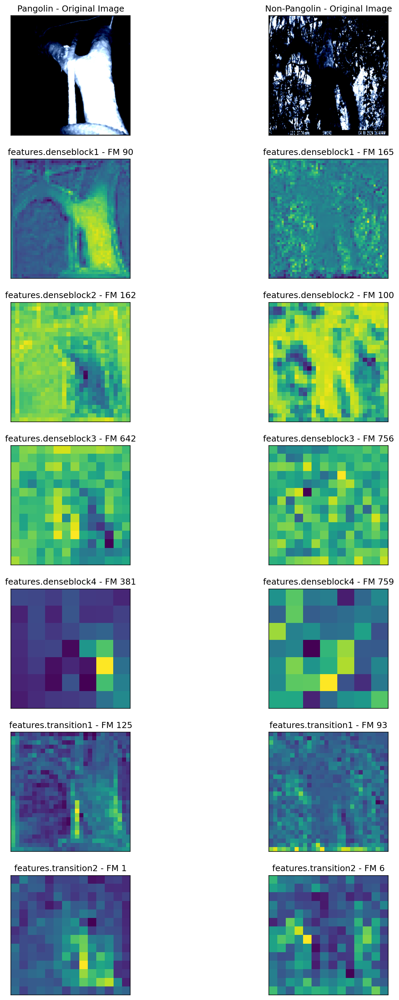

Saving for this epoch 0
Epoch [1/15], Train Loss: 0.6829, Validation Loss: 0.6915
Training Per-Species Metrics:
Precision: 0.7445, Recall: 0.4766, F1: 0.5812
Species 1 - Accuracy: 0.5928, Precision: 0.5000, Recall: 0.7619, F1: 0.6038
Training Overall Accuracy: 0.5928, Precision: 0.6223, Recall: 0.6193, F1: 0.5925
Validation Overall Accuracy: 0.4634, Precision: 0.5246, Recall: 0.5159, F1: 0.4363
Epoch time 188.4845621585846





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

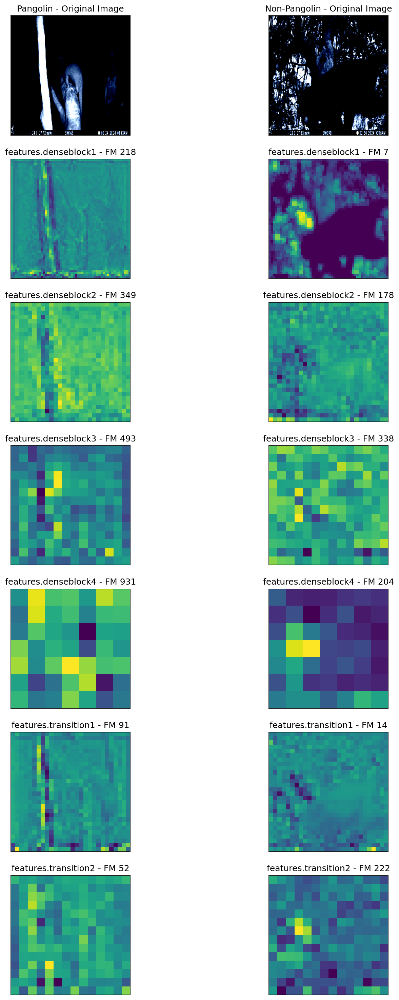

0.691457062959671
Saving for this epoch 1
Epoch [2/15], Train Loss: 0.6458, Validation Loss: 0.6581
Training Per-Species Metrics:
Precision: 0.6603, Recall: 0.9720, F1: 0.7864
Species 1 - Accuracy: 0.6870, Precision: 0.8696, Recall: 0.2721, F1: 0.4145
Training Overall Accuracy: 0.6870, Precision: 0.7649, Recall: 0.6220, F1: 0.6004
Validation Overall Accuracy: 0.7805, Precision: 0.8636, Recall: 0.7353, F1: 0.7411
Epoch time 158.21058201789856





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

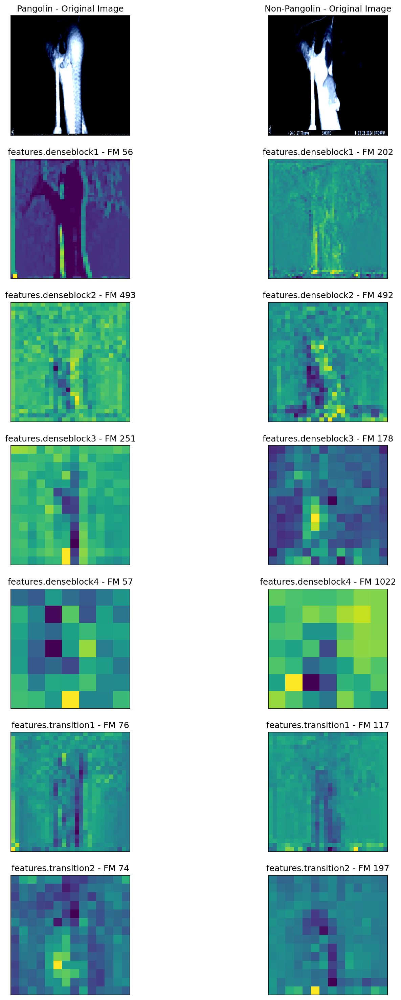

0.6581278741359711
Saving for this epoch 2
Epoch [3/15], Train Loss: 0.6098, Validation Loss: 0.5995
Training Per-Species Metrics:
Precision: 0.6265, Recall: 0.9953, F1: 0.7690
Species 1 - Accuracy: 0.6454, Precision: 0.9524, Recall: 0.1361, F1: 0.2381
Training Overall Accuracy: 0.6454, Precision: 0.7894, Recall: 0.5657, F1: 0.5035
Validation Overall Accuracy: 0.6829, Precision: 0.8243, Recall: 0.6176, F1: 0.5839
Epoch time 168.91292905807495





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.843908..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.843908..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.843908..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.843908..2.64].
Clipping input data to the 

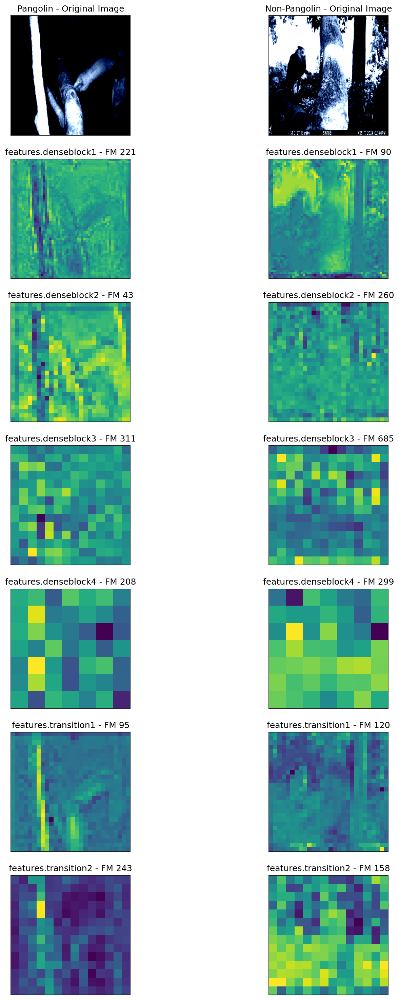

0.5994865894317627
Saving for this epoch 3
Epoch [4/15], Train Loss: 0.5775, Validation Loss: 0.5524
Training Per-Species Metrics:
Precision: 0.6294, Recall: 1.0000, F1: 0.7726
Species 1 - Accuracy: 0.6510, Precision: 1.0000, Recall: 0.1429, F1: 0.2500
Training Overall Accuracy: 0.6510, Precision: 0.8147, Recall: 0.5714, F1: 0.5113
Validation Overall Accuracy: 0.7073, Precision: 0.8333, Recall: 0.6471, F1: 0.6273
Epoch time 171.74485301971436





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

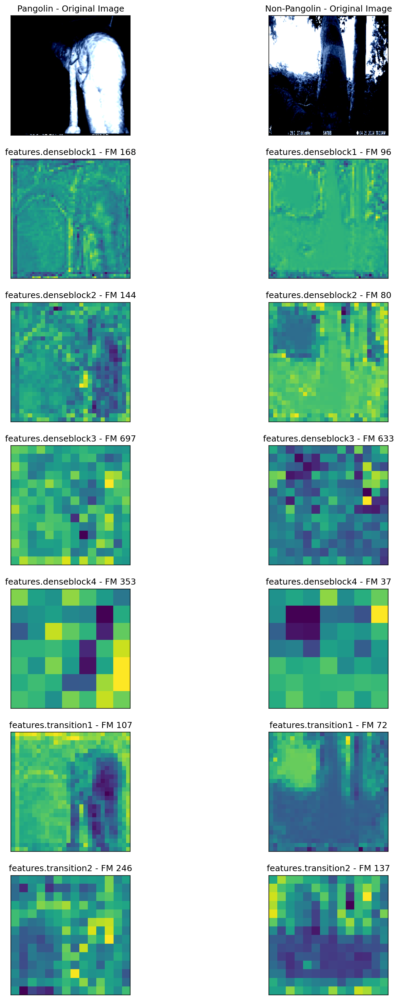

0.552448034286499
Saving for this epoch 4
Epoch [5/15], Train Loss: 0.5504, Validation Loss: 0.5118
Training Per-Species Metrics:
Precision: 0.6524, Recall: 1.0000, F1: 0.7897
Species 1 - Accuracy: 0.6842, Precision: 1.0000, Recall: 0.2245, F1: 0.3667
Training Overall Accuracy: 0.6842, Precision: 0.8262, Recall: 0.6122, F1: 0.5782
Validation Overall Accuracy: 0.7317, Precision: 0.8429, Recall: 0.6765, F1: 0.6676
Epoch time 160.58316707611084





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

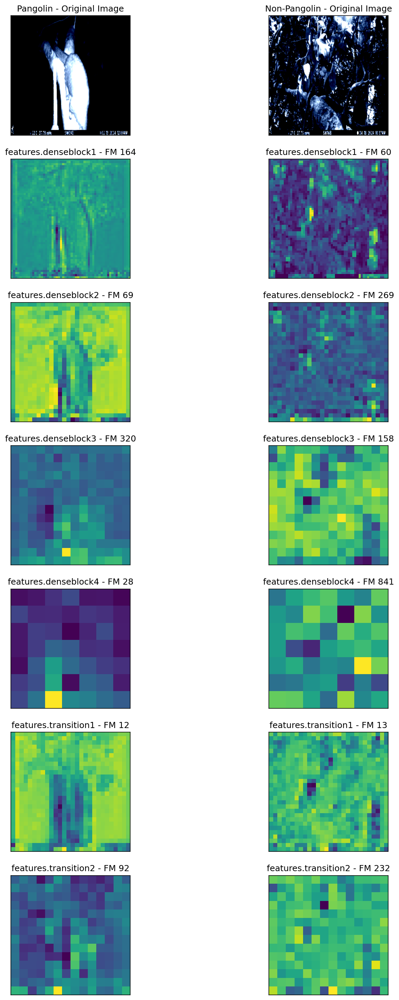

0.511756181716919
Saving for this epoch 5
Epoch [6/15], Train Loss: 0.5184, Validation Loss: 0.4772
Training Per-Species Metrics:
Precision: 0.7186, Recall: 0.9907, F1: 0.8330
Species 1 - Accuracy: 0.7645, Precision: 0.9697, Recall: 0.4354, F1: 0.6009
Training Overall Accuracy: 0.7645, Precision: 0.8442, Recall: 0.7130, F1: 0.7170
Validation Overall Accuracy: 0.8537, Precision: 0.9000, Recall: 0.8235, F1: 0.8373
Epoch time 169.84701895713806





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

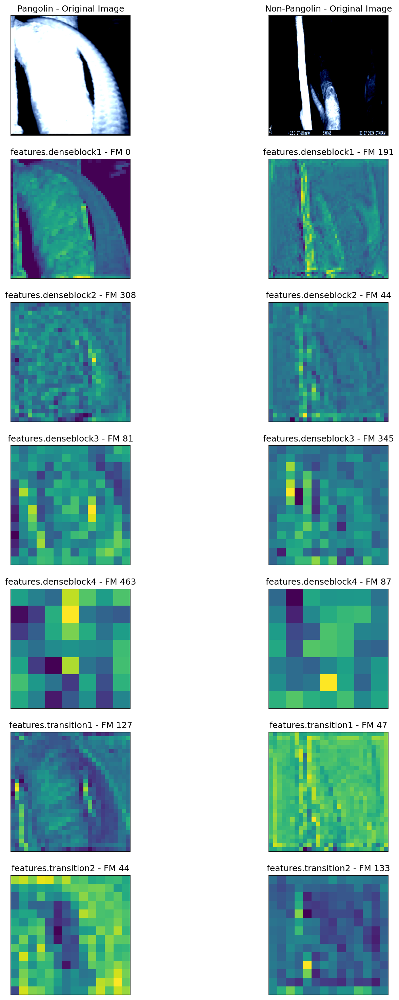

0.477161169052124
Saving for this epoch 6
Epoch [7/15], Train Loss: 0.4788, Validation Loss: 0.4620
Training Per-Species Metrics:
Precision: 0.8000, Recall: 0.9720, F1: 0.8776
Species 1 - Accuracy: 0.8393, Precision: 0.9406, Recall: 0.6463, F1: 0.7661
Training Overall Accuracy: 0.8393, Precision: 0.8703, Recall: 0.8091, F1: 0.8219
Validation Overall Accuracy: 0.9268, Precision: 0.9444, Recall: 0.9118, F1: 0.9222
Epoch time 168.07559180259705





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8096584..2.169412].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8096584..2.169412].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8096584..2.169412].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8096584..2.169412].
Clippin

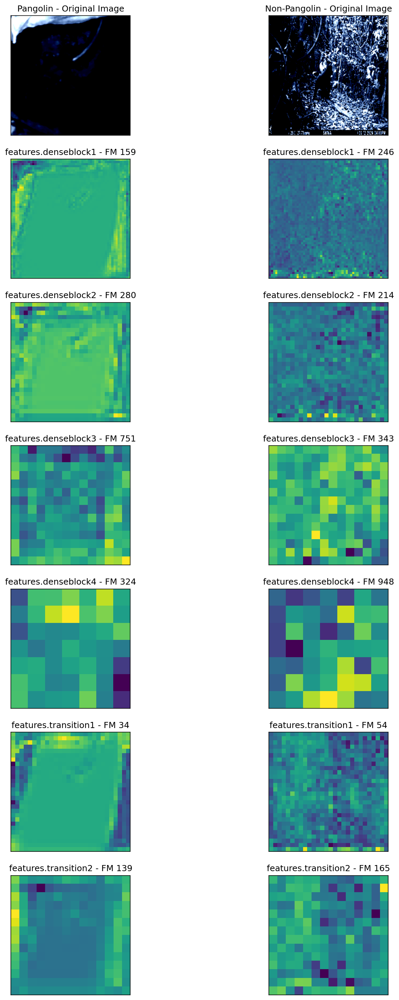

0.4619775116443634
Saving for this epoch 7
Epoch [8/15], Train Loss: 0.4399, Validation Loss: 0.4251
Training Per-Species Metrics:
Precision: 0.8739, Recall: 0.9720, F1: 0.9204
Species 1 - Accuracy: 0.9003, Precision: 0.9512, Recall: 0.7959, F1: 0.8667
Training Overall Accuracy: 0.9003, Precision: 0.9126, Recall: 0.8839, F1: 0.8935
Validation Overall Accuracy: 0.9512, Precision: 0.9615, Recall: 0.9412, F1: 0.9487
Epoch time 158.94113159179688





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

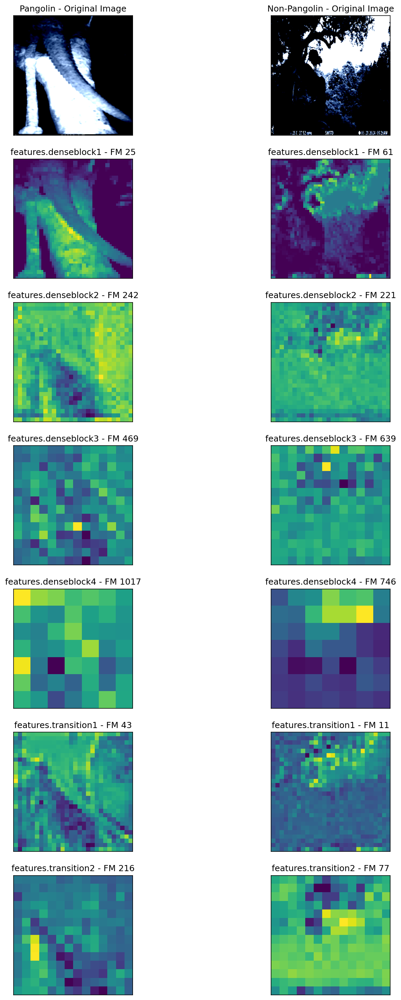

0.42512108385562897
Saving for this epoch 8
Epoch [9/15], Train Loss: 0.4154, Validation Loss: 0.3964
Training Per-Species Metrics:
Precision: 0.8712, Recall: 0.9486, F1: 0.9083
Species 1 - Accuracy: 0.8864, Precision: 0.9141, Recall: 0.7959, F1: 0.8509
Training Overall Accuracy: 0.8864, Precision: 0.8927, Recall: 0.8723, F1: 0.8796
Validation Overall Accuracy: 0.9512, Precision: 0.9615, Recall: 0.9412, F1: 0.9487
Epoch time 163.71700978279114





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

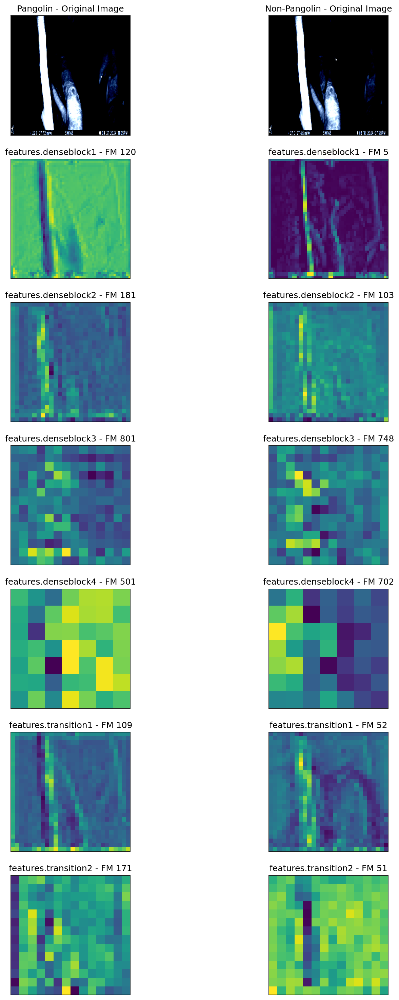

0.3963790088891983
Saving for this epoch 9
Epoch [10/15], Train Loss: 0.3772, Validation Loss: 0.3477
Training Per-Species Metrics:
Precision: 0.8894, Recall: 0.9766, F1: 0.9310
Species 1 - Accuracy: 0.9141, Precision: 0.9603, Recall: 0.8231, F1: 0.8864
Training Overall Accuracy: 0.9141, Precision: 0.9248, Recall: 0.8999, F1: 0.9087
Validation Overall Accuracy: 0.9512, Precision: 0.9615, Recall: 0.9412, F1: 0.9487
Epoch time 177.51285409927368





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8267832..2.465708].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8267832..2.465708].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8267832..2.465708].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8267832..2.465708].
Clippin

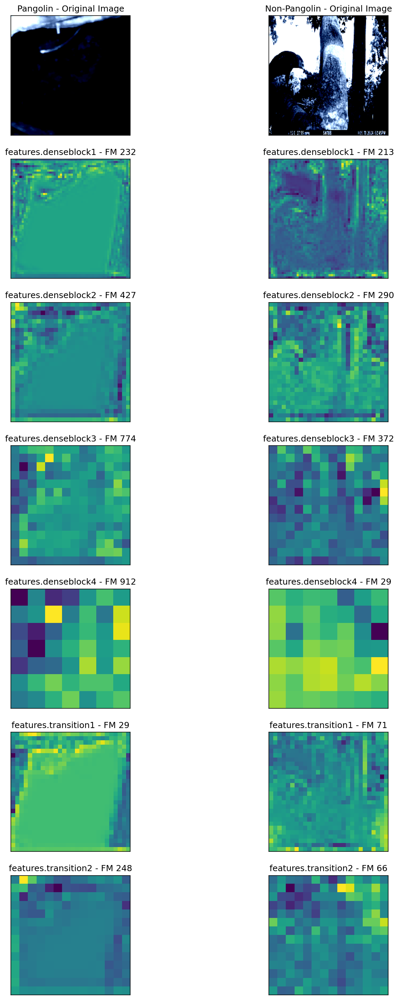

0.34773001074790955
Saving for this epoch 10
Epoch [11/15], Train Loss: 0.3599, Validation Loss: 0.3123
Training Per-Species Metrics:
Precision: 0.8776, Recall: 0.9720, F1: 0.9224
Species 1 - Accuracy: 0.9030, Precision: 0.9516, Recall: 0.8027, F1: 0.8708
Training Overall Accuracy: 0.9030, Precision: 0.9146, Recall: 0.8873, F1: 0.8966
Validation Overall Accuracy: 0.9512, Precision: 0.9615, Recall: 0.9412, F1: 0.9487
Epoch time 168.24133682250977





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

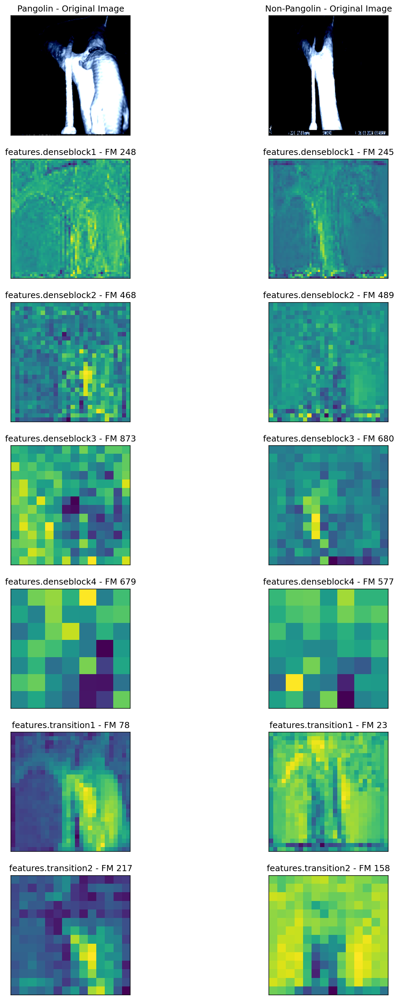

0.3123273104429245
Saving for this epoch 11
Epoch [12/15], Train Loss: 0.3247, Validation Loss: 0.2882
Training Per-Species Metrics:
Precision: 0.8846, Recall: 0.9673, F1: 0.9241
Species 1 - Accuracy: 0.9058, Precision: 0.9449, Recall: 0.8163, F1: 0.8759
Training Overall Accuracy: 0.9058, Precision: 0.9147, Recall: 0.8918, F1: 0.9000
Validation Overall Accuracy: 0.9512, Precision: 0.9615, Recall: 0.9412, F1: 0.9487
Epoch time 163.64847826957703





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8610327..2.3611329].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8610327..2.3611329].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8610327..2.3611329].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8610327..2.3611329].
Cli

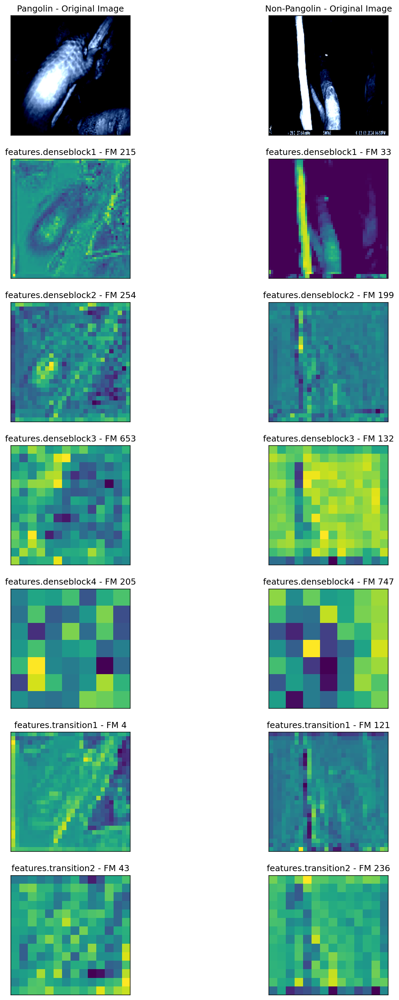

0.28816385567188263
Saving for this epoch 12
Epoch [13/15], Train Loss: 0.3198, Validation Loss: 0.2488
Training Per-Species Metrics:
Precision: 0.8860, Recall: 0.9439, F1: 0.9140
Species 1 - Accuracy: 0.8947, Precision: 0.9098, Recall: 0.8231, F1: 0.8643
Training Overall Accuracy: 0.8947, Precision: 0.8979, Recall: 0.8835, F1: 0.8892
Validation Overall Accuracy: 0.9512, Precision: 0.9615, Recall: 0.9412, F1: 0.9487
Epoch time 164.09985995292664





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.1007793..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.1007793..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.1007793..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.1007793..2.64].
Clipping input data to 

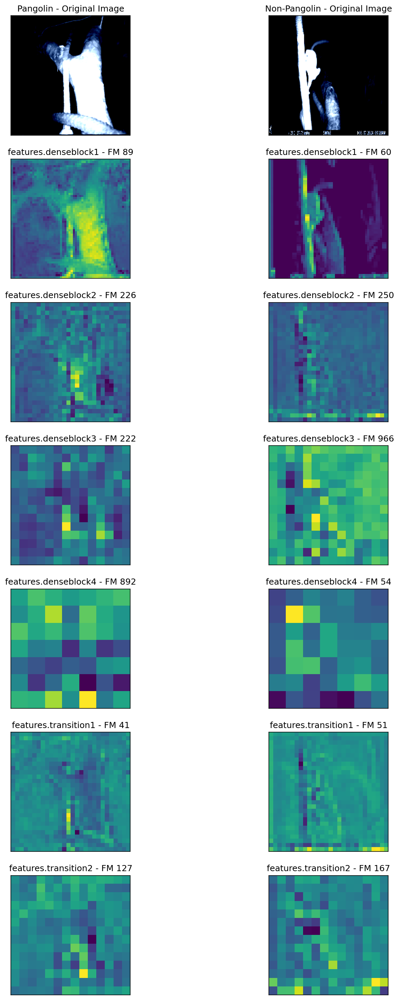

0.24879593402147293
Saving for this epoch 13
Epoch [14/15], Train Loss: 0.2945, Validation Loss: 0.2255
Training Per-Species Metrics:
Precision: 0.8870, Recall: 0.9533, F1: 0.9189
Species 1 - Accuracy: 0.9003, Precision: 0.9237, Recall: 0.8231, F1: 0.8705
Training Overall Accuracy: 0.9003, Precision: 0.9053, Recall: 0.8882, F1: 0.8947
Validation Overall Accuracy: 0.9756, Precision: 0.9800, Recall: 0.9706, F1: 0.9746
Epoch time 179.10325026512146





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

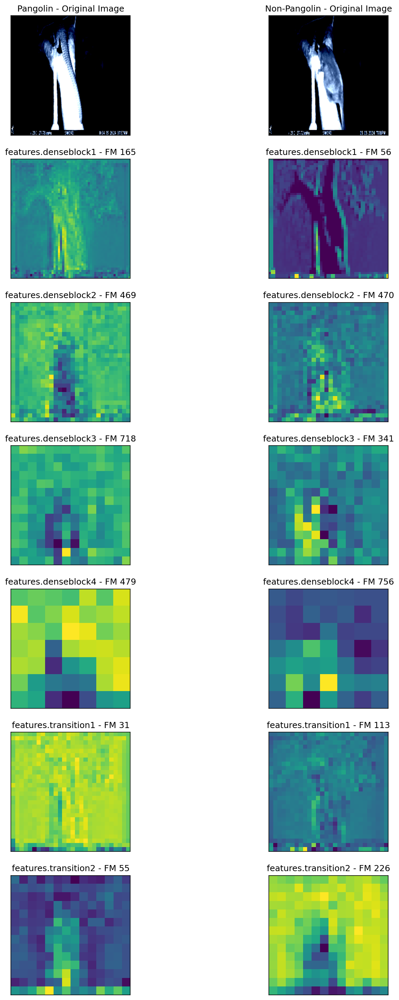

0.2255384400486946
Saving for this epoch 14
Epoch [15/15], Train Loss: 0.2636, Validation Loss: 0.2102
Training Per-Species Metrics:
Precision: 0.9361, Recall: 0.9579, F1: 0.9469
Species 1 - Accuracy: 0.9363, Precision: 0.9366, Recall: 0.9048, F1: 0.9204
Training Overall Accuracy: 0.9363, Precision: 0.9363, Recall: 0.9314, F1: 0.9336
Validation Overall Accuracy: 0.9756, Precision: 0.9800, Recall: 0.9706, F1: 0.9746
Epoch time 164.39759802818298



Test Metrics - Accuracy: 0.9505, Precision: 0.9512, Recall: 0.9286, F1: 0.9398, AUC: 0.9859
Test Per-Species Metrics:
Precision: 0.9500, Recall: 0.9661, F1: 0.9580
Species 1 - Accuracy: 0.9505, Precision: 0.9512, Recall: 0.9286, F1: 0.9398
Fold 2/5


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

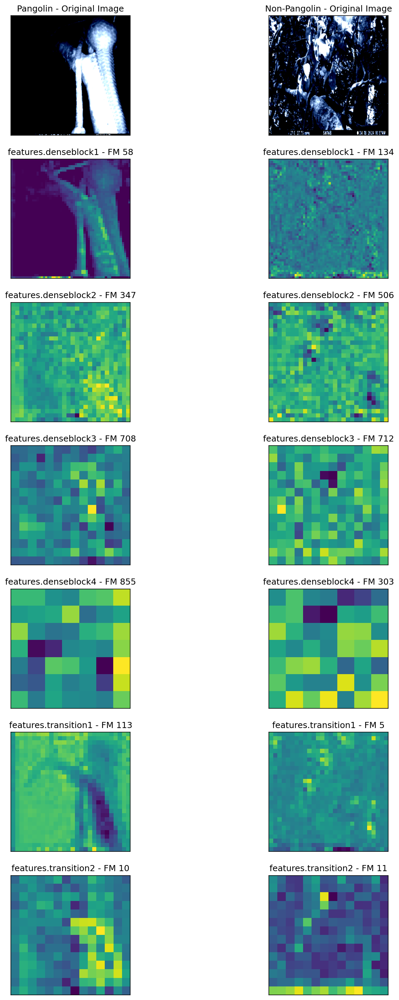

Saving for this epoch 0
Epoch [1/15], Train Loss: 0.6916, Validation Loss: 0.6959
Training Per-Species Metrics:
Precision: 0.8026, Recall: 0.2864, F1: 0.4221
Species 1 - Accuracy: 0.5374, Precision: 0.4667, Recall: 0.8986, F1: 0.6143
Training Overall Accuracy: 0.5374, Precision: 0.6346, Recall: 0.5925, F1: 0.5182
Validation Overall Accuracy: 0.5366, Precision: 0.7361, Recall: 0.6042, F1: 0.4932
Epoch time 164.09994173049927





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.169412].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.169412].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.169412].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input 

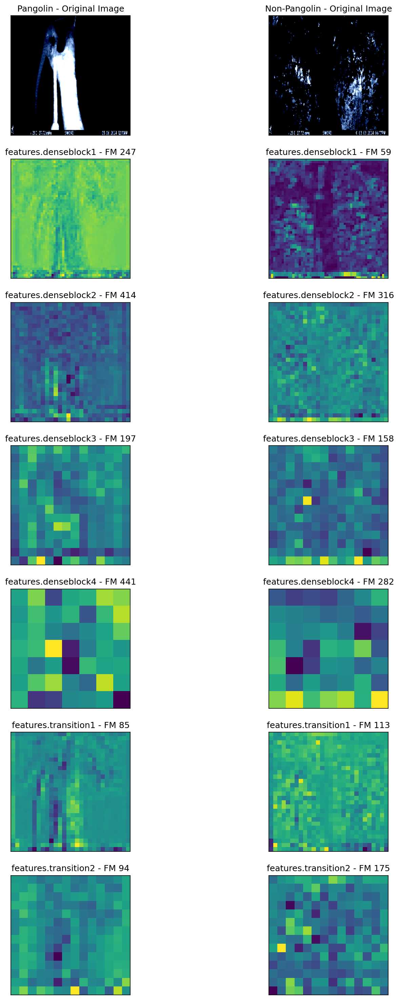

0.6959202587604523
Saving for this epoch 1
Epoch [2/15], Train Loss: 0.6421, Validation Loss: 0.6410
Training Per-Species Metrics:
Precision: 0.6317, Recall: 0.9906, F1: 0.7715
Species 1 - Accuracy: 0.6537, Precision: 0.9259, Recall: 0.1689, F1: 0.2857
Training Overall Accuracy: 0.6537, Precision: 0.7788, Recall: 0.5798, F1: 0.5286
Validation Overall Accuracy: 0.6585, Precision: 0.8158, Recall: 0.5882, F1: 0.5371
Epoch time 177.08810806274414





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

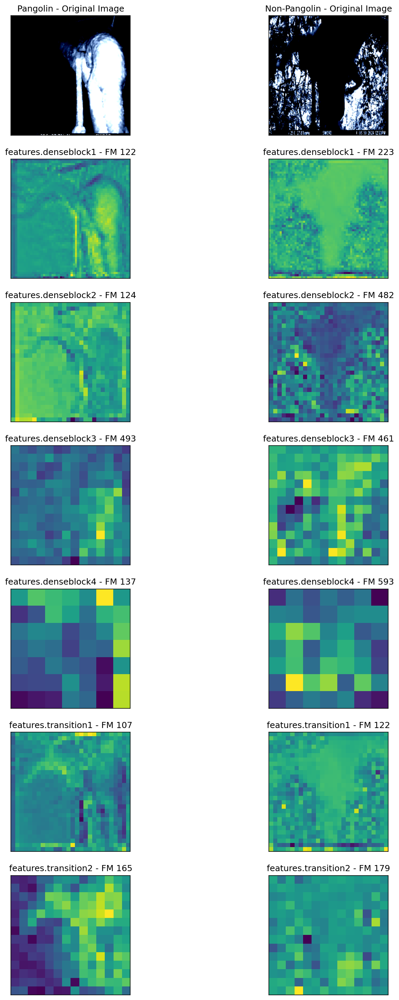

0.6410057544708252
Saving for this epoch 2
Epoch [3/15], Train Loss: 0.6008, Validation Loss: 0.5799
Training Per-Species Metrics:
Precision: 0.6138, Recall: 1.0000, F1: 0.7607
Species 1 - Accuracy: 0.6288, Precision: 1.0000, Recall: 0.0946, F1: 0.1728
Training Overall Accuracy: 0.6288, Precision: 0.8069, Recall: 0.5473, F1: 0.4668
Validation Overall Accuracy: 0.6585, Precision: 0.8158, Recall: 0.5882, F1: 0.5371
Epoch time 190.4762737751007





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8267832..2.465708].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8267832..2.465708].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8267832..2.465708].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8267832..2.465708].
Clippin

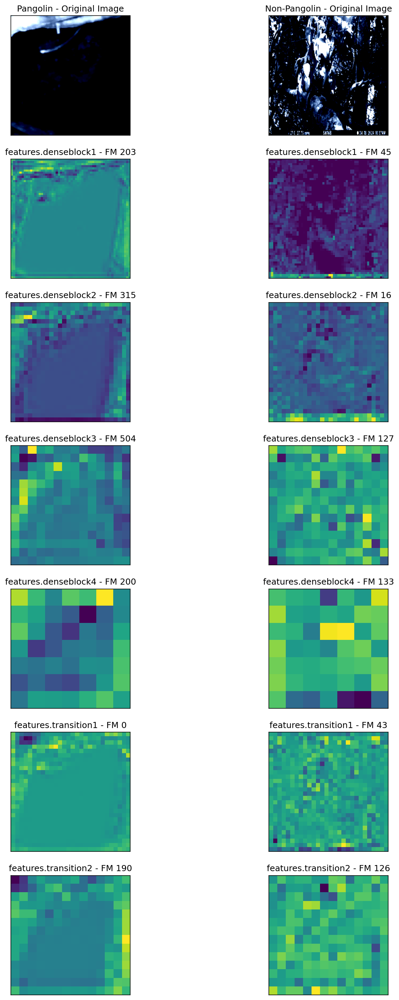

0.5799463987350464
Saving for this epoch 3
Epoch [4/15], Train Loss: 0.5683, Validation Loss: 0.5272
Training Per-Species Metrics:
Precision: 0.6283, Recall: 1.0000, F1: 0.7717
Species 1 - Accuracy: 0.6510, Precision: 1.0000, Recall: 0.1486, F1: 0.2588
Training Overall Accuracy: 0.6510, Precision: 0.8142, Recall: 0.5743, F1: 0.5153
Validation Overall Accuracy: 0.7073, Precision: 0.8333, Recall: 0.6471, F1: 0.6273
Epoch time 183.58801579475403





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8267832..2.5179958].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8267832..2.5179958].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8267832..2.5179958].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8267832..2.5179958].
Cli

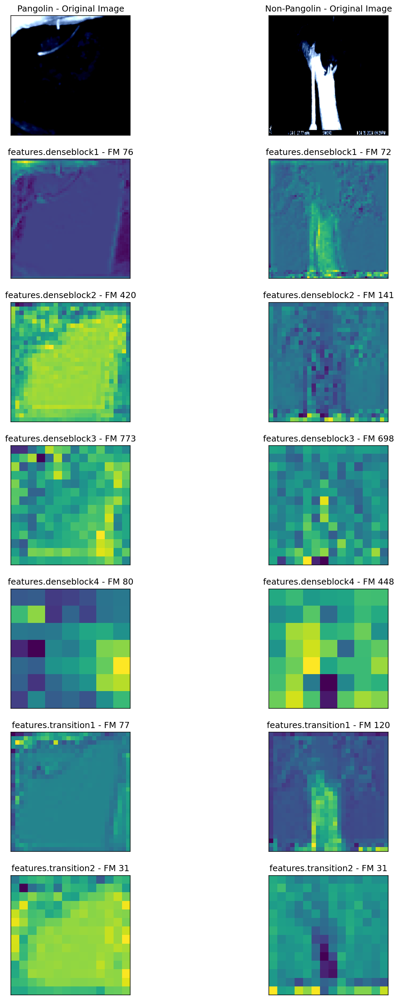

0.5272342264652252
Saving for this epoch 4
Epoch [5/15], Train Loss: 0.5348, Validation Loss: 0.4844
Training Per-Species Metrics:
Precision: 0.7053, Recall: 1.0000, F1: 0.8272
Species 1 - Accuracy: 0.7535, Precision: 1.0000, Recall: 0.3986, F1: 0.5700
Training Overall Accuracy: 0.7535, Precision: 0.8526, Recall: 0.6993, F1: 0.6986
Validation Overall Accuracy: 0.8293, Precision: 0.8871, Recall: 0.7941, F1: 0.8067
Epoch time 179.3910150527954





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

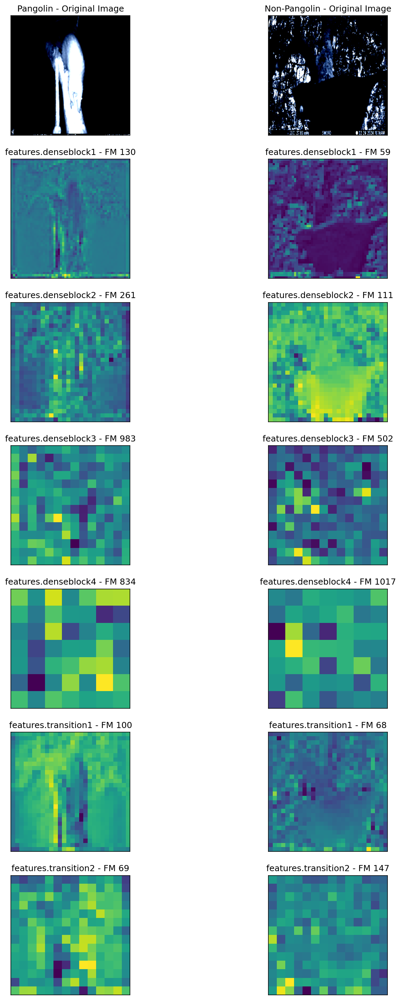

0.4843800365924835
Saving for this epoch 5
Epoch [6/15], Train Loss: 0.4967, Validation Loss: 0.4514
Training Per-Species Metrics:
Precision: 0.7664, Recall: 0.9859, F1: 0.8624
Species 1 - Accuracy: 0.8144, Precision: 0.9655, Recall: 0.5676, F1: 0.7149
Training Overall Accuracy: 0.8144, Precision: 0.8660, Recall: 0.7767, F1: 0.7887
Validation Overall Accuracy: 0.8537, Precision: 0.9000, Recall: 0.8235, F1: 0.8373
Epoch time 167.0530650615692





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.7582842..2.3088455].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.7582842..2.3088455].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.7582842..2.3088455].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.7582842..2.3088455].
Cli

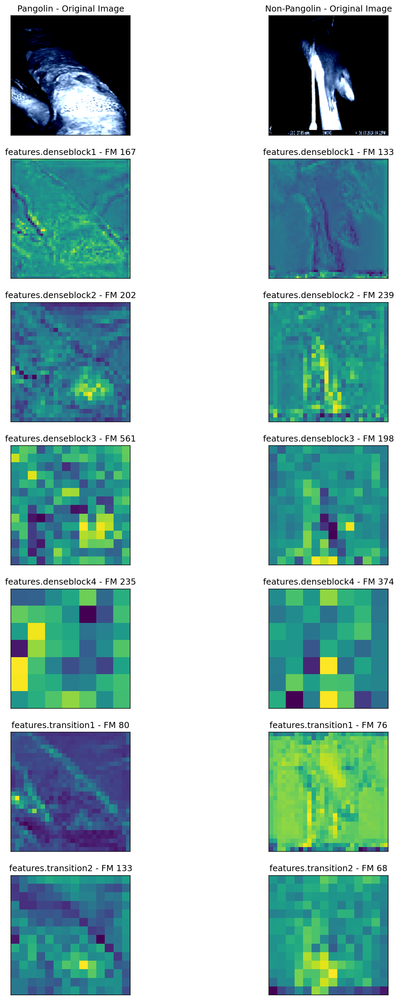

0.4513700604438782
Saving for this epoch 6
Epoch [7/15], Train Loss: 0.4628, Validation Loss: 0.4099
Training Per-Species Metrics:
Precision: 0.8178, Recall: 0.9906, F1: 0.8960
Species 1 - Accuracy: 0.8643, Precision: 0.9806, Recall: 0.6824, F1: 0.8048
Training Overall Accuracy: 0.8643, Precision: 0.8992, Recall: 0.8365, F1: 0.8504
Validation Overall Accuracy: 0.8780, Precision: 0.9138, Recall: 0.8529, F1: 0.8666
Epoch time 166.19985914230347





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

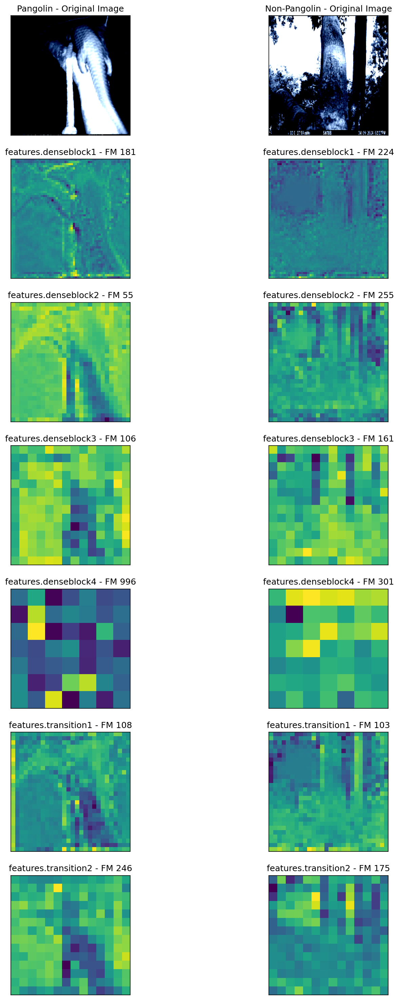

0.4099274277687073
Saving for this epoch 7
Epoch [8/15], Train Loss: 0.4337, Validation Loss: 0.3731
Training Per-Species Metrics:
Precision: 0.8023, Recall: 0.9906, F1: 0.8866
Species 1 - Accuracy: 0.8504, Precision: 0.9796, Recall: 0.6486, F1: 0.7805
Training Overall Accuracy: 0.8504, Precision: 0.8909, Recall: 0.8196, F1: 0.8335
Validation Overall Accuracy: 0.9024, Precision: 0.9286, Recall: 0.8824, F1: 0.8949
Epoch time 164.5494029521942





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2914162].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2914162].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2914162].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2914162].
Clippin

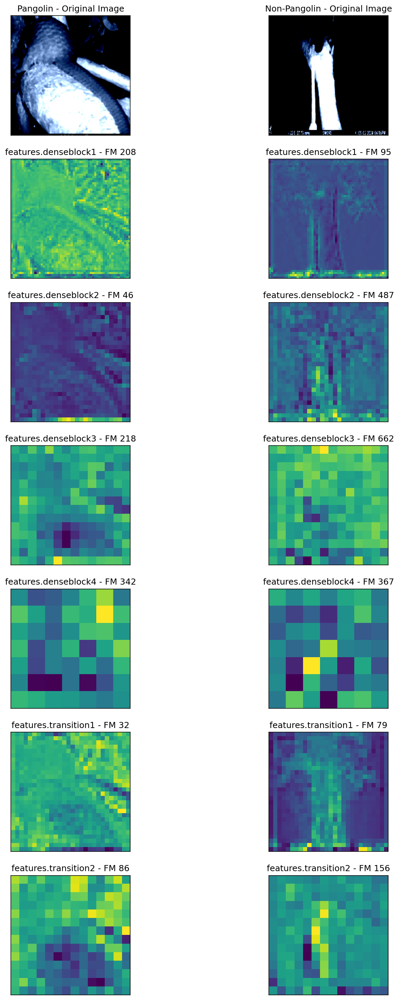

0.3730510175228119
Saving for this epoch 8
Epoch [9/15], Train Loss: 0.3978, Validation Loss: 0.3331
Training Per-Species Metrics:
Precision: 0.8519, Recall: 0.9718, F1: 0.9079
Species 1 - Accuracy: 0.8837, Precision: 0.9492, Recall: 0.7568, F1: 0.8421
Training Overall Accuracy: 0.8837, Precision: 0.9005, Recall: 0.8643, F1: 0.8750
Validation Overall Accuracy: 0.9268, Precision: 0.9444, Recall: 0.9118, F1: 0.9222
Epoch time 166.83622097969055





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

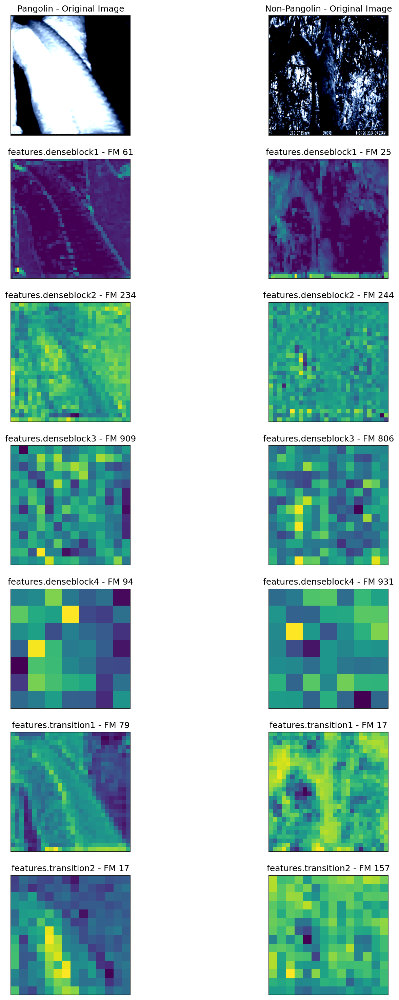

0.33312544226646423
Saving for this epoch 9
Epoch [10/15], Train Loss: 0.3636, Validation Loss: 0.2987
Training Per-Species Metrics:
Precision: 0.8612, Recall: 0.9906, F1: 0.9214
Species 1 - Accuracy: 0.9003, Precision: 0.9828, Recall: 0.7703, F1: 0.8636
Training Overall Accuracy: 0.9003, Precision: 0.9220, Recall: 0.8804, F1: 0.8925
Validation Overall Accuracy: 0.9268, Precision: 0.9287, Recall: 0.9203, F1: 0.9239
Epoch time 113.43389415740967





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

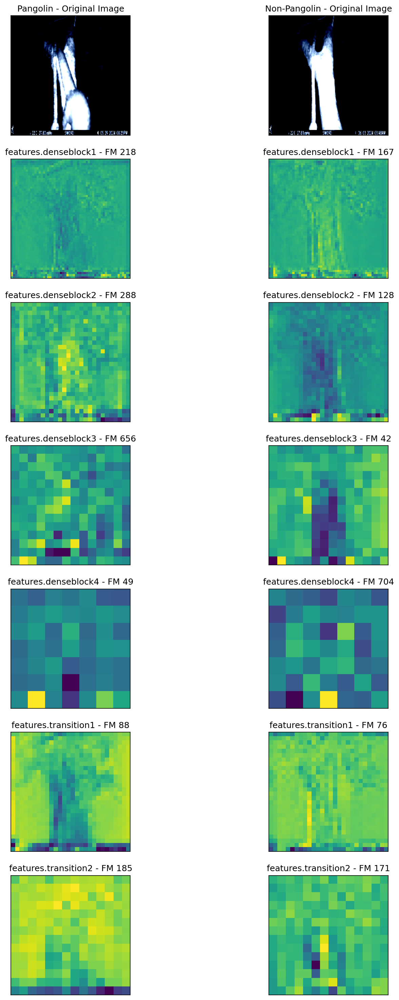

0.2987448573112488
Saving for this epoch 10
Epoch [11/15], Train Loss: 0.3574, Validation Loss: 0.2745
Training Per-Species Metrics:
Precision: 0.8675, Recall: 0.9531, F1: 0.9083
Species 1 - Accuracy: 0.8864, Precision: 0.9213, Recall: 0.7905, F1: 0.8509
Training Overall Accuracy: 0.8864, Precision: 0.8944, Recall: 0.8718, F1: 0.8796
Validation Overall Accuracy: 0.9512, Precision: 0.9498, Recall: 0.9498, F1: 0.9498
Epoch time 105.92193984985352





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

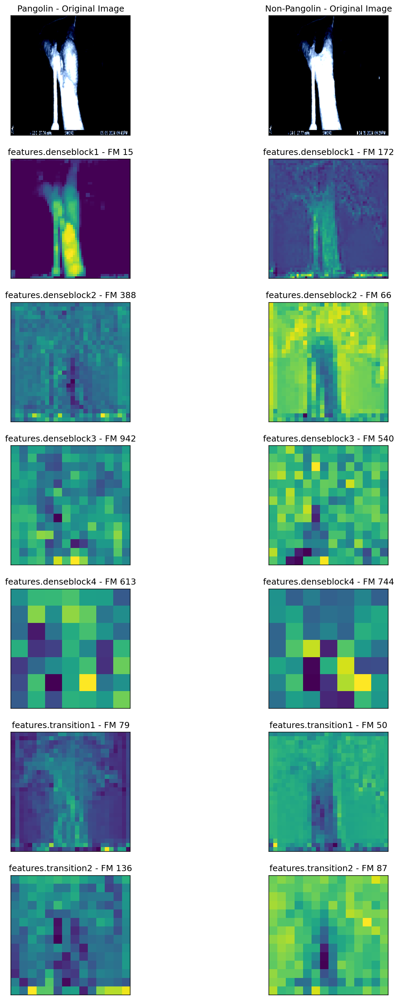

0.2744828313589096
Saving for this epoch 11
Epoch [12/15], Train Loss: 0.3230, Validation Loss: 0.2530
Training Per-Species Metrics:
Precision: 0.9123, Recall: 0.9765, F1: 0.9433
Species 1 - Accuracy: 0.9307, Precision: 0.9624, Recall: 0.8649, F1: 0.9110
Training Overall Accuracy: 0.9307, Precision: 0.9373, Recall: 0.9207, F1: 0.9272
Validation Overall Accuracy: 0.9512, Precision: 0.9498, Recall: 0.9498, F1: 0.9498
Epoch time 105.48406386375427





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.4308496].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.4308496].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.4308496].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.4308496].
Clippin

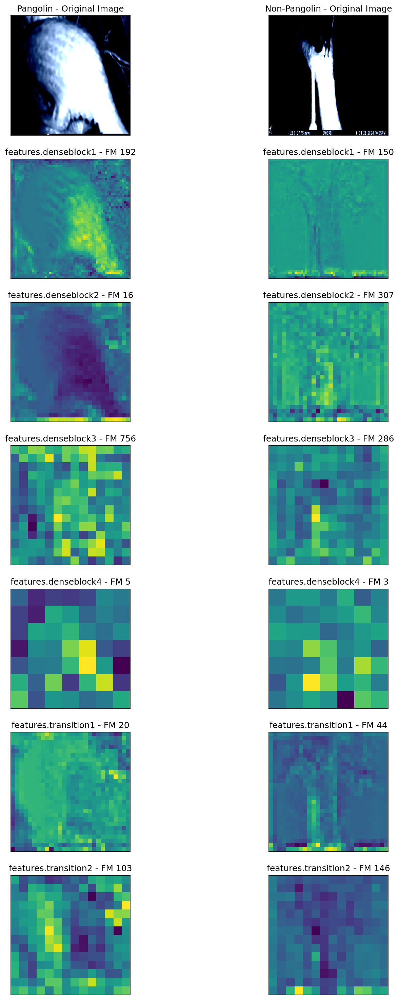

0.25300704687833786
Saving for this epoch 12
Epoch [13/15], Train Loss: 0.2932, Validation Loss: 0.2157
Training Per-Species Metrics:
Precision: 0.8846, Recall: 0.9718, F1: 0.9262
Species 1 - Accuracy: 0.9086, Precision: 0.9528, Recall: 0.8176, F1: 0.8800
Training Overall Accuracy: 0.9086, Precision: 0.9187, Recall: 0.8947, F1: 0.9031
Validation Overall Accuracy: 0.9756, Precision: 0.9800, Recall: 0.9706, F1: 0.9746
Epoch time 107.87673211097717





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

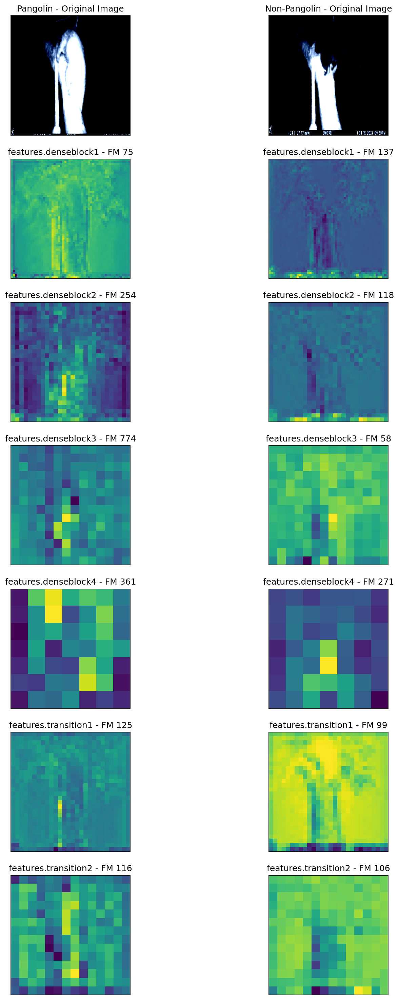

0.21565736830234528
Saving for this epoch 13
Epoch [14/15], Train Loss: 0.2642, Validation Loss: 0.1840
Training Per-Species Metrics:
Precision: 0.9009, Recall: 0.9812, F1: 0.9393
Species 1 - Accuracy: 0.9252, Precision: 0.9690, Recall: 0.8446, F1: 0.9025
Training Overall Accuracy: 0.9252, Precision: 0.9349, Recall: 0.9129, F1: 0.9209
Validation Overall Accuracy: 0.9756, Precision: 0.9800, Recall: 0.9706, F1: 0.9746
Epoch time 106.11066699028015





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

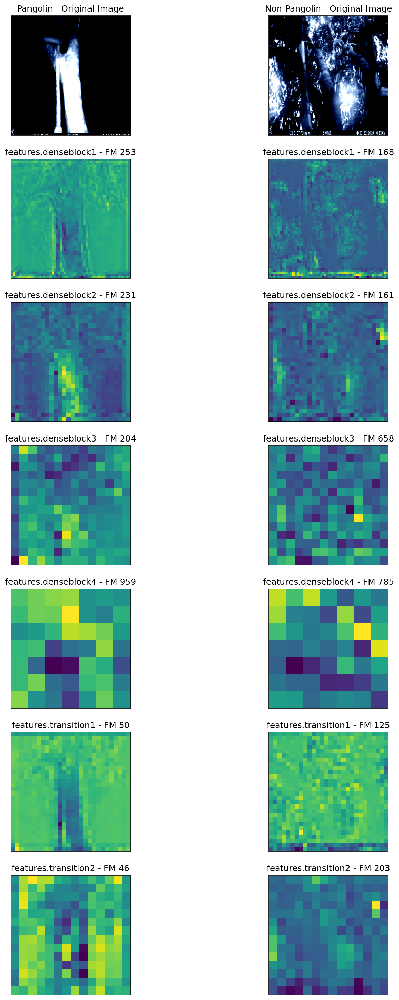

0.1839844137430191
Saving for this epoch 14
Epoch [15/15], Train Loss: 0.2650, Validation Loss: 0.1704
Training Per-Species Metrics:
Precision: 0.8841, Recall: 0.9671, F1: 0.9238
Species 1 - Accuracy: 0.9058, Precision: 0.9453, Recall: 0.8176, F1: 0.8768
Training Overall Accuracy: 0.9058, Precision: 0.9147, Recall: 0.8924, F1: 0.9003
Validation Overall Accuracy: 0.9512, Precision: 0.9498, Recall: 0.9498, F1: 0.9498
Epoch time 107.89964699745178



Test Metrics - Accuracy: 0.9505, Precision: 0.9737, Recall: 0.9024, F1: 0.9367, AUC: 0.9837
Test Per-Species Metrics:
Precision: 0.9365, Recall: 0.9833, F1: 0.9593
Species 1 - Accuracy: 0.9505, Precision: 0.9737, Recall: 0.9024, F1: 0.9367
Fold 3/5


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3088455].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3088455].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3088455].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3088455].
Clippin

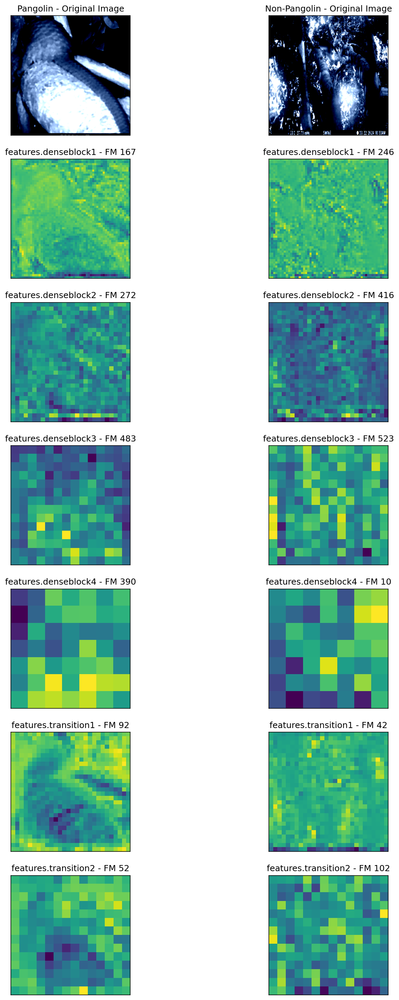

Saving for this epoch 0
Epoch [1/15], Train Loss: 0.6655, Validation Loss: 0.6556
Training Per-Species Metrics:
Precision: 0.6017, Recall: 1.0000, F1: 0.7513
Species 1 - Accuracy: 0.6094, Precision: 1.0000, Recall: 0.0473, F1: 0.0903
Training Overall Accuracy: 0.6094, Precision: 0.8008, Recall: 0.5236, F1: 0.4208
Validation Overall Accuracy: 0.5854, Precision: 0.2927, Recall: 0.5000, F1: 0.3692
Epoch time 116.05168294906616





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.7411594..1.9254032].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.7411594..1.9254032].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.7411594..1.9254032].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.7411594..1.9254032].
Cli

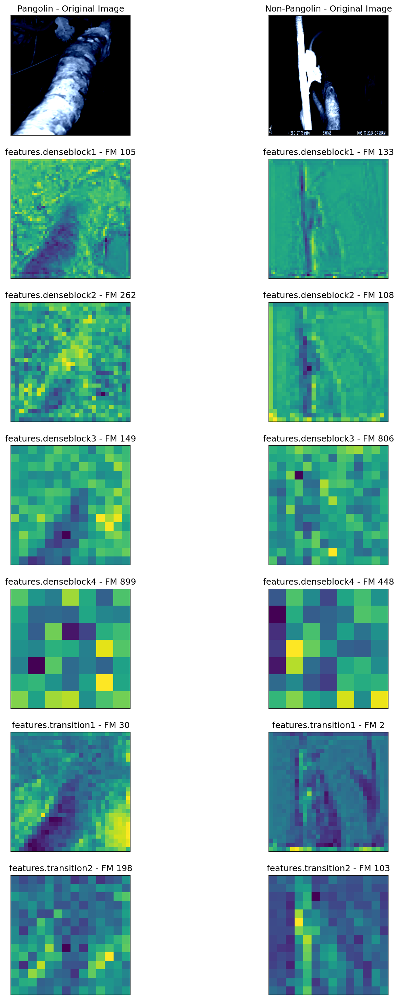

0.6555843651294708
Saving for this epoch 1
Epoch [2/15], Train Loss: 0.6364, Validation Loss: 0.6224
Training Per-Species Metrics:
Precision: 0.6174, Recall: 1.0000, F1: 0.7634
Species 1 - Accuracy: 0.6343, Precision: 1.0000, Recall: 0.1081, F1: 0.1951
Training Overall Accuracy: 0.6343, Precision: 0.8087, Recall: 0.5541, F1: 0.4793
Validation Overall Accuracy: 0.5854, Precision: 0.2927, Recall: 0.5000, F1: 0.3692
Epoch time 116.6970100402832





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3611329].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.169412].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3611329].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.169412].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3611329].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.169412].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.36113

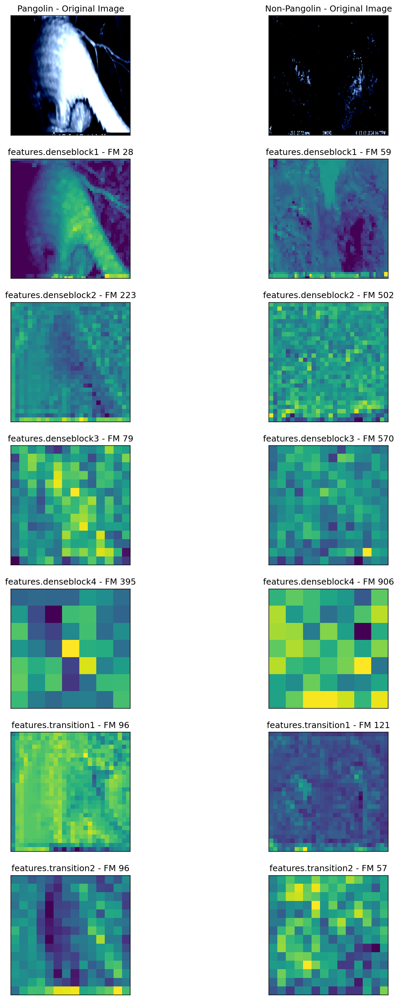

0.6223934292793274
Saving for this epoch 2
Epoch [3/15], Train Loss: 0.6059, Validation Loss: 0.5758
Training Per-Species Metrics:
Precision: 0.6228, Recall: 1.0000, F1: 0.7676
Species 1 - Accuracy: 0.6427, Precision: 1.0000, Recall: 0.1284, F1: 0.2275
Training Overall Accuracy: 0.6427, Precision: 0.8114, Recall: 0.5642, F1: 0.4976
Validation Overall Accuracy: 0.6341, Precision: 0.8077, Recall: 0.5588, F1: 0.4862
Epoch time 116.9721417427063





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

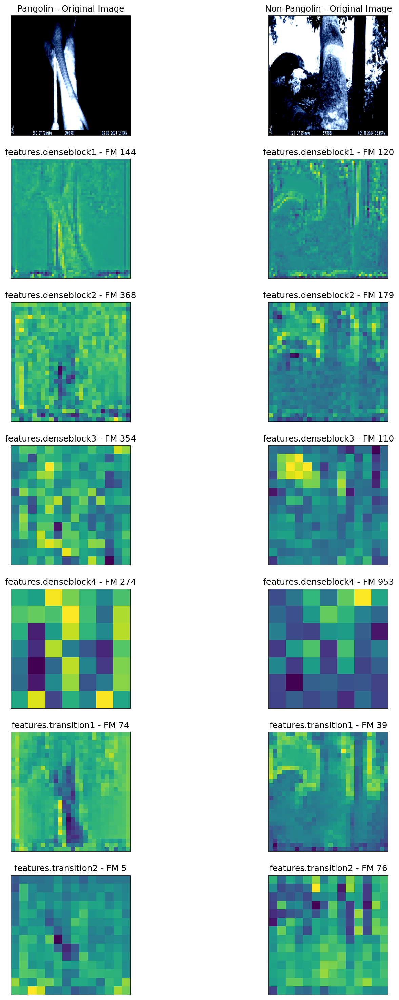

0.5758320391178131
Saving for this epoch 3
Epoch [4/15], Train Loss: 0.5719, Validation Loss: 0.5344
Training Per-Species Metrics:
Precision: 0.6416, Recall: 1.0000, F1: 0.7817
Species 1 - Accuracy: 0.6704, Precision: 1.0000, Recall: 0.1959, F1: 0.3277
Training Overall Accuracy: 0.6704, Precision: 0.8208, Recall: 0.5980, F1: 0.5547
Validation Overall Accuracy: 0.7317, Precision: 0.8429, Recall: 0.6765, F1: 0.6676
Epoch time 115.5760509967804





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

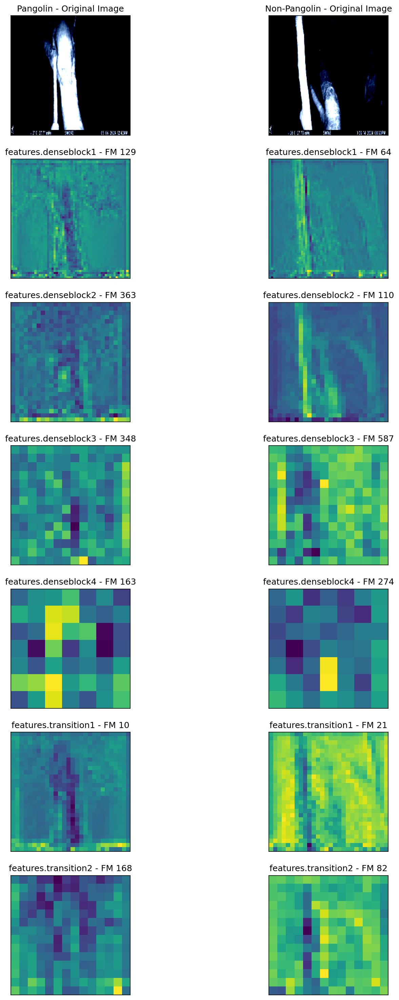

0.5344057977199554
Saving for this epoch 4
Epoch [5/15], Train Loss: 0.5361, Validation Loss: 0.5044
Training Per-Species Metrics:
Precision: 0.6783, Recall: 1.0000, F1: 0.8083
Species 1 - Accuracy: 0.7202, Precision: 1.0000, Recall: 0.3176, F1: 0.4821
Training Overall Accuracy: 0.7202, Precision: 0.8392, Recall: 0.6588, F1: 0.6452
Validation Overall Accuracy: 0.7561, Precision: 0.8529, Recall: 0.7059, F1: 0.7055
Epoch time 117.03068590164185





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.7411594..1.9254032].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.7411594..1.9254032].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.7411594..1.9254032].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.7411594..1.9254032].
Cli

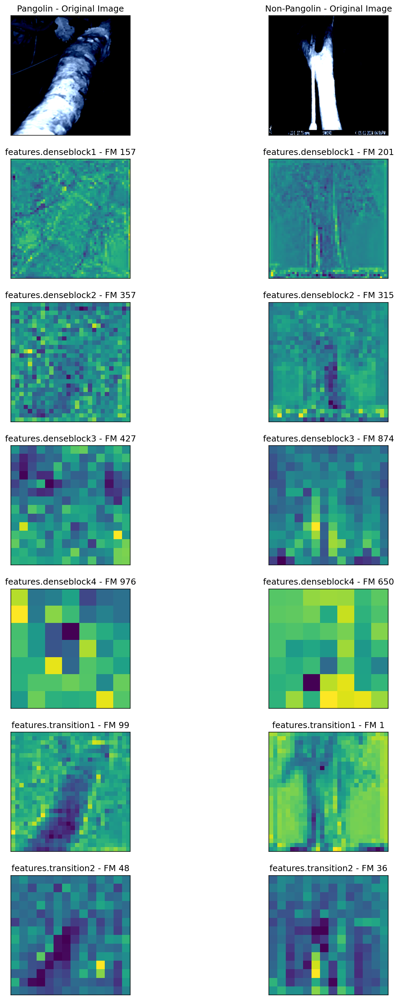

0.5043572932481766
Saving for this epoch 5
Epoch [6/15], Train Loss: 0.5072, Validation Loss: 0.4764
Training Per-Species Metrics:
Precision: 0.7370, Recall: 1.0000, F1: 0.8486
Species 1 - Accuracy: 0.7895, Precision: 1.0000, Recall: 0.4865, F1: 0.6545
Training Overall Accuracy: 0.7895, Precision: 0.8685, Recall: 0.7432, F1: 0.7516
Validation Overall Accuracy: 0.7805, Precision: 0.8636, Recall: 0.7353, F1: 0.7411
Epoch time 117.40210938453674





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

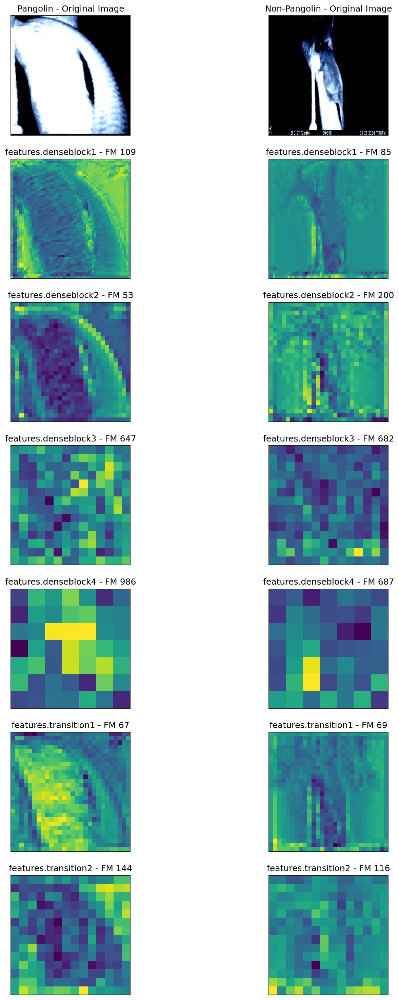

0.47638098895549774
Saving for this epoch 6
Epoch [7/15], Train Loss: 0.4619, Validation Loss: 0.4546
Training Per-Species Metrics:
Precision: 0.8154, Recall: 0.9953, F1: 0.8964
Species 1 - Accuracy: 0.8643, Precision: 0.9901, Recall: 0.6757, F1: 0.8032
Training Overall Accuracy: 0.8643, Precision: 0.9027, Recall: 0.8355, F1: 0.8498
Validation Overall Accuracy: 0.8537, Precision: 0.9000, Recall: 0.8235, F1: 0.8373
Epoch time 118.38217425346375





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

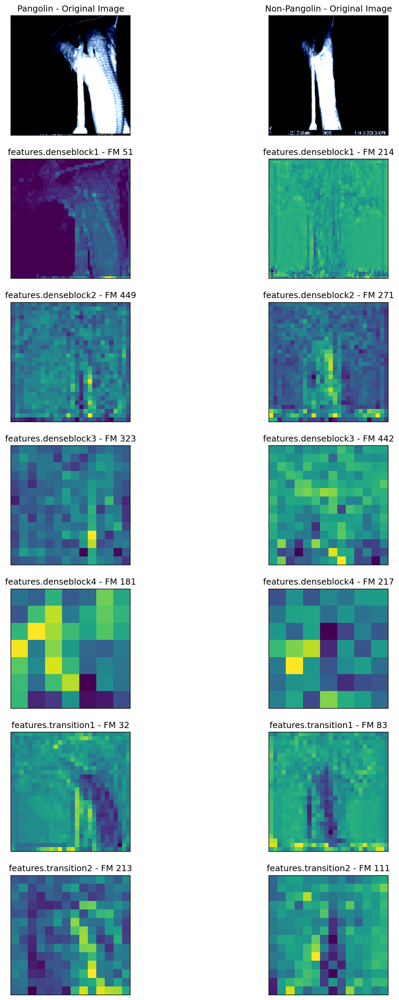

0.45456935465335846
Saving for this epoch 7
Epoch [8/15], Train Loss: 0.4324, Validation Loss: 0.4261
Training Per-Species Metrics:
Precision: 0.8745, Recall: 0.9812, F1: 0.9248
Species 1 - Accuracy: 0.9058, Precision: 0.9672, Recall: 0.7973, F1: 0.8741
Training Overall Accuracy: 0.9058, Precision: 0.9208, Recall: 0.8893, F1: 0.8994
Validation Overall Accuracy: 0.8537, Precision: 0.9000, Recall: 0.8235, F1: 0.8373
Epoch time 117.15480875968933





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

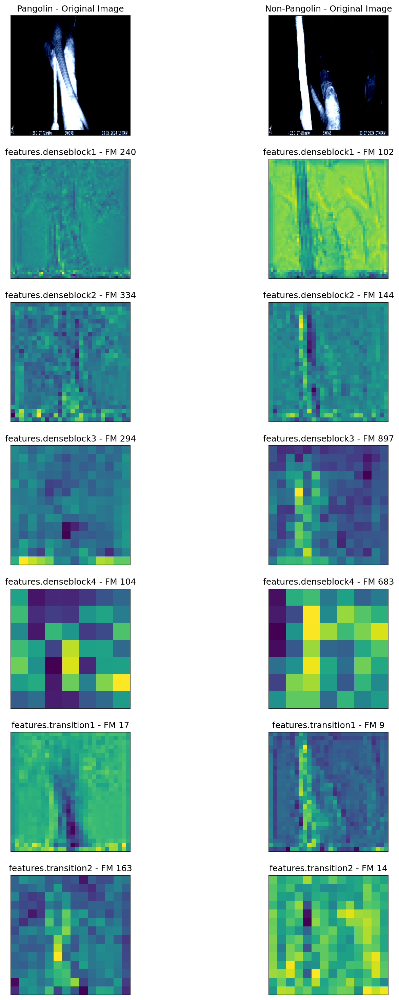

0.4261004328727722
Saving for this epoch 8
Epoch [9/15], Train Loss: 0.3930, Validation Loss: 0.4019
Training Per-Species Metrics:
Precision: 0.8836, Recall: 0.9624, F1: 0.9213
Species 1 - Accuracy: 0.9030, Precision: 0.9380, Recall: 0.8176, F1: 0.8736
Training Overall Accuracy: 0.9030, Precision: 0.9108, Recall: 0.8900, F1: 0.8975
Validation Overall Accuracy: 0.9024, Precision: 0.9286, Recall: 0.8824, F1: 0.8949
Epoch time 118.99229502677917





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8096584..2.5005665].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8096584..2.5005665].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8096584..2.5005665].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8096584..2.5005665].
Cli

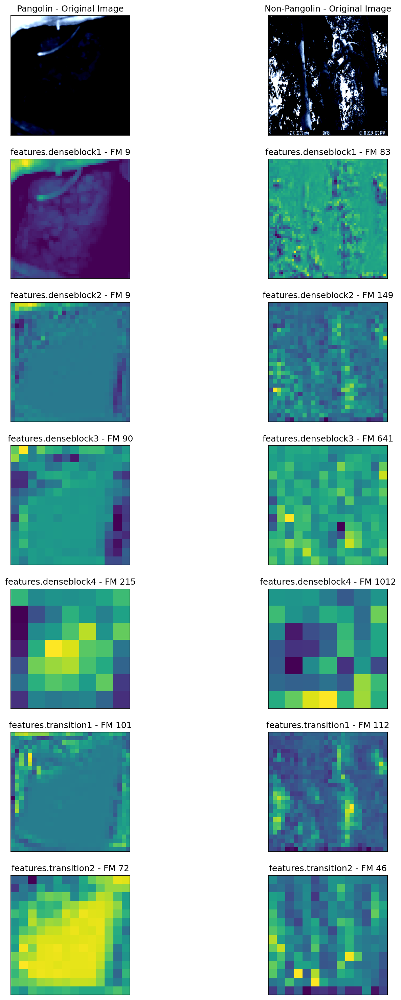

0.40191593766212463
Saving for this epoch 9
Epoch [10/15], Train Loss: 0.3479, Validation Loss: 0.3800
Training Per-Species Metrics:
Precision: 0.9123, Recall: 0.9765, F1: 0.9433
Species 1 - Accuracy: 0.9307, Precision: 0.9624, Recall: 0.8649, F1: 0.9110
Training Overall Accuracy: 0.9307, Precision: 0.9373, Recall: 0.9207, F1: 0.9272
Validation Overall Accuracy: 0.9024, Precision: 0.9286, Recall: 0.8824, F1: 0.8949
Epoch time 118.15221691131592





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

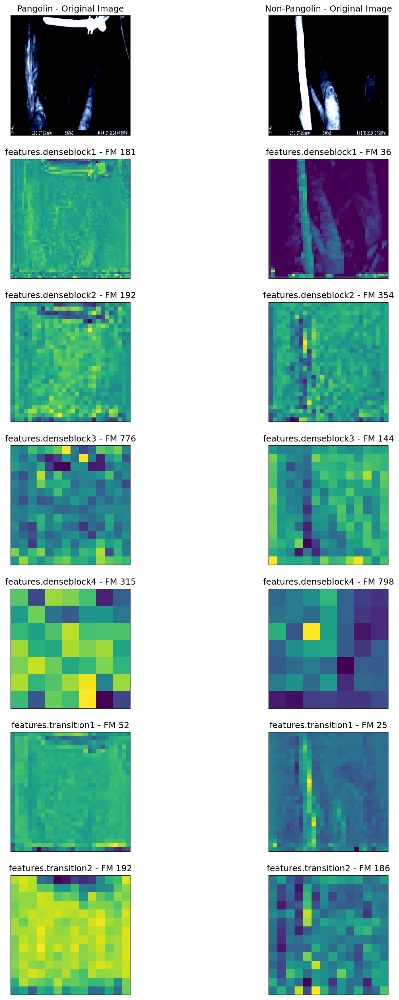

0.3800284266471863
Saving for this epoch 10
Epoch [11/15], Train Loss: 0.3436, Validation Loss: 0.3610
Training Per-Species Metrics:
Precision: 0.8870, Recall: 0.9577, F1: 0.9210
Species 1 - Accuracy: 0.9030, Precision: 0.9313, Recall: 0.8243, F1: 0.8746
Training Overall Accuracy: 0.9030, Precision: 0.9091, Recall: 0.8910, F1: 0.8978
Validation Overall Accuracy: 0.9024, Precision: 0.9286, Recall: 0.8824, F1: 0.8949
Epoch time 116.61184477806091





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

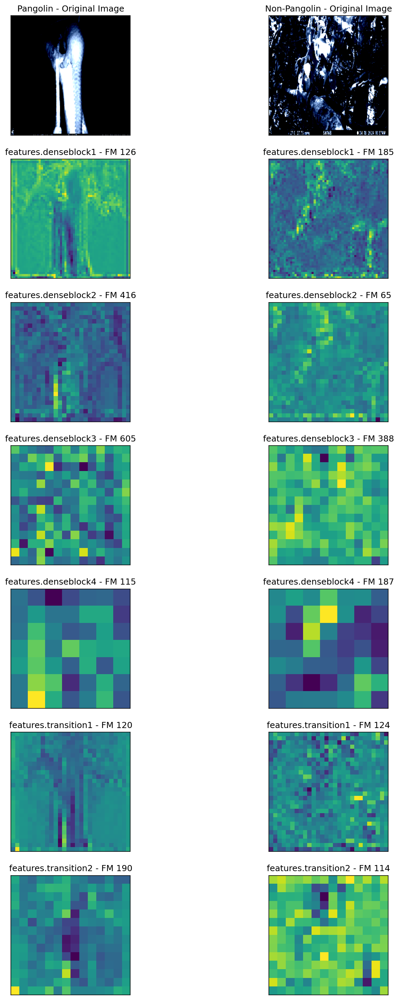

0.3609664589166641
Saving for this epoch 11
Epoch [12/15], Train Loss: 0.3095, Validation Loss: 0.3347
Training Per-Species Metrics:
Precision: 0.9039, Recall: 0.9718, F1: 0.9367
Species 1 - Accuracy: 0.9224, Precision: 0.9545, Recall: 0.8514, F1: 0.9000
Training Overall Accuracy: 0.9224, Precision: 0.9292, Recall: 0.9116, F1: 0.9183
Validation Overall Accuracy: 0.9024, Precision: 0.9286, Recall: 0.8824, F1: 0.8949
Epoch time 117.18096709251404





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

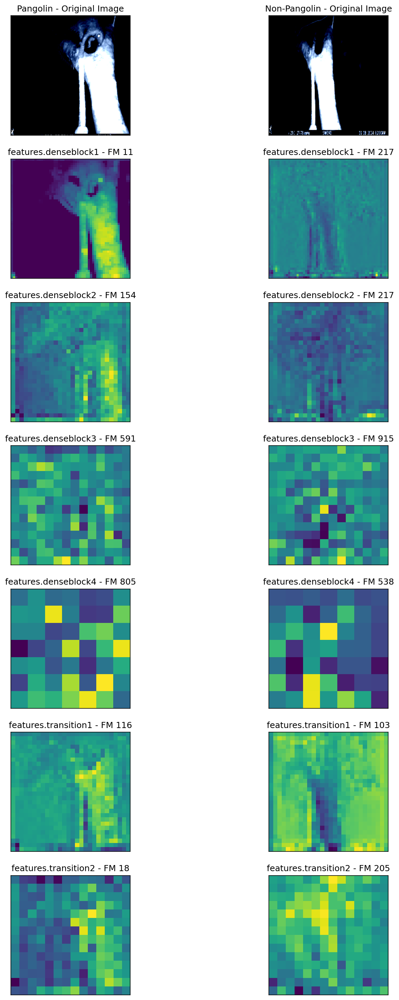

0.33472780883312225
Saving for this epoch 12
Epoch [13/15], Train Loss: 0.2872, Validation Loss: 0.3157
Training Per-Species Metrics:
Precision: 0.8974, Recall: 0.9859, F1: 0.9396
Species 1 - Accuracy: 0.9252, Precision: 0.9764, Recall: 0.8378, F1: 0.9018
Training Overall Accuracy: 0.9252, Precision: 0.9369, Recall: 0.9119, F1: 0.9207
Validation Overall Accuracy: 0.9024, Precision: 0.9286, Recall: 0.8824, F1: 0.8949
Epoch time 117.41126704216003





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.169412].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.169412].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.169412].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input 

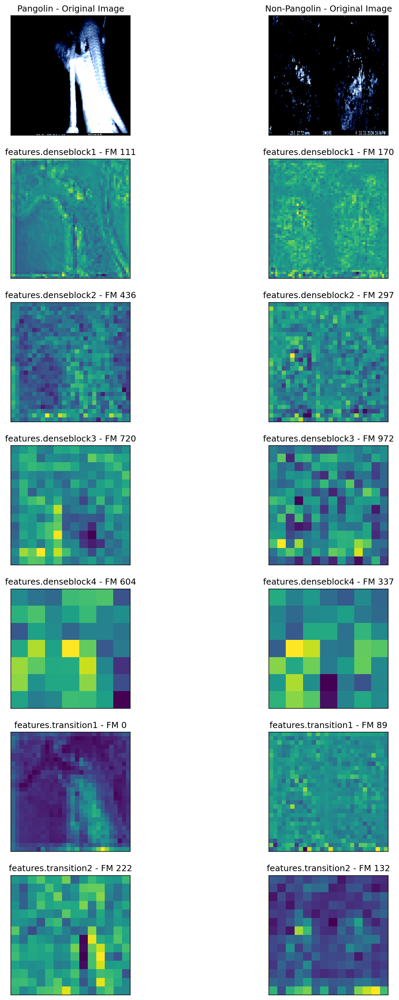

0.31573154032230377
Saving for this epoch 13
Epoch [14/15], Train Loss: 0.2869, Validation Loss: 0.3017
Training Per-Species Metrics:
Precision: 0.8771, Recall: 0.9718, F1: 0.9220
Species 1 - Accuracy: 0.9030, Precision: 0.9520, Recall: 0.8041, F1: 0.8718
Training Overall Accuracy: 0.9030, Precision: 0.9146, Recall: 0.8879, F1: 0.8969
Validation Overall Accuracy: 0.9024, Precision: 0.9286, Recall: 0.8824, F1: 0.8949
Epoch time 116.72630620002747





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.0822659].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.0822659].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.0822659].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.0822659].
Clippin

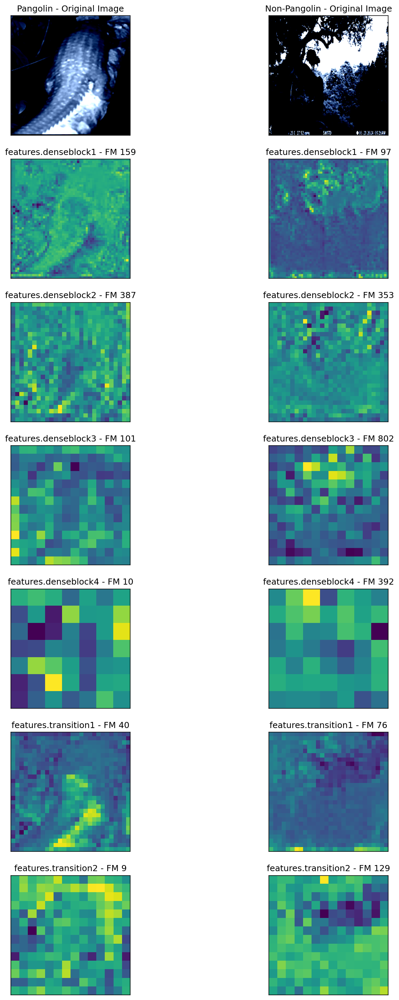

0.3016943782567978
Saving for this epoch 14
Epoch [15/15], Train Loss: 0.2402, Validation Loss: 0.2975
Training Per-Species Metrics:
Precision: 0.9367, Recall: 0.9718, F1: 0.9539
Species 1 - Accuracy: 0.9446, Precision: 0.9571, Recall: 0.9054, F1: 0.9306
Training Overall Accuracy: 0.9446, Precision: 0.9469, Recall: 0.9386, F1: 0.9422
Validation Overall Accuracy: 0.9512, Precision: 0.9615, Recall: 0.9412, F1: 0.9487
Epoch time 116.9075379371643



Test Metrics - Accuracy: 0.9703, Precision: 0.9524, Recall: 0.9756, F1: 0.9639, AUC: 0.9943
Test Per-Species Metrics:
Precision: 0.9831, Recall: 0.9667, F1: 0.9748
Species 1 - Accuracy: 0.9703, Precision: 0.9524, Recall: 0.9756, F1: 0.9639
Fold 4/5


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

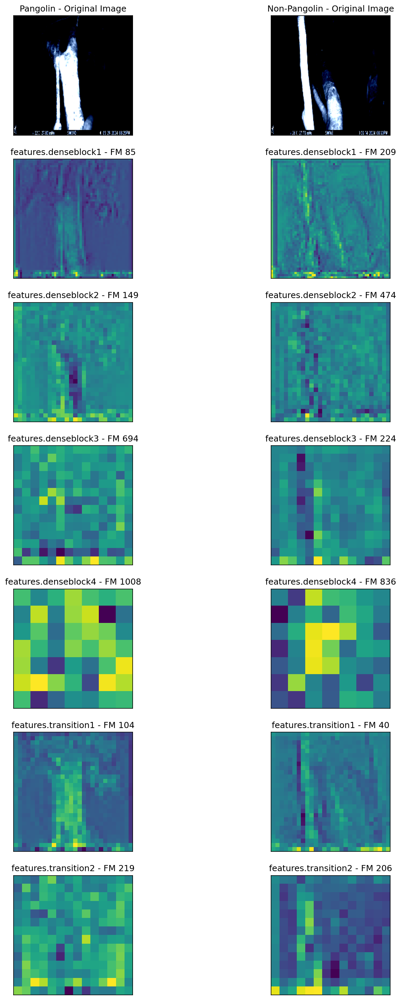

Saving for this epoch 0
Epoch [1/15], Train Loss: 0.6805, Validation Loss: 0.6815
Training Per-Species Metrics:
Precision: 0.7171, Recall: 0.6869, F1: 0.7017
Species 1 - Accuracy: 0.6547, Precision: 0.5732, Recall: 0.6081, F1: 0.5902
Training Overall Accuracy: 0.6547, Precision: 0.6452, Recall: 0.6475, F1: 0.6459
Validation Overall Accuracy: 0.5854, Precision: 0.2927, Recall: 0.5000, F1: 0.3692
Epoch time 117.90194296836853





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.169412].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.169412].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.169412].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input 

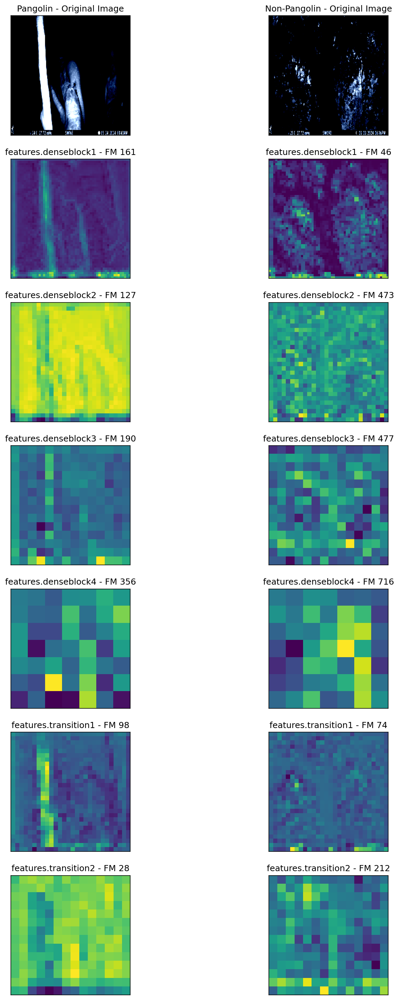

0.6814680695533752
Saving for this epoch 1
Epoch [2/15], Train Loss: 0.6373, Validation Loss: 0.6355
Training Per-Species Metrics:
Precision: 0.6203, Recall: 1.0000, F1: 0.7657
Species 1 - Accuracy: 0.6381, Precision: 1.0000, Recall: 0.1149, F1: 0.2061
Training Overall Accuracy: 0.6381, Precision: 0.8101, Recall: 0.5574, F1: 0.4859
Validation Overall Accuracy: 0.5854, Precision: 0.2927, Recall: 0.5000, F1: 0.3692
Epoch time 119.21391487121582





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

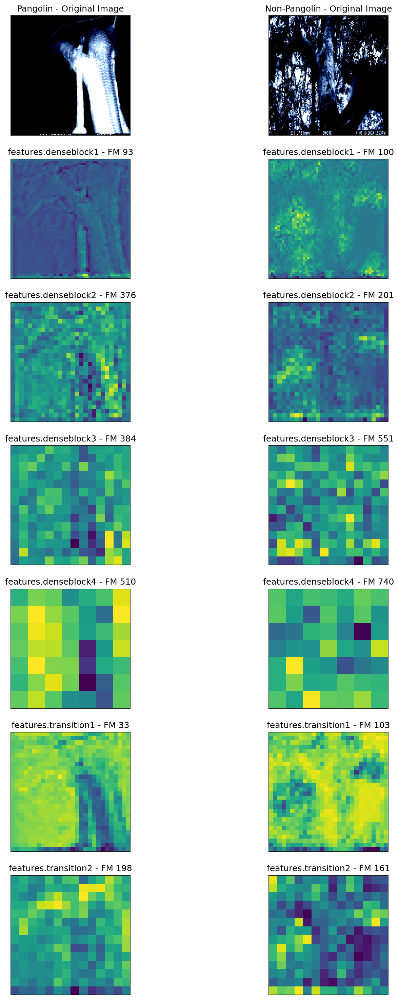

0.6354751884937286
Saving for this epoch 2
Epoch [3/15], Train Loss: 0.6086, Validation Loss: 0.5806
Training Per-Species Metrics:
Precision: 0.6185, Recall: 1.0000, F1: 0.7643
Species 1 - Accuracy: 0.6354, Precision: 1.0000, Recall: 0.1081, F1: 0.1951
Training Overall Accuracy: 0.6354, Precision: 0.8092, Recall: 0.5541, F1: 0.4797
Validation Overall Accuracy: 0.5854, Precision: 0.2927, Recall: 0.5000, F1: 0.3692
Epoch time 118.50135397911072





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

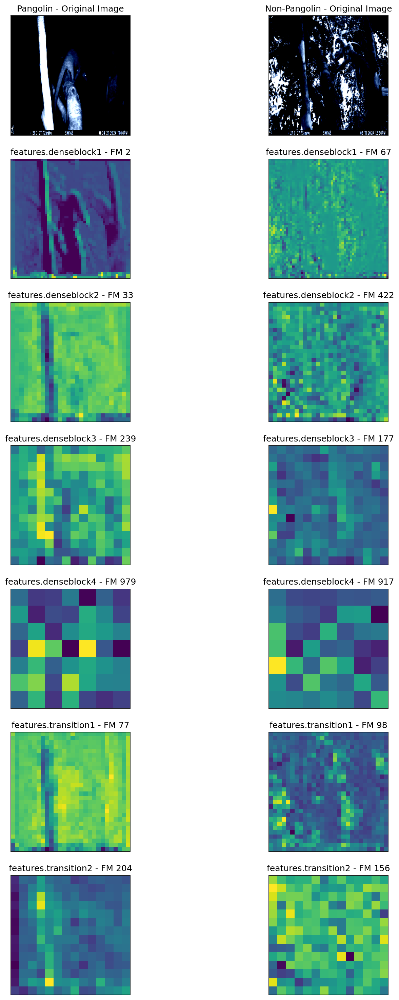

0.5806308090686798
Saving for this epoch 3
Epoch [4/15], Train Loss: 0.5764, Validation Loss: 0.5353
Training Per-Species Metrics:
Precision: 0.6294, Recall: 1.0000, F1: 0.7726
Species 1 - Accuracy: 0.6519, Precision: 1.0000, Recall: 0.1486, F1: 0.2588
Training Overall Accuracy: 0.6519, Precision: 0.8147, Recall: 0.5743, F1: 0.5157
Validation Overall Accuracy: 0.6098, Precision: 0.8000, Recall: 0.5294, F1: 0.4306
Epoch time 118.46134400367737





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.843908..2.465708].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.843908..2.465708].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.843908..2.465708].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.843908..2.465708].
Clipping in

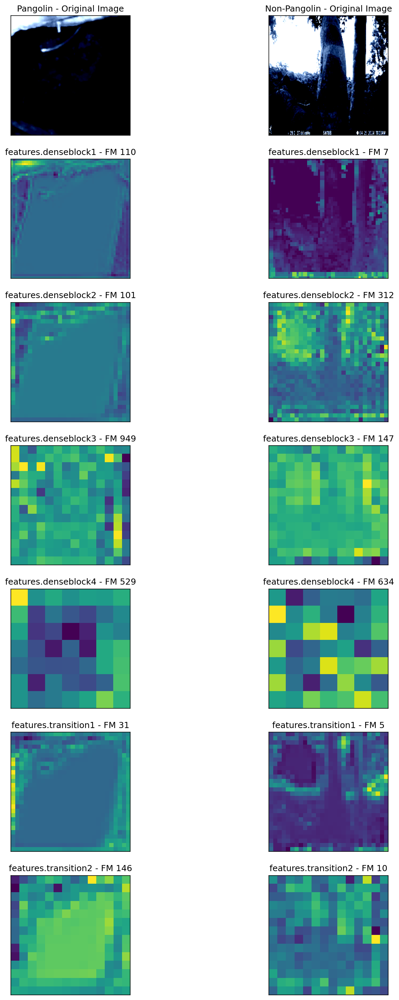

0.5352656096220016
Saving for this epoch 4
Epoch [5/15], Train Loss: 0.5402, Validation Loss: 0.4872
Training Per-Species Metrics:
Precision: 0.6881, Recall: 1.0000, F1: 0.8152
Species 1 - Accuracy: 0.7320, Precision: 1.0000, Recall: 0.3446, F1: 0.5126
Training Overall Accuracy: 0.7320, Precision: 0.8441, Recall: 0.6723, F1: 0.6639
Validation Overall Accuracy: 0.8293, Precision: 0.8871, Recall: 0.7941, F1: 0.8067
Epoch time 117.71404600143433





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3785625].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3785625].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3785625].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3785625].
Clippin

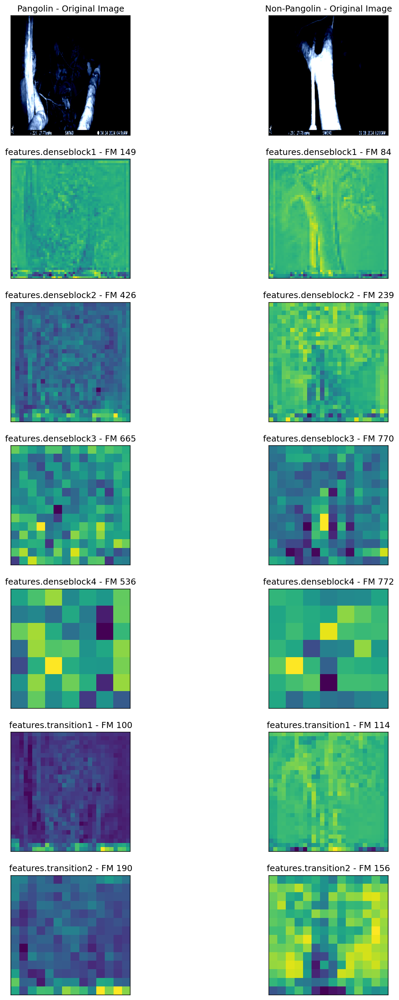

0.4871911555528641
Saving for this epoch 5
Epoch [6/15], Train Loss: 0.5109, Validation Loss: 0.4448
Training Per-Species Metrics:
Precision: 0.7844, Recall: 0.9860, F1: 0.8737
Species 1 - Accuracy: 0.8315, Precision: 0.9677, Recall: 0.6081, F1: 0.7469
Training Overall Accuracy: 0.8315, Precision: 0.8761, Recall: 0.7970, F1: 0.8103
Validation Overall Accuracy: 0.8780, Precision: 0.9138, Recall: 0.8529, F1: 0.8666
Epoch time 119.68813109397888





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3088455].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3088455].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3088455].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3088455].
Clippin

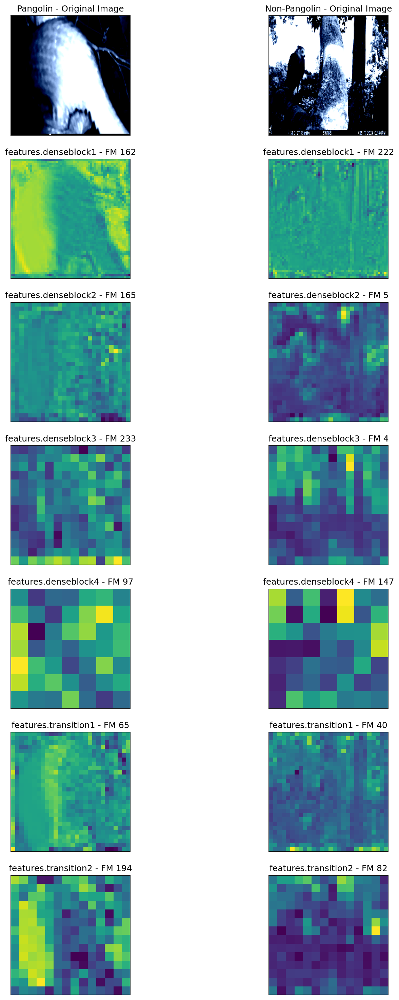

0.4447980970144272
Saving for this epoch 6
Epoch [7/15], Train Loss: 0.4674, Validation Loss: 0.3952
Training Per-Species Metrics:
Precision: 0.8474, Recall: 0.9860, F1: 0.9114
Species 1 - Accuracy: 0.8867, Precision: 0.9735, Recall: 0.7432, F1: 0.8429
Training Overall Accuracy: 0.8867, Precision: 0.9104, Recall: 0.8646, F1: 0.8772
Validation Overall Accuracy: 0.9512, Precision: 0.9615, Recall: 0.9412, F1: 0.9487
Epoch time 118.83566617965698





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8096584..2.5005665].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8096584..2.5005665].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8096584..2.5005665].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8096584..2.5005665].
Cli

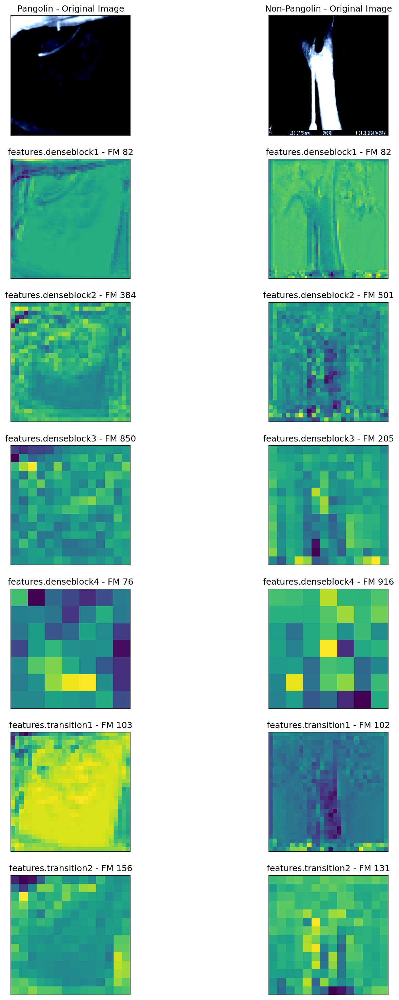

0.39521174132823944
Saving for this epoch 7
Epoch [8/15], Train Loss: 0.4353, Validation Loss: 0.3485
Training Per-Species Metrics:
Precision: 0.8636, Recall: 0.9766, F1: 0.9167
Species 1 - Accuracy: 0.8950, Precision: 0.9583, Recall: 0.7770, F1: 0.8582
Training Overall Accuracy: 0.8950, Precision: 0.9110, Recall: 0.8768, F1: 0.8874
Validation Overall Accuracy: 0.9512, Precision: 0.9615, Recall: 0.9412, F1: 0.9487
Epoch time 116.67203307151794





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

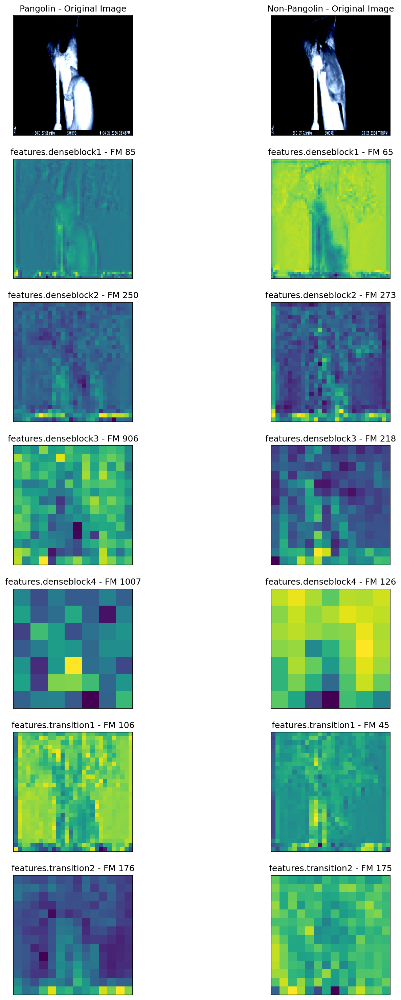

0.34853681921958923
Saving for this epoch 8
Epoch [9/15], Train Loss: 0.3862, Validation Loss: 0.3139
Training Per-Species Metrics:
Precision: 0.9004, Recall: 0.9720, F1: 0.9348
Species 1 - Accuracy: 0.9199, Precision: 0.9542, Recall: 0.8446, F1: 0.8961
Training Overall Accuracy: 0.9199, Precision: 0.9273, Recall: 0.9083, F1: 0.9154
Validation Overall Accuracy: 1.0000, Precision: 1.0000, Recall: 1.0000, F1: 1.0000
Epoch time 117.9423439502716





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

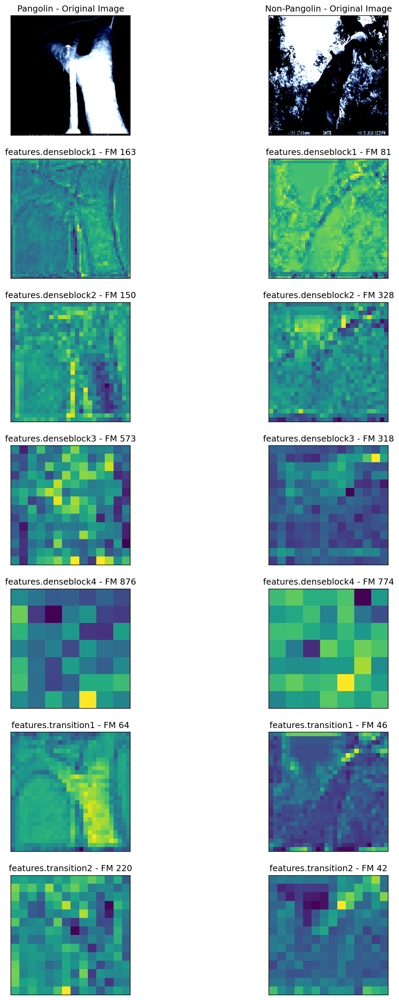

0.31390276551246643
Saving for this epoch 9
Epoch [10/15], Train Loss: 0.3649, Validation Loss: 0.2817
Training Per-Species Metrics:
Precision: 0.8943, Recall: 0.9486, F1: 0.9206
Species 1 - Accuracy: 0.9033, Precision: 0.9185, Recall: 0.8378, F1: 0.8763
Training Overall Accuracy: 0.9033, Precision: 0.9064, Recall: 0.8932, F1: 0.8985
Validation Overall Accuracy: 1.0000, Precision: 1.0000, Recall: 1.0000, F1: 1.0000
Epoch time 115.54817295074463





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

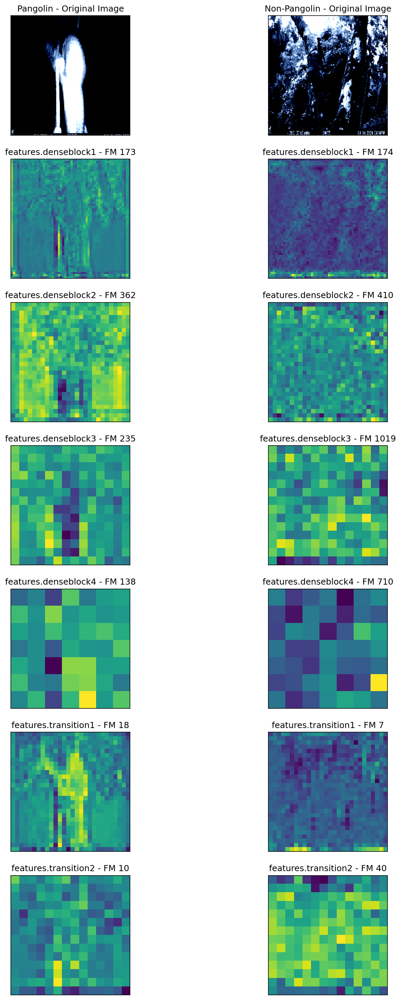

0.2816537618637085
Saving for this epoch 10
Epoch [11/15], Train Loss: 0.3320, Validation Loss: 0.2483
Training Per-Species Metrics:
Precision: 0.8982, Recall: 0.9486, F1: 0.9227
Species 1 - Accuracy: 0.9061, Precision: 0.9191, Recall: 0.8446, F1: 0.8803
Training Overall Accuracy: 0.9061, Precision: 0.9087, Recall: 0.8966, F1: 0.9015
Validation Overall Accuracy: 1.0000, Precision: 1.0000, Recall: 1.0000, F1: 1.0000
Epoch time 120.6661388874054





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8096584..2.5005665].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8096584..2.5005665].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8096584..2.5005665].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8096584..2.5005665].
Cli

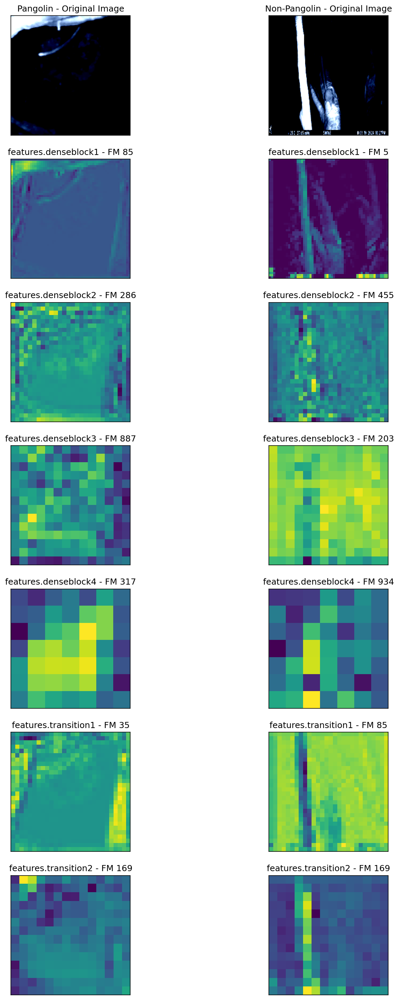

0.24825749546289444
Saving for this epoch 11
Epoch [12/15], Train Loss: 0.2989, Validation Loss: 0.2123
Training Per-Species Metrics:
Precision: 0.9200, Recall: 0.9673, F1: 0.9431
Species 1 - Accuracy: 0.9309, Precision: 0.9489, Recall: 0.8784, F1: 0.9123
Training Overall Accuracy: 0.9309, Precision: 0.9345, Recall: 0.9228, F1: 0.9277
Validation Overall Accuracy: 1.0000, Precision: 1.0000, Recall: 1.0000, F1: 1.0000
Epoch time 118.32358884811401





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.7925336..1.3153814].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.7925336..1.3153814].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.7925336..1.3153814].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.7925336..1.3153814].
Cli

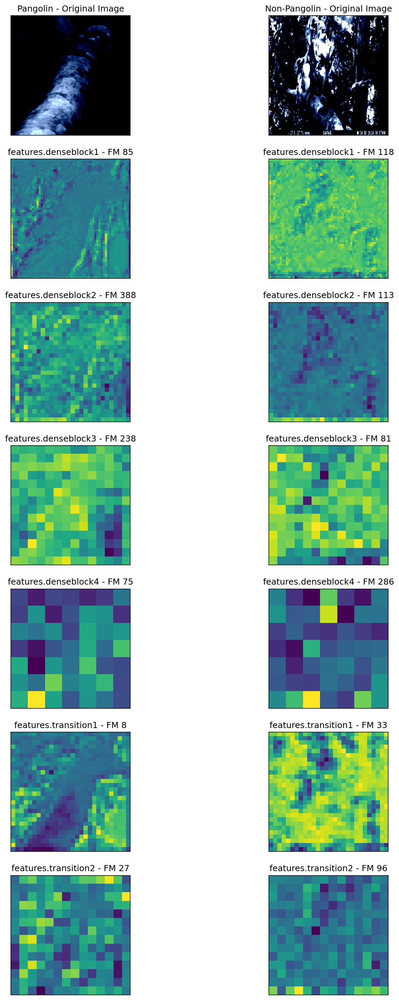

0.21234840154647827
Saving for this epoch 12
Epoch [13/15], Train Loss: 0.2701, Validation Loss: 0.1797
Training Per-Species Metrics:
Precision: 0.9211, Recall: 0.9813, F1: 0.9502
Species 1 - Accuracy: 0.9392, Precision: 0.9701, Recall: 0.8784, F1: 0.9220
Training Overall Accuracy: 0.9392, Precision: 0.9456, Recall: 0.9298, F1: 0.9361
Validation Overall Accuracy: 1.0000, Precision: 1.0000, Recall: 1.0000, F1: 1.0000
Epoch time 116.78441071510315





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

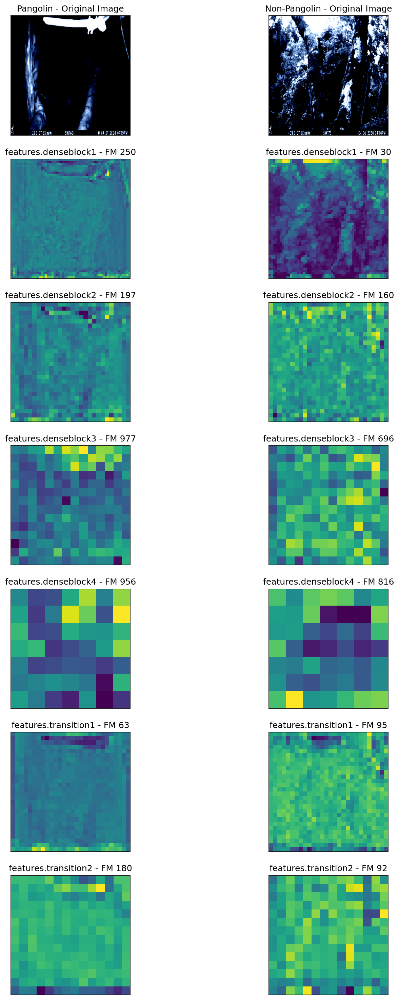

0.17965289950370789
Saving for this epoch 13
Epoch [14/15], Train Loss: 0.2589, Validation Loss: 0.1633
Training Per-Species Metrics:
Precision: 0.9127, Recall: 0.9766, F1: 0.9436
Species 1 - Accuracy: 0.9309, Precision: 0.9624, Recall: 0.8649, F1: 0.9110
Training Overall Accuracy: 0.9309, Precision: 0.9375, Recall: 0.9208, F1: 0.9273
Validation Overall Accuracy: 1.0000, Precision: 1.0000, Recall: 1.0000, F1: 1.0000
Epoch time 115.13017225265503





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

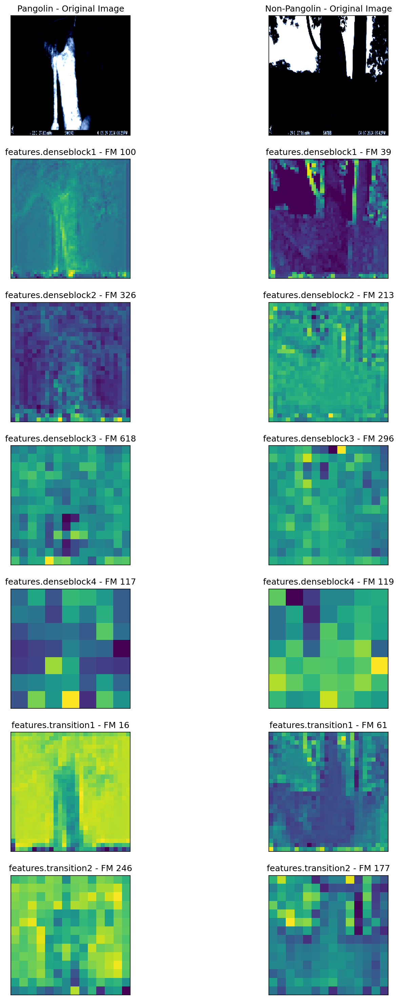

0.1633046418428421
Saving for this epoch 14
Epoch [15/15], Train Loss: 0.2409, Validation Loss: 0.1458
Training Per-Species Metrics:
Precision: 0.9244, Recall: 0.9720, F1: 0.9476
Species 1 - Accuracy: 0.9365, Precision: 0.9562, Recall: 0.8851, F1: 0.9193
Training Overall Accuracy: 0.9365, Precision: 0.9403, Recall: 0.9285, F1: 0.9335
Validation Overall Accuracy: 1.0000, Precision: 1.0000, Recall: 1.0000, F1: 1.0000
Epoch time 115.67490911483765



Test Metrics - Accuracy: 0.8900, Precision: 0.9167, Recall: 0.8049, F1: 0.8571, AUC: 0.9806
Test Per-Species Metrics:
Precision: 0.8750, Recall: 0.9492, F1: 0.9106
Species 1 - Accuracy: 0.8900, Precision: 0.9167, Recall: 0.8049, F1: 0.8571
Fold 5/5


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9295317..1.907974].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9295317..1.907974].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9295317..1.907974].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9295317..1.907974].
Clippin

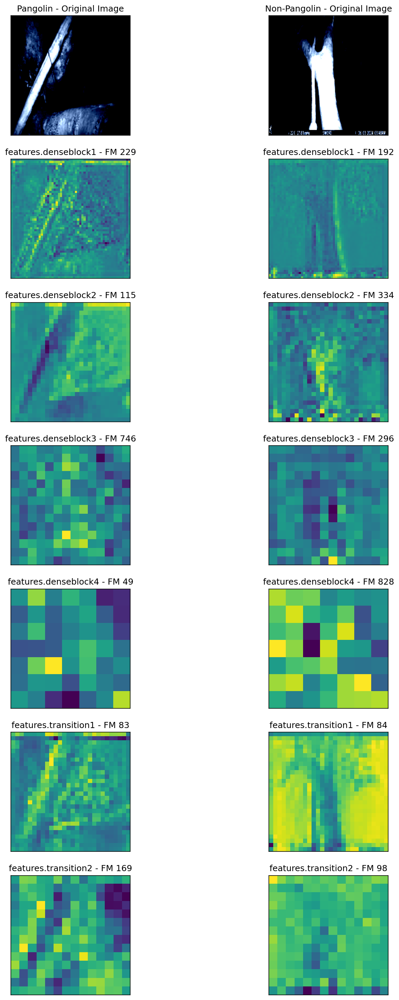

Saving for this epoch 0
Epoch [1/15], Train Loss: 0.6957, Validation Loss: 0.6981
Training Per-Species Metrics:
Precision: 0.6210, Recall: 0.3598, F1: 0.4556
Species 1 - Accuracy: 0.4917, Precision: 0.4244, Recall: 0.6824, F1: 0.5233
Training Overall Accuracy: 0.4917, Precision: 0.5227, Recall: 0.5211, F1: 0.4895
Validation Overall Accuracy: 0.4634, Precision: 0.4986, Recall: 0.4988, F1: 0.4553
Epoch time 112.14650106430054





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

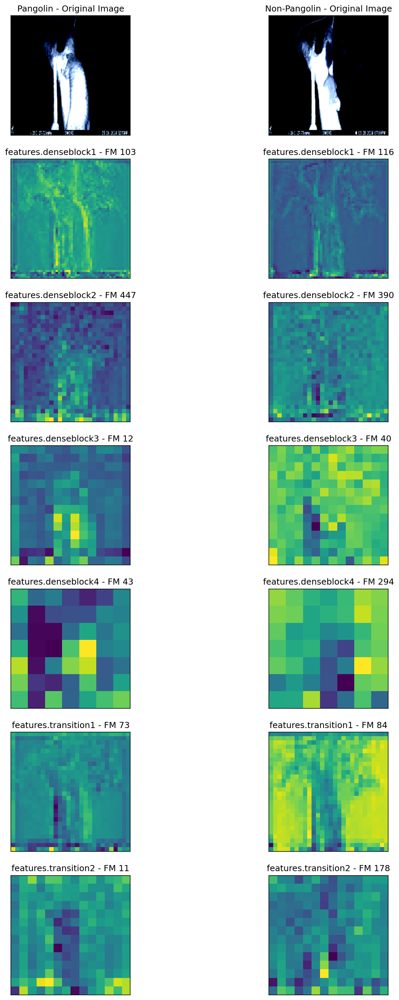

0.6981279253959656
Saving for this epoch 1
Epoch [2/15], Train Loss: 0.6528, Validation Loss: 0.6519
Training Per-Species Metrics:
Precision: 0.6294, Recall: 1.0000, F1: 0.7726
Species 1 - Accuracy: 0.6519, Precision: 1.0000, Recall: 0.1486, F1: 0.2588
Training Overall Accuracy: 0.6519, Precision: 0.8147, Recall: 0.5743, F1: 0.5157
Validation Overall Accuracy: 0.6098, Precision: 0.8000, Recall: 0.5294, F1: 0.4306
Epoch time 113.59724116325378





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

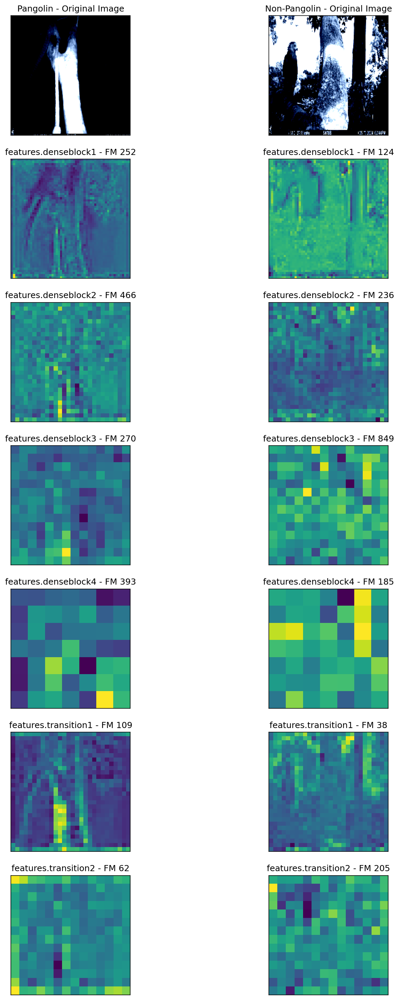

0.6518740952014923
Saving for this epoch 2
Epoch [3/15], Train Loss: 0.6161, Validation Loss: 0.5934
Training Per-Species Metrics:
Precision: 0.6313, Recall: 1.0000, F1: 0.7740
Species 1 - Accuracy: 0.6547, Precision: 1.0000, Recall: 0.1554, F1: 0.2690
Training Overall Accuracy: 0.6547, Precision: 0.8156, Recall: 0.5777, F1: 0.5215
Validation Overall Accuracy: 0.6585, Precision: 0.8158, Recall: 0.5882, F1: 0.5371
Epoch time 114.09847402572632





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

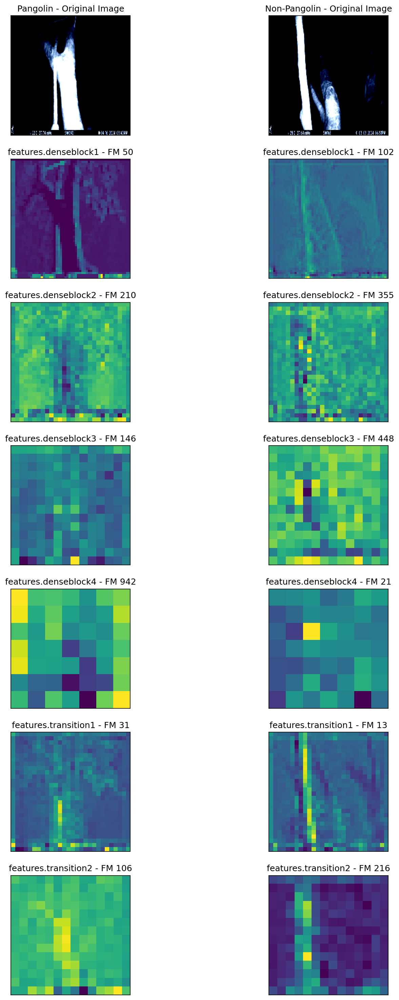

0.5934167504310608
Saving for this epoch 3
Epoch [4/15], Train Loss: 0.5893, Validation Loss: 0.5367
Training Per-Species Metrics:
Precision: 0.6369, Recall: 1.0000, F1: 0.7782
Species 1 - Accuracy: 0.6630, Precision: 1.0000, Recall: 0.1757, F1: 0.2989
Training Overall Accuracy: 0.6630, Precision: 0.8185, Recall: 0.5878, F1: 0.5385
Validation Overall Accuracy: 0.7317, Precision: 0.8429, Recall: 0.6765, F1: 0.6676
Epoch time 116.02277207374573





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

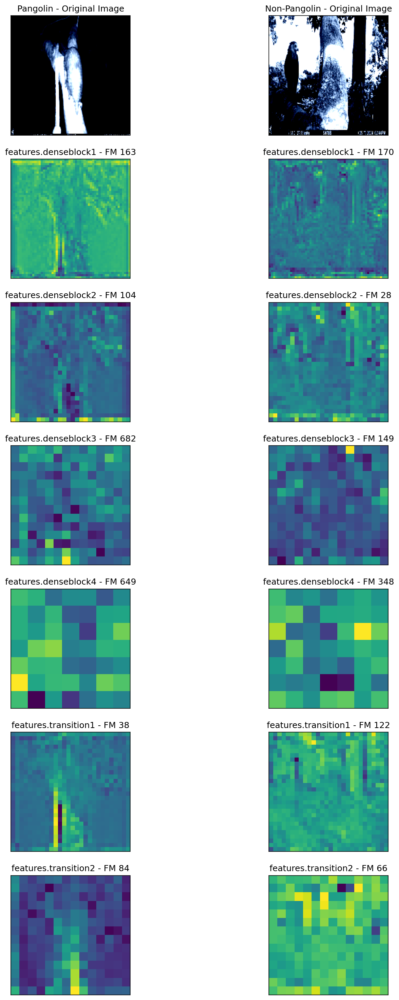

0.5366605967283249
Saving for this epoch 4
Epoch [5/15], Train Loss: 0.5419, Validation Loss: 0.4926
Training Per-Species Metrics:
Precision: 0.7016, Recall: 1.0000, F1: 0.8247
Species 1 - Accuracy: 0.7486, Precision: 1.0000, Recall: 0.3851, F1: 0.5561
Training Overall Accuracy: 0.7486, Precision: 0.8508, Recall: 0.6926, F1: 0.6904
Validation Overall Accuracy: 0.8049, Precision: 0.8750, Recall: 0.7647, F1: 0.7747
Epoch time 116.59815287590027





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

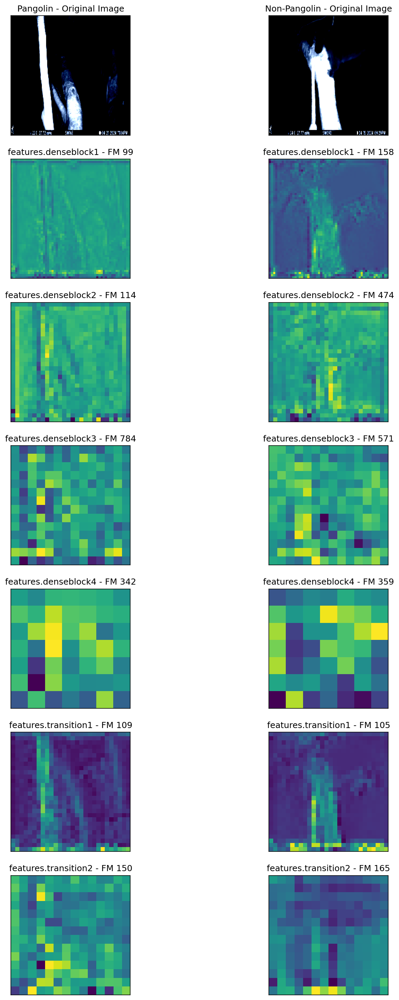

0.4925595372915268
Saving for this epoch 5
Epoch [6/15], Train Loss: 0.5152, Validation Loss: 0.4467
Training Per-Species Metrics:
Precision: 0.7483, Recall: 1.0000, F1: 0.8560
Species 1 - Accuracy: 0.8011, Precision: 1.0000, Recall: 0.5135, F1: 0.6786
Training Overall Accuracy: 0.8011, Precision: 0.8741, Recall: 0.7568, F1: 0.7673
Validation Overall Accuracy: 0.8293, Precision: 0.8871, Recall: 0.7941, F1: 0.8067
Epoch time 116.9224259853363





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

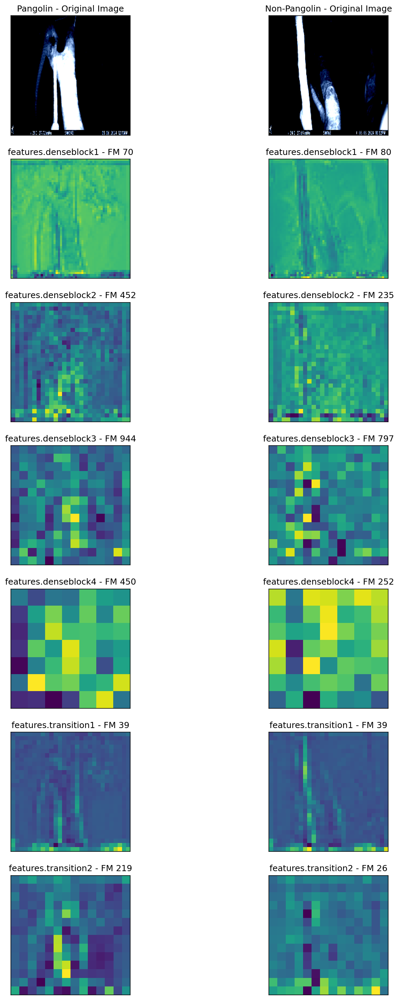

0.4467030465602875
Saving for this epoch 6
Epoch [7/15], Train Loss: 0.4915, Validation Loss: 0.4037
Training Per-Species Metrics:
Precision: 0.7737, Recall: 0.9907, F1: 0.8689
Species 1 - Accuracy: 0.8232, Precision: 0.9773, Recall: 0.5811, F1: 0.7288
Training Overall Accuracy: 0.8232, Precision: 0.8755, Recall: 0.7859, F1: 0.7988
Validation Overall Accuracy: 0.8537, Precision: 0.9000, Recall: 0.8235, F1: 0.8373
Epoch time 119.08842492103577





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2914162].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2914162].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2914162].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2914162].
Clippin

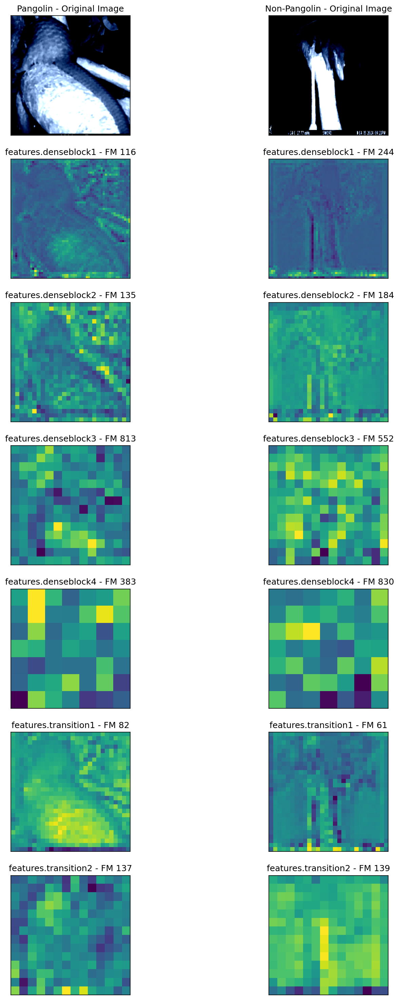

0.4037112444639206
Saving for this epoch 7
Epoch [8/15], Train Loss: 0.4410, Validation Loss: 0.3714
Training Per-Species Metrics:
Precision: 0.8092, Recall: 0.9907, F1: 0.8908
Species 1 - Accuracy: 0.8564, Precision: 0.9800, Recall: 0.6622, F1: 0.7903
Training Overall Accuracy: 0.8564, Precision: 0.8946, Recall: 0.8264, F1: 0.8405
Validation Overall Accuracy: 0.9268, Precision: 0.9444, Recall: 0.9118, F1: 0.9222
Epoch time 118.48105788230896





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

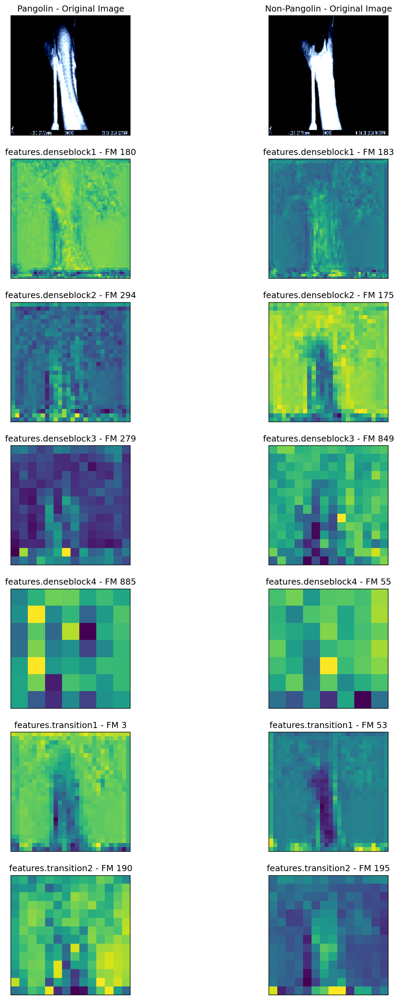

0.3713552951812744
Saving for this epoch 8
Epoch [9/15], Train Loss: 0.4234, Validation Loss: 0.3320
Training Per-Species Metrics:
Precision: 0.8178, Recall: 0.9860, F1: 0.8941
Species 1 - Accuracy: 0.8619, Precision: 0.9712, Recall: 0.6824, F1: 0.8016
Training Overall Accuracy: 0.8619, Precision: 0.8945, Recall: 0.8342, F1: 0.8478
Validation Overall Accuracy: 0.9024, Precision: 0.9286, Recall: 0.8824, F1: 0.8949
Epoch time 117.09617519378662





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

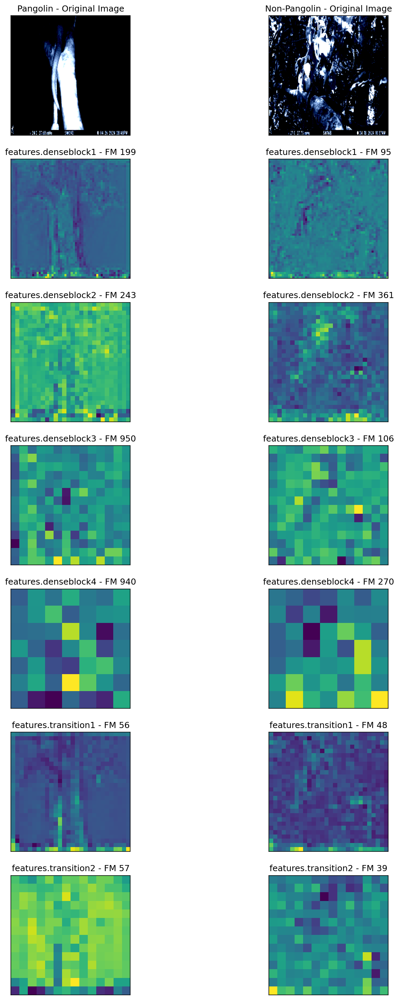

0.33201293647289276
Saving for this epoch 9
Epoch [10/15], Train Loss: 0.3859, Validation Loss: 0.3025
Training Per-Species Metrics:
Precision: 0.8536, Recall: 0.9533, F1: 0.9007
Species 1 - Accuracy: 0.8757, Precision: 0.9187, Recall: 0.7635, F1: 0.8339
Training Overall Accuracy: 0.8757, Precision: 0.8861, Recall: 0.8584, F1: 0.8673
Validation Overall Accuracy: 0.9756, Precision: 0.9800, Recall: 0.9706, F1: 0.9746
Epoch time 116.16053891181946





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8096584..2.5005665].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8096584..2.5005665].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8096584..2.5005665].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8096584..2.5005665].
Cli

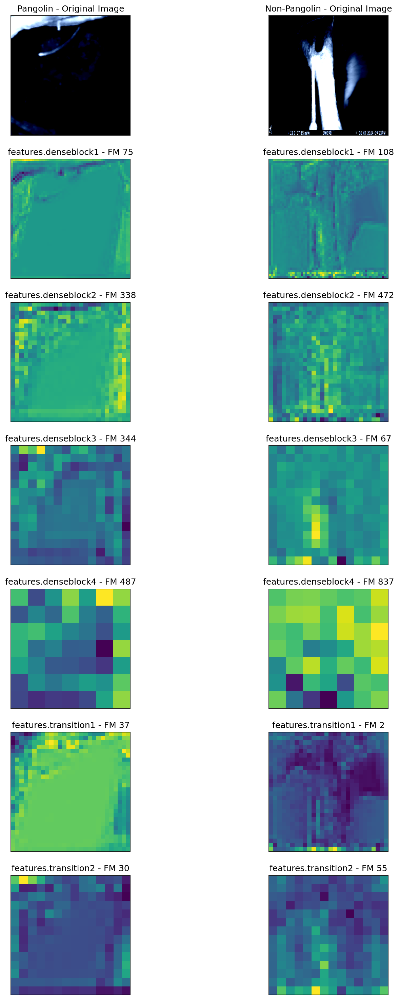

0.3024546653032303
Saving for this epoch 10
Epoch [11/15], Train Loss: 0.3519, Validation Loss: 0.2717
Training Per-Species Metrics:
Precision: 0.8841, Recall: 0.9626, F1: 0.9217
Species 1 - Accuracy: 0.9033, Precision: 0.9380, Recall: 0.8176, F1: 0.8736
Training Overall Accuracy: 0.9033, Precision: 0.9111, Recall: 0.8901, F1: 0.8977
Validation Overall Accuracy: 0.9512, Precision: 0.9615, Recall: 0.9412, F1: 0.9487
Epoch time 114.24723696708679





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

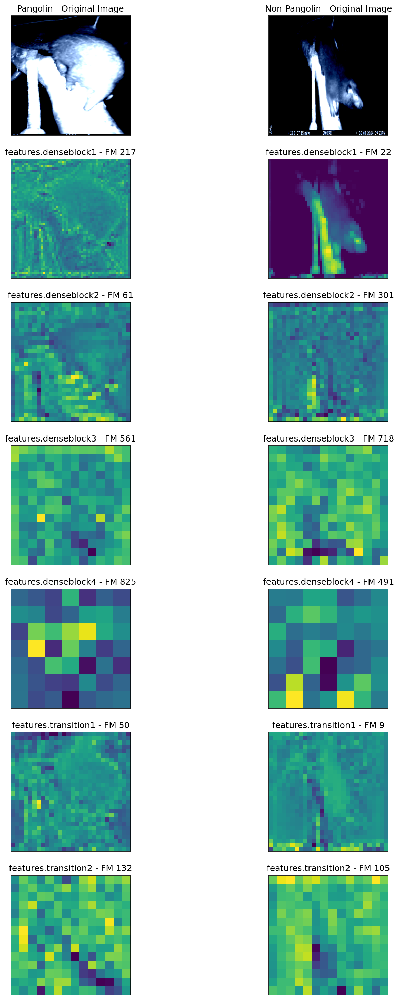

0.2717274874448776
Saving for this epoch 11
Epoch [12/15], Train Loss: 0.3396, Validation Loss: 0.2450
Training Per-Species Metrics:
Precision: 0.8595, Recall: 0.9720, F1: 0.9123
Species 1 - Accuracy: 0.8895, Precision: 0.9500, Recall: 0.7703, F1: 0.8507
Training Overall Accuracy: 0.8895, Precision: 0.9048, Recall: 0.8711, F1: 0.8815
Validation Overall Accuracy: 0.9756, Precision: 0.9800, Recall: 0.9706, F1: 0.9746
Epoch time 117.52498507499695





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

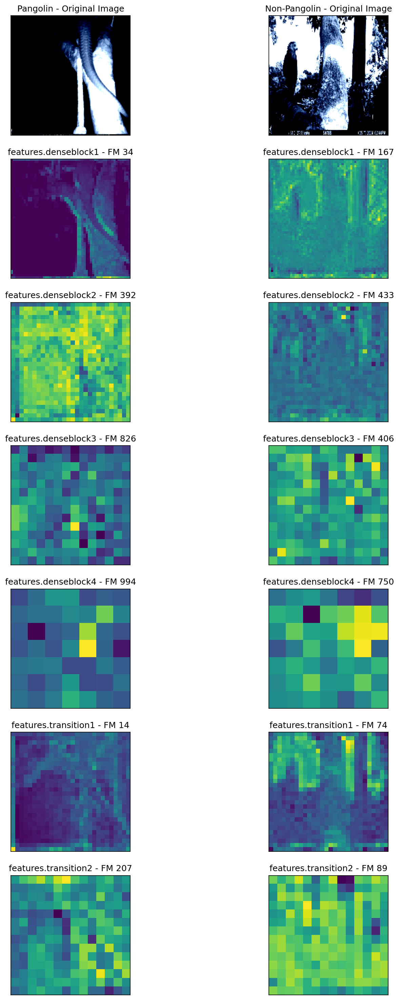

0.24495141953229904
Saving for this epoch 12
Epoch [13/15], Train Loss: 0.3118, Validation Loss: 0.2160
Training Per-Species Metrics:
Precision: 0.8681, Recall: 0.9533, F1: 0.9087
Species 1 - Accuracy: 0.8867, Precision: 0.9213, Recall: 0.7905, F1: 0.8509
Training Overall Accuracy: 0.8867, Precision: 0.8947, Recall: 0.8719, F1: 0.8798
Validation Overall Accuracy: 0.9756, Precision: 0.9800, Recall: 0.9706, F1: 0.9746
Epoch time 114.89122605323792





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

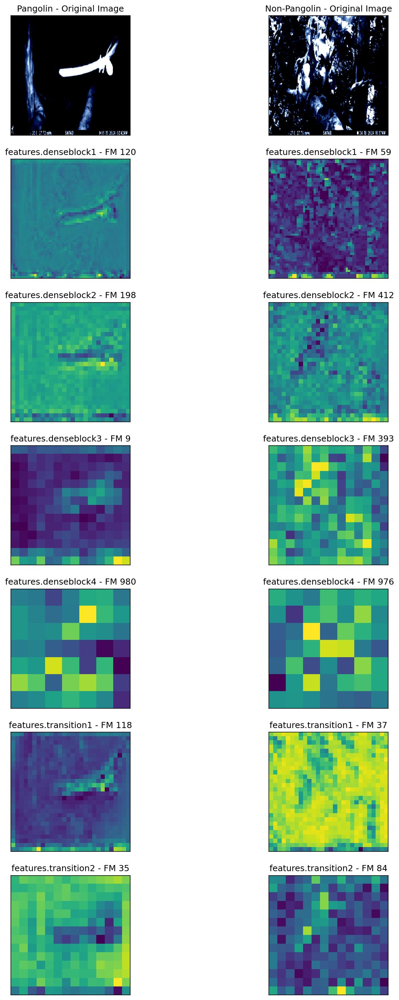

0.2160380631685257
Saving for this epoch 13
Epoch [14/15], Train Loss: 0.3313, Validation Loss: 0.1955
Training Per-Species Metrics:
Precision: 0.8918, Recall: 0.9626, F1: 0.9258
Species 1 - Accuracy: 0.9088, Precision: 0.9389, Recall: 0.8311, F1: 0.8817
Training Overall Accuracy: 0.9088, Precision: 0.9154, Recall: 0.8968, F1: 0.9038
Validation Overall Accuracy: 0.9756, Precision: 0.9800, Recall: 0.9706, F1: 0.9746
Epoch time 116.07114601135254





Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the 

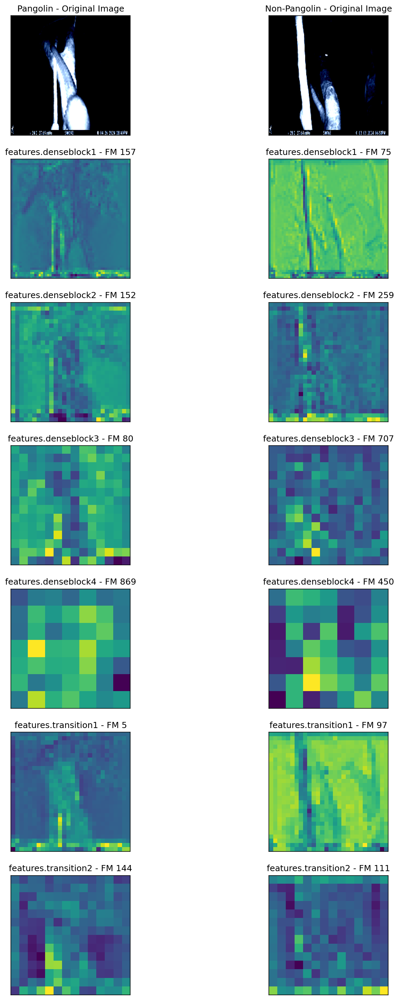

0.1955440267920494
Saving for this epoch 14
Epoch [15/15], Train Loss: 0.2720, Validation Loss: 0.1867
Training Per-Species Metrics:
Precision: 0.9058, Recall: 0.9439, F1: 0.9245
Species 1 - Accuracy: 0.9088, Precision: 0.9137, Recall: 0.8581, F1: 0.8850
Training Overall Accuracy: 0.9088, Precision: 0.9097, Recall: 0.9010, F1: 0.9048
Validation Overall Accuracy: 0.9756, Precision: 0.9800, Recall: 0.9706, F1: 0.9746
Epoch time 112.97066116333008



Test Metrics - Accuracy: 0.9800, Precision: 1.0000, Recall: 0.9512, F1: 0.9750, AUC: 1.0000
Test Per-Species Metrics:
Precision: 0.9672, Recall: 1.0000, F1: 0.9833
Species 1 - Accuracy: 0.9800, Precision: 1.0000, Recall: 0.9512, F1: 0.9750


In [12]:
from torch.utils.data import DataLoader 
from PIL import Image
import sklearn
from sklearn.model_selection import StratifiedKFold, StratifiedShuffleSplit
from iterstrat.ml_stratifiers import MultilabelStratifiedKFold
import torch
import torch.optim as optim
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, confusion_matrix
import matplotlib.pyplot as plt
import numpy as np
import torch.optim as optim
from torch import nn  # import neural network from PyTorch
import torchvision.models as models  # import models submodule (includes pre-trained models used for computer vision)
from torchmetrics.classification import MulticlassAccuracy
from sklearn.metrics import roc_auc_score
from sklearn.model_selection import train_test_split
import math
from torchmetrics.classification import BinaryAccuracy




import time  # Import the time module for tracking training time

# Store feature maps for each layer
feature_maps = {}

# Define the hook function to save feature maps
def hook_fn(module, input, output, layer_name):
    feature_maps[layer_name] = output.detach()


# Define a function that trains and evaluates the model for a specified number of epochs
def train_and_evaluate(model, train_loader, val_loader, criterion, optimizer, num_epochs):
    train_losses, val_losses = [], []
    train_metrics, val_metrics = [], []  # To store metrics like accuracy, precision, etc. for each epoch
    per_species_train_metrics = {  # Store per-species metrics for training
        'accuracy': [],
        'precision': [],
        'recall': [],
        'f1': [],
        'auc': []
    }
    per_species_val_metrics = {  # Store per-species metrics for validation
        'accuracy': [],
        'precision': [],
        'recall': [],
        'f1': [],
        'auc': []
    }
    train_times = []  # List to store the time for each epoch

    model_save_path = []  # To store the best model based on validation loss
    # Specify the layers you want to visualize
    layers_to_visualize = ['features.denseblock1', 'features.denseblock2', 'features.denseblock3', 'features.denseblock4', 'features.transition1', 'features.transition2']

    # Register hooks for each layer
    hooks = []
    for layer_name in layers_to_visualize:
        layer = dict([*model.named_modules()])[layer_name]  # Get the layer by name
        hook = layer.register_forward_hook(lambda module, input, output, name=layer_name: hook_fn(module, input, output, name))
        hooks.append(hook)


    for epoch in range(num_epochs):
        start_time = time.time()  # Start the timer at the beginning of the epoch

        model.train()  # Set the model to train mode
        train_loss, train_preds, train_labels = 0, [], []
        train_probs = []
        train_outputs = []
        train_auc = 0

        # Training loop:
        for batch in train_loader:
            images = batch['image']
            labels = batch['label'] # CHANGED
            labels = labels.unsqueeze(1).float()
            #labels = torch.argmax(labels, dim=1)  # Convert to 1D tensor of class indices
            #print(f"Unique labels in train batch: {torch.unique(labels)}")

            optimizer.zero_grad()
            outputs = model(images)  # Obtains predictions
            loss = criterion(outputs, labels)  # Computes the loss
            loss.backward()  # Backprop to compute the gradients
            optimizer.step()  # Updates the model weights based on gradients

            # Save train loss
            train_loss += loss.item()  # Accumulates the loss for the batch
            preds = (outputs > 0.5).int()  # binary predictions: 0 or 1
            train_preds.extend(preds.cpu().numpy())
            #train_preds.extend(torch.argmax(outputs, dim=1).cpu().numpy())  CHANGED
            train_labels.extend(labels.cpu().numpy())  # Stores the true labels for the batch

            # Add AUC calculation for training
            #train_outputs.extend(outputs.cpu().detach().numpy())  # Get probabilities for each class
            #train_auc = roc_auc_score(train_labels, train_outputs.cpu().detach().numpy(), average='macro', multi_class='ovr')
            #train_probs.extend(torch.softmax(outputs, dim=1).cpu().detach().numpy()) CHANGED
            train_probs.extend(outputs.cpu().detach().numpy())
        
        # Visualization after each epoch
        # Find indices of one pangolin and one non-pangolin
        pangolin_idx = (labels == 1).nonzero(as_tuple=True)[0][0].item()  # First pangolin
        non_pangolin_idx = (labels == 0).nonzero(as_tuple=True)[0][0].item()  # First non-pangolin
        fig, axes = plt.subplots(len(layers_to_visualize) + 1, 2, figsize=(12, 25), dpi=150)  # Increased DPI for better resolution

        for i, layer_name in enumerate(layers_to_visualize):
            # Display Pangolin original image
            axes[0][0].imshow(images[pangolin_idx].cpu().numpy().transpose(1, 2, 0))
            axes[0][0].set_xticks([]); axes[0][0].set_yticks([])
            axes[0][0].set_title("Pangolin - Original Image")

            # Display Non-Pangolin original image
            axes[0][1].imshow(images[non_pangolin_idx].cpu().numpy().transpose(1, 2, 0))
            axes[0][1].set_xticks([]); axes[0][1].set_yticks([])
            axes[0][1].set_title("Non-Pangolin - Original Image")

            # Display feature maps for Pangolin image
            fmap_pangolin = feature_maps[layer_name][pangolin_idx]  # Feature map for Pangolin image
            fmap_pangolin = (fmap_pangolin - fmap_pangolin.min()) / (fmap_pangolin.max() - fmap_pangolin.min())  # Normalize
            num_channels = fmap_pangolin.shape[0]
            
            random_channel_pangolin = np.random.randint(0, num_channels)  # Pick a random channel for pangolin
            feature_map_pangolin = fmap_pangolin[random_channel_pangolin].cpu().numpy()

            axes[i + 1][0].imshow(feature_map_pangolin, cmap='viridis')
            axes[i + 1][0].set_xticks([]); axes[i + 1][0].set_yticks([])
            axes[i + 1][0].set_title(f"{layer_name} - FM {random_channel_pangolin}")

            # Display feature maps for Non-Pangolin image
            fmap_non_pangolin = feature_maps[layer_name][non_pangolin_idx]  # Feature map for Non-Pangolin image
            fmap_non_pangolin = (fmap_non_pangolin - fmap_non_pangolin.min()) / (fmap_non_pangolin.max() - fmap_non_pangolin.min())  # Normalize
            random_channel_non_pangolin = np.random.randint(0, num_channels)  # Pick a random channel for non-pangolin
            feature_map_non_pangolin = fmap_non_pangolin[random_channel_non_pangolin].cpu().numpy()

            axes[i + 1][1].imshow(feature_map_non_pangolin, cmap='viridis')
            axes[i + 1][1].set_xticks([]); axes[i + 1][1].set_yticks([])
            axes[i + 1][1].set_title(f"{layer_name} - FM {random_channel_non_pangolin}")




        plt.show()


        train_outputs = np.array(train_probs)
        train_labels = np.array(train_labels)
        
        #train_auc = roc_auc_score(train_labels, train_outputs[:, 1], average='macro', multi_class='ovr')
        train_auc = roc_auc_score(train_labels, train_probs)


        train_loss /= len(train_loader)  # Computes the average training loss for the epoch
        train_losses.append(train_loss)  # Stores the average training loss for this epoch

        # Calculate per-species metrics for training
        train_labels_tensor = torch.tensor(train_labels)
        train_preds_tensor = torch.tensor(train_preds)

        accuracy_metric = BinaryAccuracy()
        accuracy_metric.update(train_preds_tensor, train_labels_tensor)
        binary_accuracy = accuracy_metric.compute().item()
        species_train_accuracy = [1 - binary_accuracy, binary_accuracy]

        species_train_precision = precision_score(train_labels, train_preds, average=None)  # Per-class precision
        species_train_recall = recall_score(train_labels, train_preds, average=None)  # Per-class recall
        species_train_f1 = f1_score(train_labels, train_preds, average=None)  # Per-class F1 score
        
        # Calculate per-species AUC for training
        species_train_auc = []
        for i in range(len(species_train_accuracy)):  # Loop through each class
            # Calculate the AUC for each class
            auc = roc_auc_score(train_labels, train_probs)
            species_train_auc.append(auc)

        per_species_train_metrics['accuracy'].append(species_train_accuracy)
        per_species_train_metrics['precision'].append(species_train_precision)
        per_species_train_metrics['recall'].append(species_train_recall)
        per_species_train_metrics['f1'].append(species_train_f1)
        per_species_train_metrics['auc'].append(species_train_auc)  # Append AUC values for training

        # Calculate overall metrics for training
        train_accuracy = accuracy_score(train_labels, train_preds)  # Overall accuracy
        train_precision = precision_score(train_labels, train_preds, average='macro')  # Overall precision (macro-average)
        train_recall = recall_score(train_labels, train_preds, average='macro')  # Overall recall (macro-average)
        train_f1 = f1_score(train_labels, train_preds, average='macro')  # Overall F1 score (macro-average)

        train_metrics.append({
            'accuracy': train_accuracy,
            'precision': train_precision,
            'recall': train_recall,
            'f1': train_f1,
            'auc': train_auc
        })

        # Validation Loop:
        model.eval()  # Set the model to evaluation mode
        val_loss, val_preds, val_labels = 0, [], []
        val_probs = []
        val_auc = 0
        with torch.no_grad():
            for batch in val_loader:
                images = batch['image']
                labels = batch['label'].unsqueeze(1).float()

                outputs = model(images)
                loss = criterion(outputs, labels)
                val_loss += loss.item()

                # Binary prediction: 1 if output > 0.5, else 0
                preds = (outputs > 0.5).int()
                val_preds.extend(preds.cpu().numpy())
                val_labels.extend(labels.cpu().numpy())

                # For AUC, store sigmoid probabilities
                val_probs.extend(outputs.cpu().detach().numpy())

        val_loss /= len(val_loader)  # Computes the average validation loss for this epoch
        

        # Calculate per-species metrics for validation
        species_val_precision = precision_score(val_labels, val_preds, average=None)  # Per-class precision
        species_val_recall = recall_score(val_labels, val_preds, average=None)  # Per-class recall
        species_val_f1 = f1_score(val_labels, val_preds, average=None)  # Per-class F1 score

        
        val_labels_tensor = torch.tensor(val_labels)  # Make sure to convert them to torch tensors
        val_preds_tensor = torch.tensor(val_preds)

        accuracy_metric = MulticlassAccuracy(num_classes=2, average=None)
        accuracy_metric.update(val_preds_tensor, val_labels_tensor)
        species_val_accuracy = accuracy_metric.compute().tolist()

        val_auc = roc_auc_score(np.array(val_labels).flatten(), np.array(val_probs).flatten())


        # Calculate per-species AUC for validation
        species_val_auc = []
        #for i in range(len(species_val_accuracy)):  # Loop through each class
            # Calculate the AUC for each class
            #auc = roc_auc_score([1 if label == i else 0 for label in val_labels], [prob[i] for prob in val_probs])
            #species_val_auc.append(auc)

        per_species_val_metrics['accuracy'].append(species_val_accuracy)
        per_species_val_metrics['precision'].append(species_val_precision)
        per_species_val_metrics['recall'].append(species_val_recall)
        per_species_val_metrics['f1'].append(species_val_f1)
        per_species_val_metrics['auc'].append(species_val_auc)



        # Calculate overall metrics for validation
        val_accuracy = accuracy_score(val_labels, val_preds)  # Overall accuracy
        val_precision = precision_score(val_labels, val_preds, average='macro')  # Overall precision (macro-average)
        val_recall = recall_score(val_labels, val_preds, average='macro')  # Overall recall (macro-average)
        val_f1 = f1_score(val_labels, val_preds, average='macro')  # Overall F1 score (macro-average)

        val_metrics.append({
            'accuracy': val_accuracy,
            'precision': val_precision,
            'recall': val_recall,
            'f1': val_f1,
            'auc': val_auc
        })

        # Save the model with the lowest validation loss
        
        if epoch == 0 or val_loss < min(val_losses):
            if epoch != 0: 
                print(min(val_losses))
            print("Saving for this epoch", epoch)
            model_save_path = model.state_dict()
        val_losses.append(val_loss)  # Stores the average validation loss for this epoch


        # Print per-species metrics and overall metrics
        print(f"Epoch [{epoch+1}/{num_epochs}], Train Loss: {train_loss:.4f}, Validation Loss: {val_loss:.4f}")
        
        # Print per-species metrics for training
       # Print per-species metrics for training
        print("Training Per-Species Metrics:")
    
        for idx in range(len(species_train_accuracy)):
            #print(f"Species {idx} - Accuracy: {species_train_accuracy[idx]:.4f}, Precision: {species_train_precision[idx]:.4f}, Recall: {species_train_recall[idx]:.4f}, F1: {species_train_f1[idx]:.4f}")
            # Check if idx is within the bounds of other metrics
            if idx == 1:
                print(f"Species {idx} - Accuracy: {species_train_accuracy[idx]:.4f}, Precision: {species_train_precision[idx]:.4f}, Recall: {species_train_recall[idx]:.4f}, F1: {species_train_f1[idx]:.4f}")
            else:
                print(f"Precision: {species_train_precision[idx]:.4f}, Recall: {species_train_recall[idx]:.4f}, F1: {species_train_f1[idx]:.4f}")
            #if idx < len(species_train_precision) and idx < len(species_train_recall) and idx < len(species_train_f1):
                #print(f"Species {idx} - Accuracy: {species_train_accuracy[idx]:.4f}, Precision: {species_train_precision[idx]:.4f}, Recall: {species_train_recall[idx]:.4f}, F1: {species_train_f1[idx]:.4f}")
            #else:
                #print(f"Species {idx} - Accuracy: {species_train_accuracy[idx]:.4f}, Precision: N/A, Recall: N/A, F1: N/A")
                

        # Print overall metrics for training
        print(f"Training Overall Accuracy: {train_accuracy:.4f}, Precision: {train_precision:.4f}, Recall: {train_recall:.4f}, F1: {train_f1:.4f}")

       # Print per-species metrics for validation
        #print("Validation Per-Species Metrics:")
        #for idx in range(len(species_val_accuracy)):
            # Check if idx is within the bounds of other metrics
            #if idx < len(species_val_precision) and idx < len(species_val_recall) and idx < len(species_val_f1):
                #print(f"Species {idx} - Accuracy: {species_val_accuracy[idx]:.4f}, Precision: {species_val_precision[idx]:.4f}, Recall: {species_val_recall[idx]:.4f}, F1: {species_val_f1[idx]:.4f}")
            #else:
                #print(f"Species {idx} - Accuracy: {species_val_accuracy[idx]:.4f}, Precision: N/A, Recall: N/A, F1: N/A")
                
        # Print overall metrics for validation
        print(f"Validation Overall Accuracy: {val_accuracy:.4f}, Precision: {val_precision:.4f}, Recall: {val_recall:.4f}, F1: {val_f1:.4f}")

        # Calculate training time for this epoch
        end_time = time.time()
        epoch_time = end_time - start_time
        print("Epoch time", epoch_time)
        train_times.append(epoch_time)
        print("\n\n")

    return model_save_path, train_losses, val_losses, val_metrics, train_metrics, per_species_train_metrics, per_species_val_metrics, train_times

###### KFOLD CROSS VALIDATION ########
strat_kf = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)  # Shuffle data with random_seed = 42 for reproducibility
all_train_metrics = {
    'accuracy': [],
    'precision': [],
    'recall': [],
    'f1': [],
    'auc': []
}
all_val_metrics = {
    'accuracy': [],
    'precision': [],
    'recall': [],
    'f1': []
}

all_test_metrics = {
    'accuracy': [],
    'precision': [],
    'recall': [],
    'f1': [],
    'auc': []
}

all_per_species_train_metrics = {
    'accuracy': [],
    'precision': [],
    'recall': [],
    'f1': [],
    'auc': []
}
all_per_species_val_metrics = {
    'accuracy': [],
    'precision': [],
    'recall': [],
    'f1': [],
    'auc': []
}

all_per_species_test_metrics = {
    'accuracy': [],
    'precision': [],
    'recall': [],
    'f1': [], 
    'auc': []
}
all_train_times = []
all_train_losses = []
all_validation_loss = []


#y_train = y_train.argmax(axis=1)
#for fold, (train_index, test_index) in enumerate(kf.split(combined_df)):
for fold, (train_index, test_index) in enumerate(strat_kf.split(combined_df, y_train)):  # Stratified split
    print(f"Fold {fold+1}/{5}")

    # Split data
    train_data = x_train.iloc[train_index]  # File paths for training set
    test_data = x_train.iloc[test_index]  # File paths for testing set
    train_labels = y_train[train_index]  # Labels for training set
    test_labels = y_train[test_index]  # Labels for testing set
    
    # Further split the training data into training and validation (90/10 split)
        #train_data, val_data = train_data[:int(0.9 * len(train_data))], train_data[int(0.9 * len(train_data)):]
        #train_labels, val_labels = train_labels[:int(0.9 * len(train_labels))], train_labels[int(0.9 * len(train_labels)):]
   # Perform stratified split while maintaining original proportions
    train_data, val_data, train_labels, val_labels = train_test_split(
        train_data, train_labels,  # Original training data and labels
        test_size=0.1,  # 10% of train_data becomes val_data
        stratify=train_labels,  # Ensures class proportions are preserved
        random_state=42  # For reproducibility
    )


    # Filter out .DS_Store files from train, validation, and test data
    train_data = train_data[~train_data['filepath'].str.endswith('.DS_Store')]
    val_data = val_data[~val_data['filepath'].str.endswith('.DS_Store')]
    test_data = test_data[~test_data['filepath'].str.endswith('.DS_Store')]



    # Create Dataloader for this fold
    train_dataset = ImagesDataset(train_data, train_labels)  # Ensure transform is defined
    val_dataset = ImagesDataset(val_data, val_labels)
    test_dataset = ImagesDataset(test_data, test_labels)

    train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True)
    val_loader = DataLoader(val_dataset, batch_size=32, shuffle=False)
    test_loader = DataLoader(test_dataset, batch_size=32, shuffle=False)

    
    

    model = models.densenet121(pretrained=False)  
    model.classifier = nn.Sequential(  # Replace the classifier layer
        nn.Linear(1024, 100),  # Dense layer takes a 1024-dim input and outputs 100-dim
        nn.ReLU(inplace=True),  # ReLU activation
        nn.Dropout(0.1),  # Dropout for regularization
        nn.Linear(100, 1),  # Final layer for 1 class
        nn.Sigmoid()
    )

    criterion = nn.BCELoss() # for binary classification
    optimizer = optim.SGD(model.parameters(), lr=0.001, momentum=0.9)
    # model.parameters() - weights and biases that optimizer updates during training

    best_model, train_losses, val_losses, val_metrics, train_metrics, per_species_train_metrics, per_species_val_metrics, train_times = train_and_evaluate(
        model, train_loader, val_loader, criterion, optimizer, num_epochs=15
    )

    torch.save(best_model, f"arboreal_false_best_model_fold_{fold+1}.pth")


    all_val_metrics['accuracy'].append(val_metrics[-1]['accuracy'])
    all_val_metrics['precision'].append(val_metrics[-1]['precision'])
    all_val_metrics['recall'].append(val_metrics[-1]['recall'])
    all_val_metrics['f1'].append(val_metrics[-1]['f1'])

    all_train_metrics['accuracy'].append(train_metrics[-1]['accuracy'])
    all_train_metrics['precision'].append(train_metrics[-1]['precision'])
    all_train_metrics['recall'].append(train_metrics[-1]['recall'])
    all_train_metrics['f1'].append(train_metrics[-1]['f1'])
    all_train_metrics['auc'].append(train_metrics[-1]['auc'])

    # Store per-species metrics and training time for this fold
    all_per_species_train_metrics['accuracy'].append(per_species_train_metrics['accuracy'])
    all_per_species_train_metrics['precision'].append(per_species_train_metrics['precision'])
    all_per_species_train_metrics['recall'].append(per_species_train_metrics['recall'])
    all_per_species_train_metrics['f1'].append(per_species_train_metrics['f1'])
    all_per_species_train_metrics['auc'].append(per_species_train_metrics['auc'])

    all_per_species_val_metrics['accuracy'].append(per_species_val_metrics['accuracy'])
    all_per_species_val_metrics['precision'].append(per_species_val_metrics['precision'])
    all_per_species_val_metrics['recall'].append(per_species_val_metrics['recall'])
    all_per_species_val_metrics['f1'].append(per_species_val_metrics['f1'])

    all_train_times.append(train_times)
    all_train_losses.append(train_losses)
    all_validation_loss.append(val_losses)

    # Evaluate on the test set
    model.load_state_dict(best_model)  # Load the best model saved during training
    model.eval()  # Set the model to evaluation mode

    # Initialize variables to calculate metrics
    test_preds, test_labels = [], []
    test_probs = []
    test_auc = 0
    test_outputs = []

    per_species_test_metrics = {
        'accuracy': [],
        'precision': [],
        'recall': [],
        'f1': [],
        'auc': []
    }

    # Iterate over the test set to get predictions
    with torch.no_grad():
        for batch in test_loader:
            images, labels = batch['image'], batch['label']
            labels = labels.unsqueeze(1).float()
            outputs = model(images)
            
            # For binary classification, get the probabilities for class 1
            probs = torch.sigmoid(outputs).squeeze()  # Squeeze to remove extra dimensions
            preds = (outputs > 0.5).int()
            test_preds.extend(preds.cpu().numpy())  # Predicted label: 1 if prob > 0.5, else 0
            test_labels.extend(labels.cpu().numpy())  # Get true labels

            #test_outputs.extend(probs.cpu().detach().numpy())  # Get probabilities for the positive class
            test_probs.extend(outputs.cpu().detach().numpy())  # Store probabilities for AUC calculation


    #test_outputs = np.array(test_probs)
    test_labels = np.array(test_labels)

    # Calculate AUC using probabilities for the positive class
    test_auc = roc_auc_score(test_labels, test_probs)

    # Compute overall test metrics
    test_accuracy = accuracy_score(test_labels, test_preds)
    test_precision = precision_score(test_labels, test_preds)
    test_recall = recall_score(test_labels, test_preds)
    test_f1 = f1_score(test_labels, test_preds)

    # Print overall test metrics
    print(f"Test Metrics - Accuracy: {test_accuracy:.4f}, Precision: {test_precision:.4f}, Recall: {test_recall:.4f}, F1: {test_f1:.4f}, AUC: {test_auc:.4f}")


    species_test_precision = precision_score(test_labels, test_preds, average=None)  # Per-class precision
    species_test_recall = recall_score(test_labels, test_preds, average=None)  # Per-class recall
    species_test_f1 = f1_score(test_labels, test_preds, average=None)  # Per-class F1 score

    # Store per-species test metrics (though only class 1 is meaningful here)
    per_species_test_metrics['accuracy'].append([1-test_accuracy, test_accuracy])  # Accuracy for the entire test set
    per_species_test_metrics['precision'].append(species_test_precision)
    per_species_test_metrics['recall'].append(species_test_recall)
    per_species_test_metrics['f1'].append(species_test_f1)

    # Calculate AUC for class 1 (positive class)
    species_test_auc = roc_auc_score(test_labels, test_probs)

    per_species_test_metrics['auc'].append(species_test_auc)

    # Print per-species test metrics
    print("Test Per-Species Metrics:")
    for idx in range(2):
            if idx == 1:
                print(f"Species {idx} - Accuracy: {test_accuracy:.4f}, "
                    f"Precision: {species_test_precision[idx]:.4f}, "
                    f"Recall: {species_test_recall[idx]:.4f}, "
                    f"F1: {species_test_f1[idx]:.4f}")
            else:
                print(f"Precision: {species_test_precision[idx]:.4f}, "
                    f"Recall: {species_test_recall[idx]:.4f}, "
                    f"F1: {species_test_f1[idx]:.4f}")
   
    # Save test metrics for each fold
    all_test_metrics['accuracy'].append(test_accuracy)
    all_test_metrics['precision'].append(test_precision)
    all_test_metrics['recall'].append(test_recall)
    all_test_metrics['f1'].append(test_f1)
    all_test_metrics['auc'].append(test_auc)

    all_per_species_test_metrics['accuracy'].append(per_species_test_metrics['accuracy'][-1])
    all_per_species_test_metrics['precision'].append(per_species_test_metrics['precision'][-1])
    all_per_species_test_metrics['recall'].append(per_species_test_metrics['recall'][-1])   
    all_per_species_test_metrics['f1'].append(per_species_test_metrics['f1'][-1])
    all_per_species_test_metrics['auc'].append(per_species_test_metrics['auc'][-1])



## Graph Different Metrics 

### Confusion Matrices for Each Test Run (1 per fold)

Processing Confusion Matrix for Fold 1


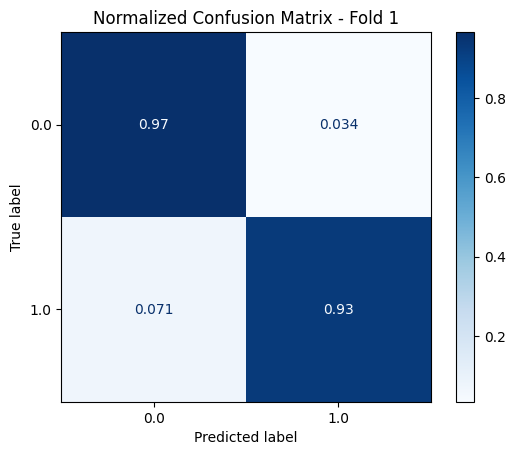

Processing Confusion Matrix for Fold 2


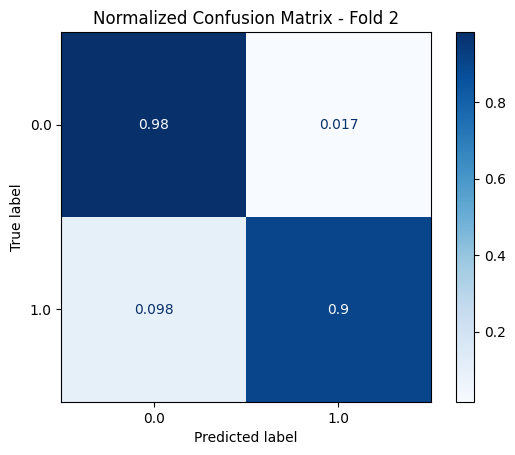

Processing Confusion Matrix for Fold 3


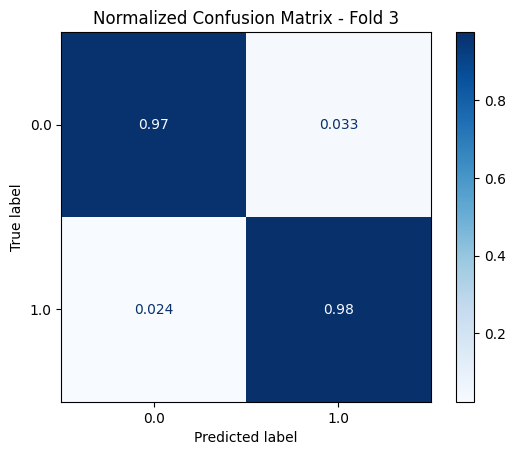

Processing Confusion Matrix for Fold 4


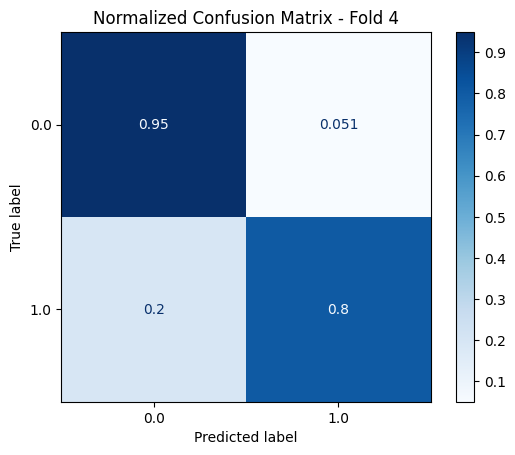

Processing Confusion Matrix for Fold 5


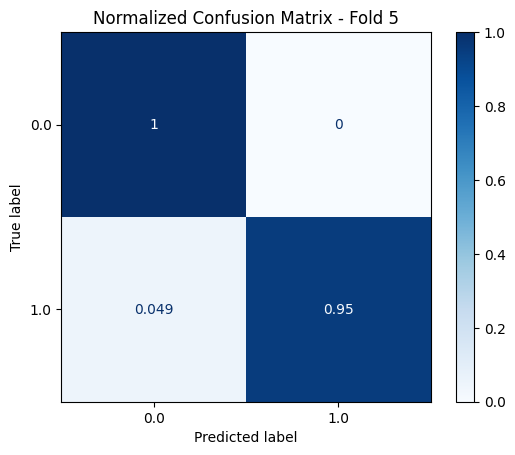

In [15]:
from sklearn.metrics import confusion_matrix
from sklearn.metrics import ConfusionMatrixDisplay

strat_kf = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)  # Shuffle data with random_seed = 42 for reproducibility

for fold, (train_index, test_index) in enumerate(strat_kf.split(combined_df, y_train)):
    print(f"Processing Confusion Matrix for Fold {fold + 1}")

    # Retrieve the SAME test set as before
    test_data = x_train.iloc[test_index]  # File paths for testing set
    test_labels = y_train[test_index]  # Labels for testing set

    # Filter out .DS_Store files (same as before)
    test_data = test_data[~test_data['filepath'].str.endswith('.DS_Store')]

    # Create dataset and dataloader (must match original format)
    test_dataset = ImagesDataset(test_data, test_labels)
    test_loader = DataLoader(test_dataset, batch_size=32, shuffle=False)

    # Load the trained model for this fold
    model = models.densenet121(pretrained=False)  
    model.classifier = nn.Sequential(  # Replace the classifier layer
        nn.Linear(1024, 100),  # Dense layer takes a 1024-dim input and outputs 100-dim
        nn.ReLU(inplace=True),  # ReLU activation
        nn.Dropout(0.1),  # Dropout for regularization
        nn.Linear(100, 1),  # Final layer for 1 class
        nn.Sigmoid()
    )
    model.load_state_dict(torch.load(f"arboreal_false_best_model_fold_{fold+1}.pth"))
    model.eval()  

    # Get predictions on the test set
    test_preds, test_labels = [], []
    with torch.no_grad():
        for batch in test_loader:
            images, labels = batch['image'], batch['label']
            labels = labels.unsqueeze(1).float()
            outputs = model(images)
            
            # For binary classification, get the probabilities for class 1
            #probs = torch.sigmoid(outputs).squeeze()  # Squeeze to remove extra dimensions
            preds = (outputs > 0.5).int()
            test_preds.extend(preds.cpu().numpy())  # Predicted label: 1 if prob > 0.5, else 0
            test_labels.extend(labels.cpu().numpy())  # Get true labels

            #test_outputs.extend(probs.cpu().detach().numpy())  # Get probabilities for the positive class
            #test_probs.extend(outputs.cpu().detach().numpy())  # Store probabilities for AUC calculation


    #test_outputs = np.array(test_probs)
    #test_labels = np.array(test_labels)
    test_labels = np.array(test_labels)
    test_preds = np.array(test_preds)
    #test_probs = np.array(test_probs)
    

    
    # Compute and display the normalized confusion matrix
    disp = ConfusionMatrixDisplay.from_predictions(test_labels, test_preds, normalize='true', cmap='Blues')
    disp.ax_.set_title(f"Normalized Confusion Matrix - Fold {fold+1}")
    plt.show()



        


### Line Charts for Train Times (1 per Fold)

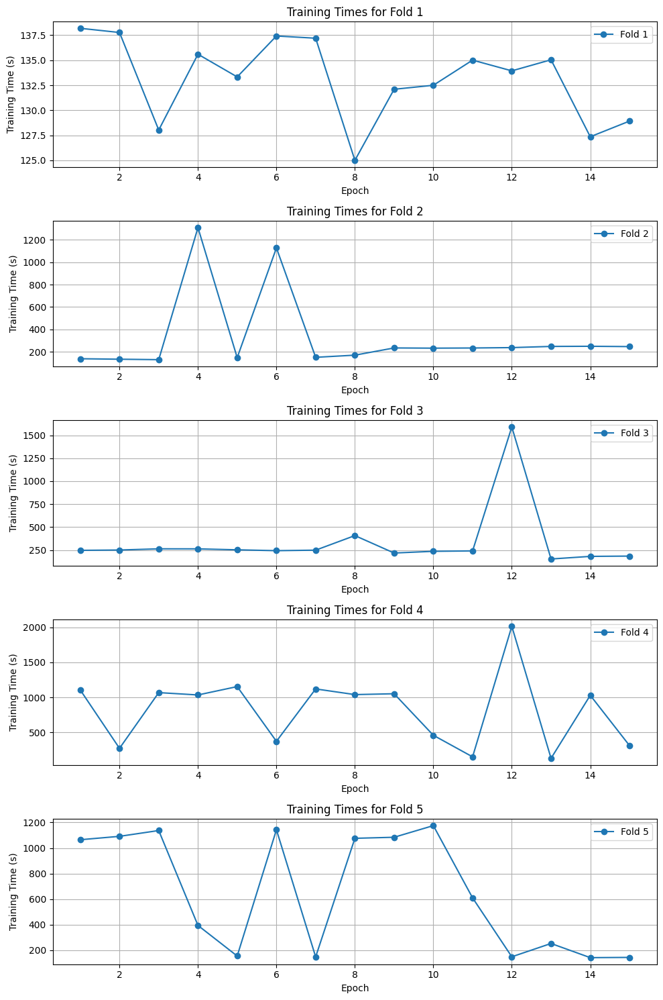

In [6]:
import matplotlib.pyplot as plt

fig, axes = plt.subplots(5, 1, figsize=(10, 15))

# Iterate through each fold and plot its training times
for i, fold in enumerate(all_train_times):
    axes[i].plot(range(1, 16), fold, marker='o', label=f'Fold {i+1}')
    axes[i].set_title(f'Training Times for Fold {i+1}')
    axes[i].set_xlabel('Epoch')
    axes[i].set_ylabel('Training Time (s)')
    axes[i].grid(True)
    axes[i].legend()

# Adjust layout to prevent overlap
plt.tight_layout()

# Show the plot
plt.show()

## Graph Train Loss for Each Fold

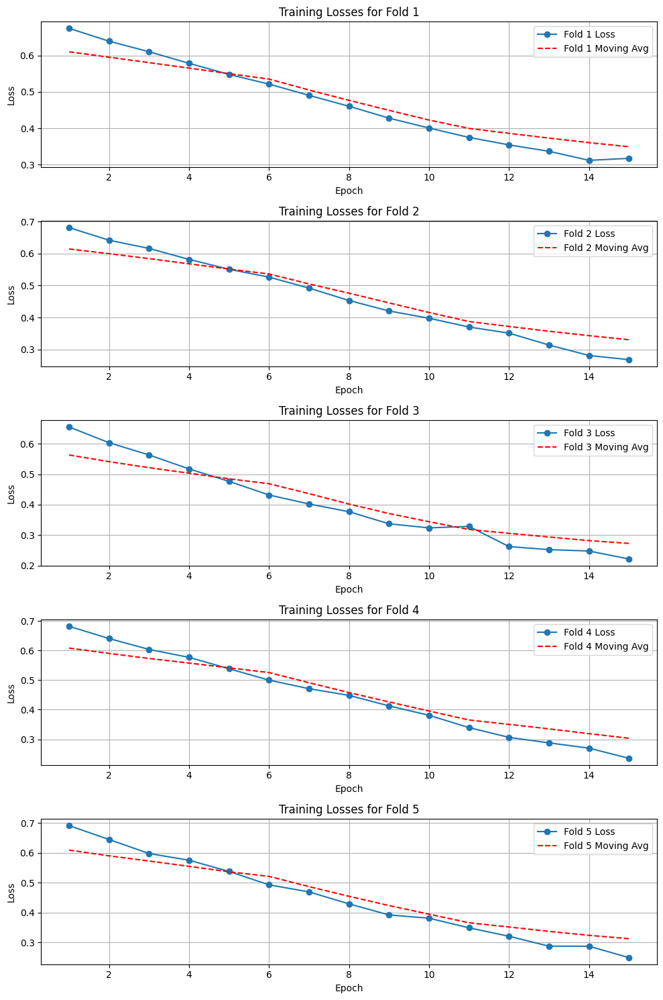

In [7]:

# Create a figure with 5 subplots (one for each fold)
fig, axes = plt.subplots(5, 1, figsize=(10, 15))

# Iterate through each fold and plot its training losses and moving average
for i, fold in enumerate(all_train_losses):
    # Convert the fold's loss values to a pandas Series for rolling mean
    tracking_loss = pd.Series(fold)
    
    # Ensure that the values are floats (necessary for rolling mean calculation)
    tracking_loss = tracking_loss.astype(float)
    
    # Calculate the rolling average with a window size of 10
    rolling_avg = tracking_loss.rolling(center=True, min_periods=1, window=10).mean()
    
    # Plot the original loss values
    axes[i].plot(range(1, len(fold) + 1), fold, marker='o', label=f'Fold {i+1} Loss')
    
    # Plot the moving average (rolling mean)
    axes[i].plot(range(1, len(fold) + 1), rolling_avg, linestyle='--', color='red', label=f'Fold {i+1} Moving Avg')
    
    # Set titles and labels
    axes[i].set_title(f'Training Losses for Fold {i+1}')
    axes[i].set_xlabel('Epoch')
    axes[i].set_ylabel('Loss')
    axes[i].grid(True)
    axes[i].legend()

# Adjust layout to prevent overlap
plt.tight_layout()

# Show the plot
plt.show()

### Graph Validation Loss for Each Fold

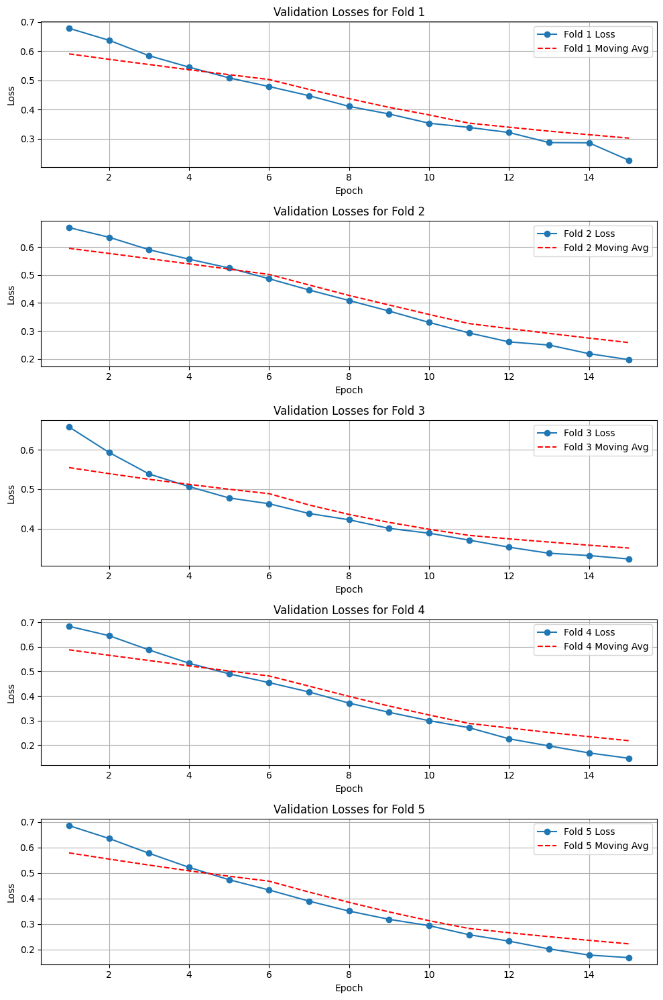

In [8]:
# Create a figure with 5 subplots (one for each fold)
fig, axes = plt.subplots(5, 1, figsize=(10, 15))

# Iterate through each fold and plot its training losses and moving average
for i, fold in enumerate(all_validation_loss):
    # Convert the fold's loss values to a pandas Series for rolling mean
    tracking_loss = pd.Series(fold)
    
    # Ensure that the values are floats (necessary for rolling mean calculation)
    tracking_loss = tracking_loss.astype(float)
    
    # Calculate the rolling average with a window size of 10
    rolling_avg = tracking_loss.rolling(center=True, min_periods=1, window=10).mean()
    
    # Plot the original loss values
    axes[i].plot(range(1, len(fold) + 1), fold, marker='o', label=f'Fold {i+1} Loss')
    
    # Plot the moving average (rolling mean)
    axes[i].plot(range(1, len(fold) + 1), rolling_avg, linestyle='--', color='red', label=f'Fold {i+1} Moving Avg')
    
    # Set titles and labels
    axes[i].set_title(f'Validation Losses for Fold {i+1}')
    axes[i].set_xlabel('Epoch')
    axes[i].set_ylabel('Loss')
    axes[i].grid(True)
    axes[i].legend()

# Adjust layout to prevent overlap
plt.tight_layout()

# Show the plot
plt.show()

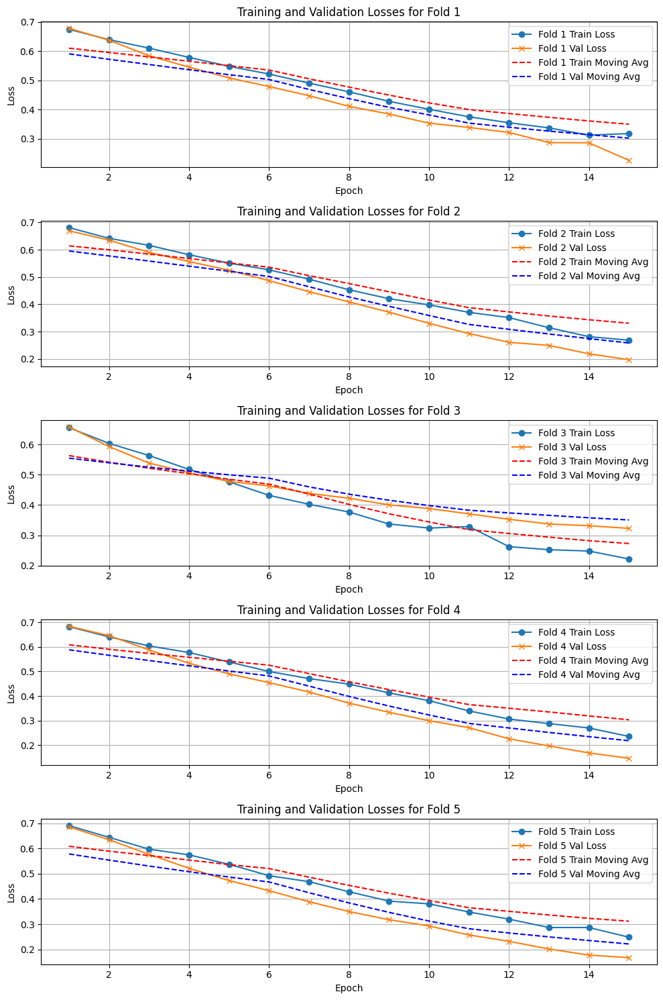

In [9]:
# Create a figure with 5 subplots (one for each fold)
fig, axes = plt.subplots(5, 1, figsize=(10, 15))

# Iterate through each fold and plot both training and validation losses with moving averages
for i, (train_loss, val_loss) in enumerate(zip(all_train_losses, all_validation_loss)):
    # Convert the training and validation loss values to pandas Series for rolling mean
    train_loss_series = pd.Series(train_loss).astype(float)
    val_loss_series = pd.Series(val_loss).astype(float)
    
    # Calculate the rolling average with a window size of 10
    train_rolling_avg = train_loss_series.rolling(center=True, min_periods=1, window=10).mean()
    val_rolling_avg = val_loss_series.rolling(center=True, min_periods=1, window=10).mean()
    
    # Plot the original training and validation losses
    axes[i].plot(range(1, len(train_loss) + 1), train_loss, marker='o', label=f'Fold {i+1} Train Loss')
    axes[i].plot(range(1, len(val_loss) + 1), val_loss, marker='x', label=f'Fold {i+1} Val Loss')
    
    # Plot the moving averages
    axes[i].plot(range(1, len(train_loss) + 1), train_rolling_avg, linestyle='--', color='red', label=f'Fold {i+1} Train Moving Avg')
    axes[i].plot(range(1, len(val_loss) + 1), val_rolling_avg, linestyle='--', color='blue', label=f'Fold {i+1} Val Moving Avg')
    
    # Set titles and labels
    axes[i].set_title(f'Training and Validation Losses for Fold {i+1}')
    axes[i].set_xlabel('Epoch')
    axes[i].set_ylabel('Loss')
    axes[i].grid(True)
    axes[i].legend()

# Adjust layout to prevent overlap
plt.tight_layout()

# Show the plot
plt.show()

### Bar Charts for Each Metric for Test Per Species

{'accuracy': [[0.04950495049504955, 0.9504950495049505], [0.04950495049504955, 0.9504950495049505], [0.02970297029702973, 0.9702970297029703], [0.10999999999999999, 0.89], [0.020000000000000018, 0.98]], 'precision': [array([0.95      , 0.95121951]), array([0.93650794, 0.97368421]), array([0.98305085, 0.95238095]), array([0.875     , 0.91666667]), array([0.96721311, 1.        ])], 'recall': [array([0.96610169, 0.92857143]), array([0.98333333, 0.90243902]), array([0.96666667, 0.97560976]), array([0.94915254, 0.80487805]), array([1.        , 0.95121951])], 'f1': [array([0.95798319, 0.93975904]), array([0.95934959, 0.93670886]), array([0.97478992, 0.96385542]), array([0.91056911, 0.85714286]), array([0.98333333, 0.975     ])], 'auc': [np.float64(0.9858757062146892), np.float64(0.9837398373983739), np.float64(0.994308943089431), np.float64(0.9805704836709385), np.float64(1.0)]}


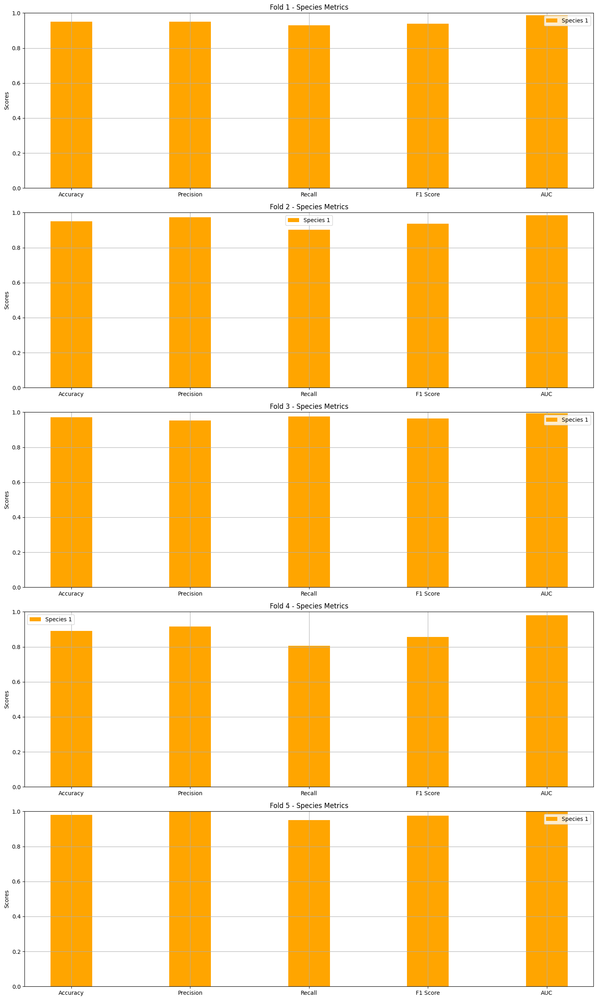


Fold 1 Metrics:
Accuracy: 0.9505, Precision: 0.9512, Recall: 0.9286, F1 Score: 0.9398, AUC: 0.9859

Fold 2 Metrics:
Accuracy: 0.9505, Precision: 0.9737, Recall: 0.9024, F1 Score: 0.9367, AUC: 0.9837

Fold 3 Metrics:
Accuracy: 0.9703, Precision: 0.9524, Recall: 0.9756, F1 Score: 0.9639, AUC: 0.9943

Fold 4 Metrics:
Accuracy: 0.8900, Precision: 0.9167, Recall: 0.8049, F1 Score: 0.8571, AUC: 0.9806

Fold 5 Metrics:
Accuracy: 0.9800, Precision: 1.0000, Recall: 0.9512, F1 Score: 0.9750, AUC: 1.0000


In [14]:
import matplotlib.pyplot as plt
import numpy as np

print(all_per_species_test_metrics)

# Number of metrics per fold (Accuracy, Precision, Recall, F1, AUC)
num_metrics = 5

# X positions for each metric group
x = np.arange(num_metrics)  # No need for species-based indexing

# Bar width
width = 0.35

# Create subplots for each fold (one bar chart with all metrics)
fig, axes = plt.subplots(5, figsize=(15, 5 * 5))

# Metric labels
metric_labels = ['Accuracy', 'Precision', 'Recall', 'F1 Score', 'AUC']

# Iterate over each fold to create the bar charts
for fold in range(5):
    # Extract per-species metrics for this fold
    species_1_accuracy = all_per_species_test_metrics['accuracy'][fold][1]
    species_1_precision = all_per_species_test_metrics['precision'][fold][1]
    species_1_recall = all_per_species_test_metrics['recall'][fold][1]
    species_1_f1 = all_per_species_test_metrics['f1'][fold][1]
    species_1_auc = all_test_metrics['auc'][fold]

    # Create the bars for this fold (only Species 1)
    axes[fold].bar(x, [species_1_accuracy, species_1_precision, species_1_recall, species_1_f1, species_1_auc],
                   width, label='Species 1', color='orange')

    axes[fold].set_title(f"Fold {fold + 1} - Species Metrics")
    axes[fold].set_xticks(x)
    axes[fold].set_xticklabels(metric_labels)
    axes[fold].set_ylabel('Scores')
    axes[fold].set_ylim(0, 1)  # Ensuring y-axis ranges from 0 to 1 for metric comparison
    axes[fold].legend()
    axes[fold].grid(True)

# Adjust layout to prevent overlap
plt.tight_layout()

# Show the plot
plt.show()

# Print only Species 1 metrics per fold
for fold in range(5):
    print(f"\nFold {fold + 1} Metrics:")
    print(f"Accuracy: {all_per_species_test_metrics['accuracy'][fold][1]:.4f}, "
          f"Precision: {all_per_species_test_metrics['precision'][fold][1]:.4f}, "
          f"Recall: {all_per_species_test_metrics['recall'][fold][1]:.4f}, "
          f"F1 Score: {all_per_species_test_metrics['f1'][fold][1]:.4f}, "
          f"AUC: {all_test_metrics['auc'][fold]:.4f}")


### Average Over All Test Metrics Per Species

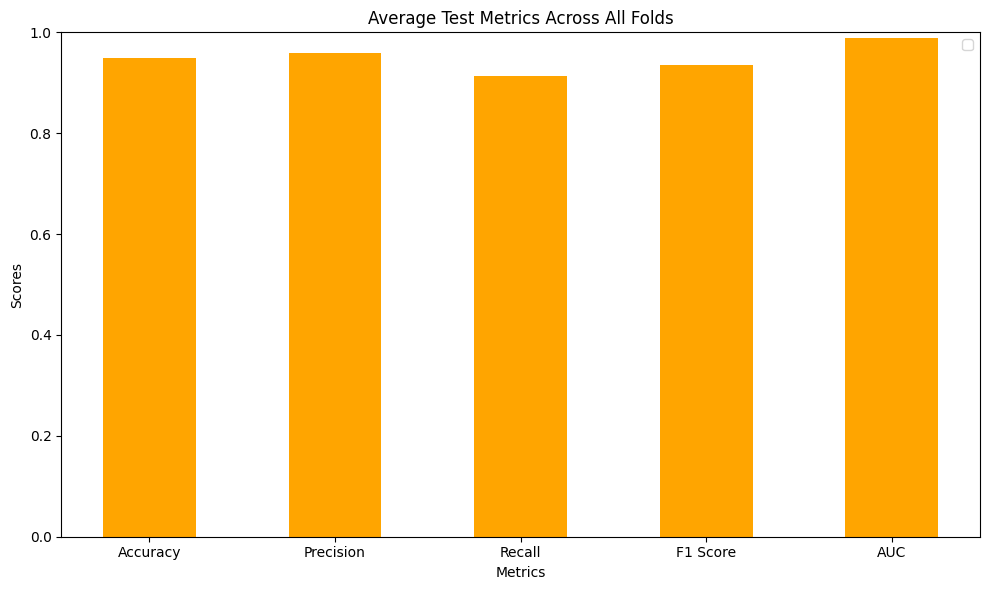

Average Test Metrics Across All Folds:
Accuracy: 0.9483, Precision: 0.9588, Recall: 0.9125, F1 Score: 0.9345, AUC: 0.9889


In [16]:
import matplotlib.pyplot as plt
import numpy as np

# Metric labels
metric_labels = ['Accuracy', 'Precision', 'Recall', 'F1 Score', 'AUC']

# Calculate the average values for each metric across all folds (only Species 1)
avg_accuracy_species_1 = np.mean([metrics[1] for metrics in all_per_species_test_metrics['accuracy']])
avg_precision_species_1 = np.mean([metrics[1] for metrics in all_per_species_test_metrics['precision']])
avg_recall_species_1 = np.mean([metrics[1] for metrics in all_per_species_test_metrics['recall']])
avg_f1_species_1 = np.mean([metrics[1] for metrics in all_per_species_test_metrics['f1']])
avg_auc_species_1 = np.mean(all_test_metrics['auc'])

# Create a bar chart for Species 1
x = np.arange(len(metric_labels))  # X positions for each metric
width = 0.5  # Adjusted bar width since we're only plotting one species

fig, ax = plt.subplots(figsize=(10, 6))

ax.bar(x, [avg_accuracy_species_1, avg_precision_species_1, avg_recall_species_1, avg_f1_species_1, avg_auc_species_1],
       width, color='orange')

# Add labels, title, and legend
ax.set_xlabel('Metrics')
ax.set_ylabel('Scores')
ax.set_title('Average Test Metrics Across All Folds')
ax.set_xticks(x)
ax.set_xticklabels(metric_labels)
ax.set_ylim(0, 1)  # y-axis range from 0 to 1 for comparison
ax.legend()

# Show the plot
plt.tight_layout()
plt.show()

# Print the average test metrics (only Species 1)
print("Average Test Metrics Across All Folds:")
print(f"Accuracy: {avg_accuracy_species_1:.4f}, Precision: {avg_precision_species_1:.4f}, "
      f"Recall: {avg_recall_species_1:.4f}, F1 Score: {avg_f1_species_1:.4f}, AUC: {avg_auc_species_1:.4f}")


### Average Overall Across All Folds for Test Metrics

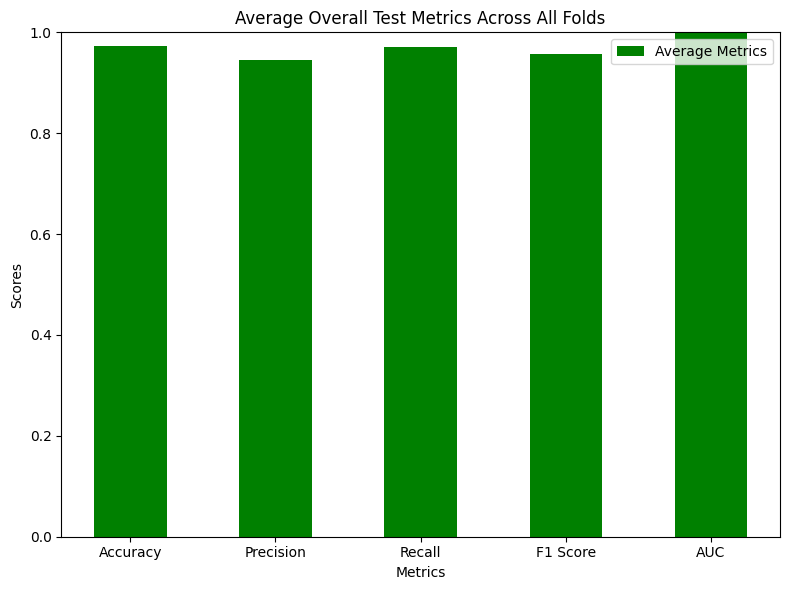

Average Overall Test Metrics Across All Folds:
Accuracy: 0.9724
Precision: 0.9455
Recall: 0.9707
F1 Score: 0.9567
AUC: 0.9989


In [40]:
# Calculate the average values for each metric across all folds
avg_accuracy = np.mean(all_test_metrics['accuracy'])
avg_precision = np.mean(all_test_metrics['precision'])
avg_recall = np.mean(all_test_metrics['recall'])
avg_f1 = np.mean(all_test_metrics['f1'])
avg_auc = np.mean(all_test_metrics['auc'])

# Create a bar chart to display the average values
metric_labels = ['Accuracy', 'Precision', 'Recall', 'F1 Score', 'AUC']
avg_metrics = [avg_accuracy, avg_precision, avg_recall, avg_f1, avg_auc]

x = np.arange(len(metric_labels))  # x positions for each metric
width = 0.5  # Bar width

# Plot the averages for overall metrics
fig, ax = plt.subplots(figsize=(8, 6))
ax.bar(x, avg_metrics, width, color='green', label='Average Metrics')

# Add labels, title, and legend
ax.set_xlabel('Metrics')
ax.set_ylabel('Scores')
ax.set_title('Average Overall Test Metrics Across All Folds')
ax.set_xticks(x)
ax.set_xticklabels(metric_labels)
ax.set_ylim(0, 1)  # y-axis range from 0 to 1 for comparison
ax.legend()

# Show the plot
plt.tight_layout()
plt.show()

# Print the average overall test metrics
print("Average Overall Test Metrics Across All Folds:")
print(f"Accuracy: {avg_accuracy:.4f}")
print(f"Precision: {avg_precision:.4f}")
print(f"Recall: {avg_recall:.4f}")
print(f"F1 Score: {avg_f1:.4f}")
print(f"AUC: {avg_auc:.4f}")

### Overall Per Fold for Test

Fold 1:
  Accuracy  : 1.0000
  Precision : 1.0000
  Recall    : 1.0000
  F1 Score  : 1.0000
  AUC       : 1.0000

Fold 2:
  Accuracy  : 1.0000
  Precision : 1.0000
  Recall    : 1.0000
  F1 Score  : 1.0000
  AUC       : 1.0000

Fold 3:
  Accuracy  : 1.0000
  Precision : 1.0000
  Recall    : 1.0000
  F1 Score  : 1.0000
  AUC       : 1.0000

Fold 4:
  Accuracy  : 0.9692
  Precision : 0.9707
  Recall    : 0.9578
  F1 Score  : 0.9639
  AUC       : 0.9973

Fold 5:
  Accuracy  : 0.9615
  Precision : 0.9583
  Recall    : 0.9522
  F1 Score  : 0.9552
  AUC       : 0.9951



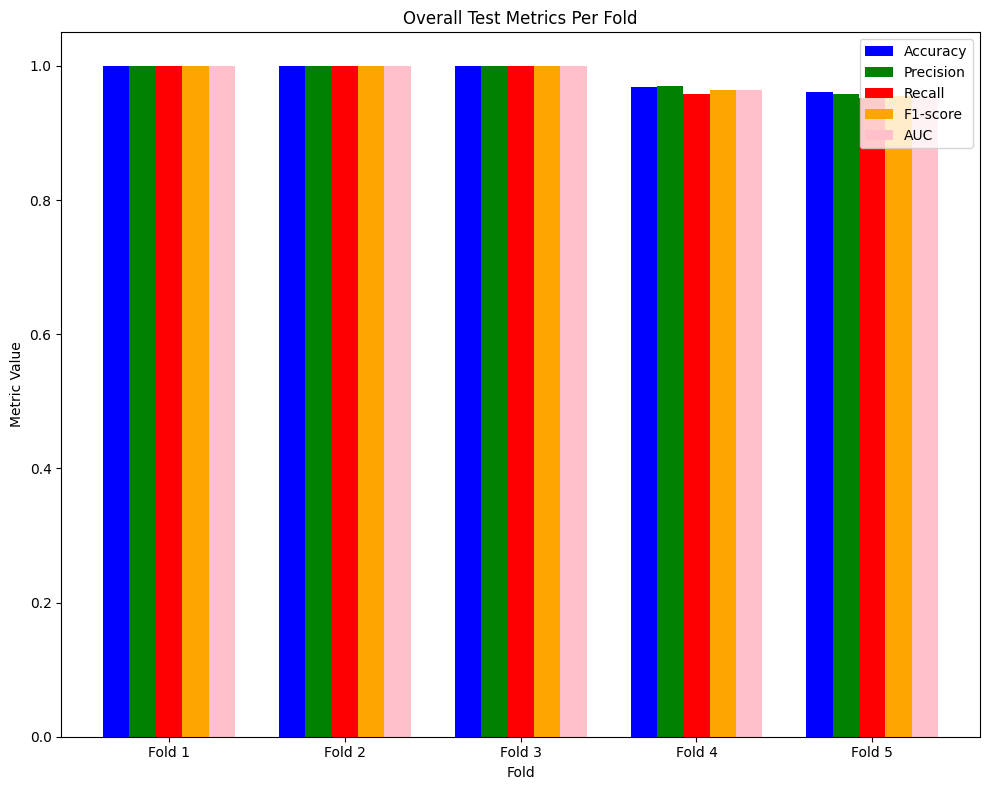

In [100]:
# Set up positions for the bars
folds = range(1, len(all_test_metrics['accuracy']) + 1)

# Set up the bar width
width = 0.15

# Create a figure
plt.figure(figsize=(10, 8))

# Plot one bar chart per fold
for fold in range(len(folds)):
    # Get the metrics for the current fold
    accuracy = all_test_metrics['accuracy'][fold]
    precision = all_test_metrics['precision'][fold]
    recall = all_test_metrics['recall'][fold]
    f1 = all_test_metrics['f1'][fold]
    auc = all_test_metrics['auc'][fold]

    # Print the metrics for this fold
    print(f"Fold {fold + 1}:")
    print(f"  Accuracy  : {accuracy:.4f}")
    print(f"  Precision : {precision:.4f}")
    print(f"  Recall    : {recall:.4f}")
    print(f"  F1 Score  : {f1:.4f}")
    print(f"  AUC       : {auc:.4f}\n")
    
    # Set x positions for the bars
    bar_positions = np.array([fold + 1 - 2 * width, fold + 1 - width, fold + 1, fold + 1 + width, fold + 1 + 2 * width])
    
    # Plot bars for the current fold
    plt.bar(bar_positions[0], accuracy, width, label='Accuracy' if fold == 0 else "", color='b')
    plt.bar(bar_positions[1], precision, width, label='Precision' if fold == 0 else "", color='g')
    plt.bar(bar_positions[2], recall, width, label='Recall' if fold == 0 else "", color='r')
    plt.bar(bar_positions[3], f1, width, label='F1-score' if fold == 0 else "", color='orange')
    plt.bar(bar_positions[4], f1, width, label='AUC' if fold == 0 else "", color='pink')

# Labeling the graph
plt.title('Overall Test Metrics Per Fold')
plt.xlabel('Fold')
plt.ylabel('Metric Value')
plt.xticks(folds, [f'Fold {i}' for i in folds])

# Display the legend
plt.legend()

# Show the plot
plt.tight_layout()
plt.show()

## Which Images Did Test Get Wrong?

Processing Confusion Matrix for Fold 1


/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


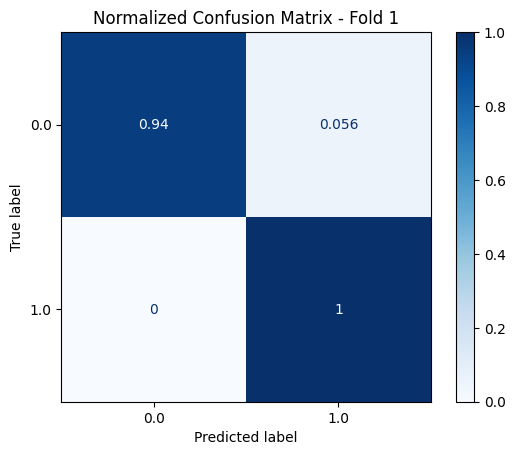

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_1194.JPG
Predicted Label: tensor([1], dtype=torch.int32), True Label: 0.0


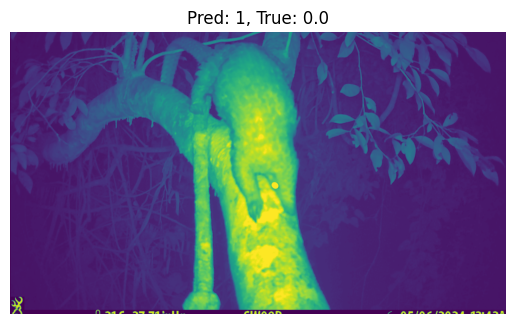

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_0271.JPG
Predicted Label: tensor([1], dtype=torch.int32), True Label: 0.0


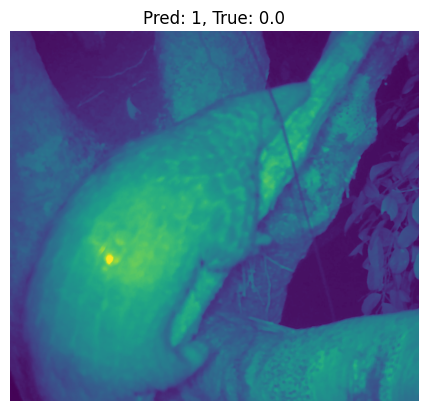

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_1174.JPG
Predicted Label: tensor([1], dtype=torch.int32), True Label: 0.0


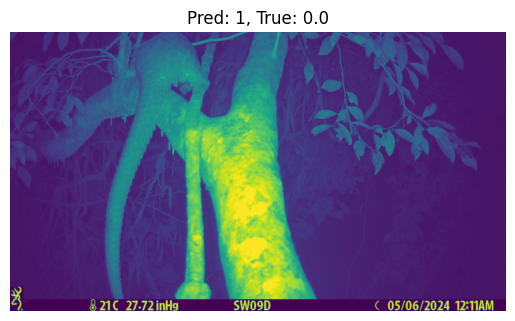

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_1194.JPG
Predicted Label: tensor([1], dtype=torch.int32), True Label: 0.0


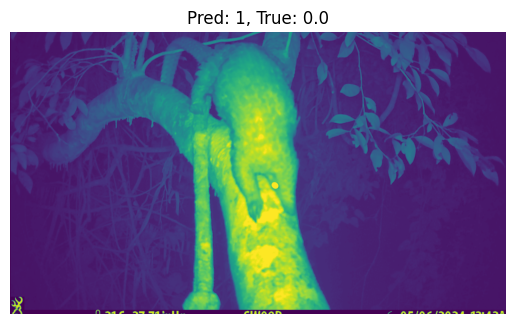

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_0252.JPG
Predicted Label: tensor([1], dtype=torch.int32), True Label: 0.0


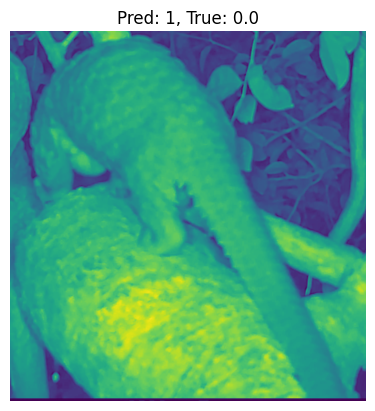

Processing Confusion Matrix for Fold 2


/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


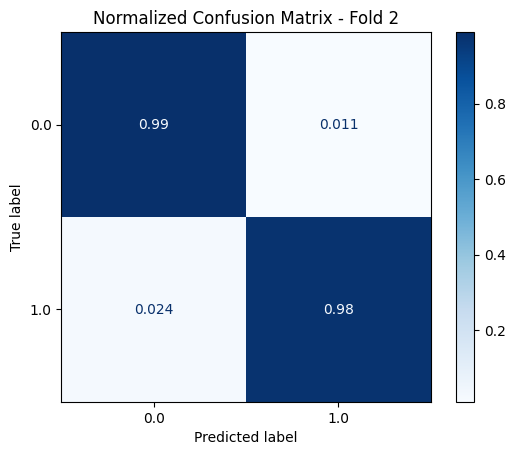

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_1097.JPG
Predicted Label: tensor([0], dtype=torch.int32), True Label: 1.0


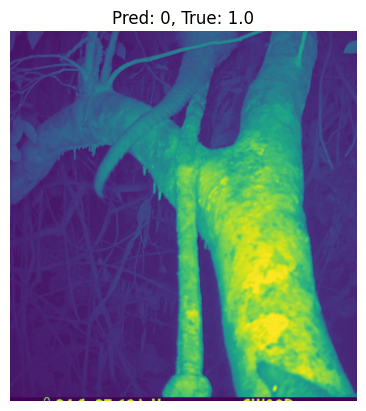

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_0558.JPG
Predicted Label: tensor([1], dtype=torch.int32), True Label: 0.0


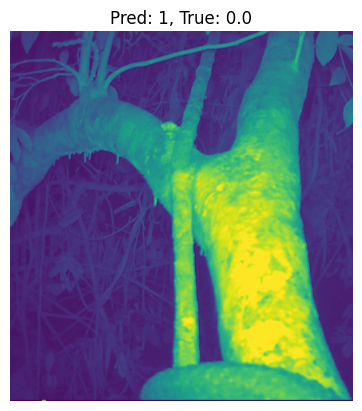

Processing Confusion Matrix for Fold 3


/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


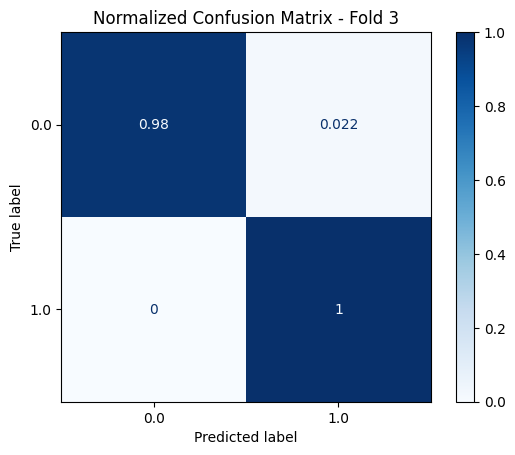

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_0966.JPG
Predicted Label: tensor([1], dtype=torch.int32), True Label: 0.0


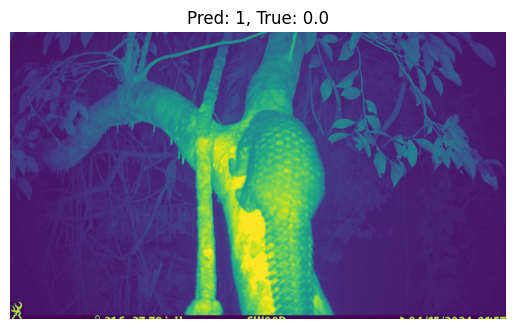

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_1637.JPG
Predicted Label: tensor([1], dtype=torch.int32), True Label: 0.0


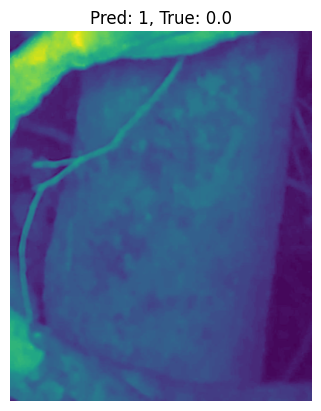

Processing Confusion Matrix for Fold 4


/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


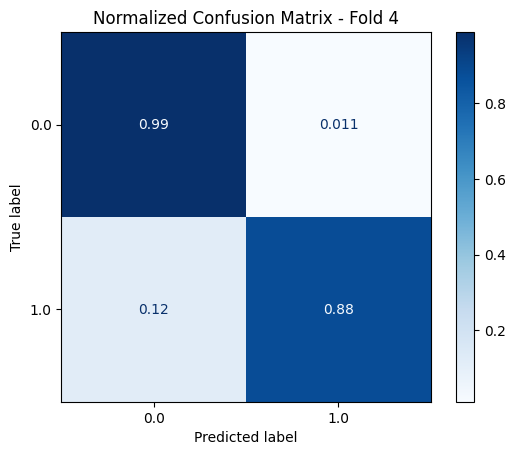

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_1197.JPG
Predicted Label: tensor([0], dtype=torch.int32), True Label: 1.0


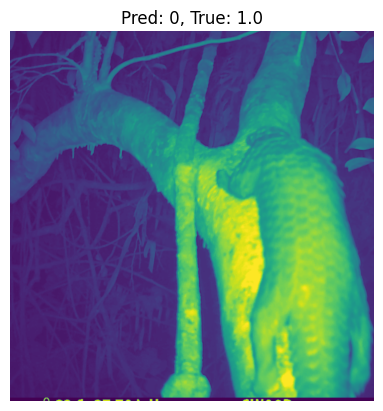

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_1179.JPG
Predicted Label: tensor([0], dtype=torch.int32), True Label: 1.0


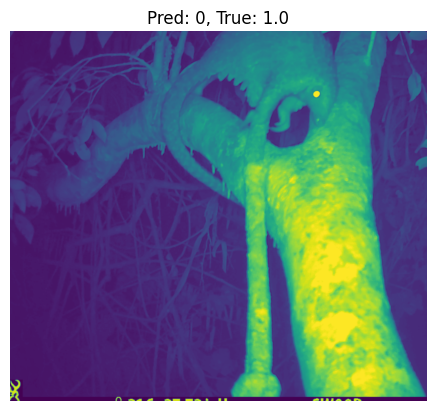

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_1176.JPG
Predicted Label: tensor([0], dtype=torch.int32), True Label: 1.0


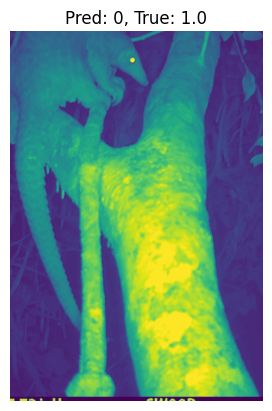

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_1198.JPG
Predicted Label: tensor([0], dtype=torch.int32), True Label: 1.0


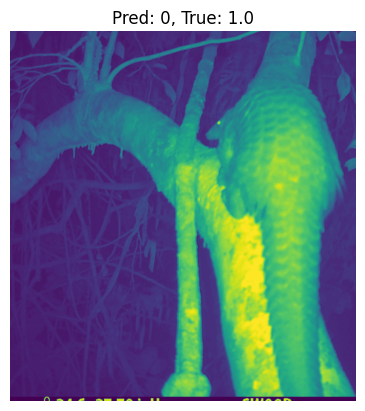

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_1285.JPG
Predicted Label: tensor([0], dtype=torch.int32), True Label: 1.0


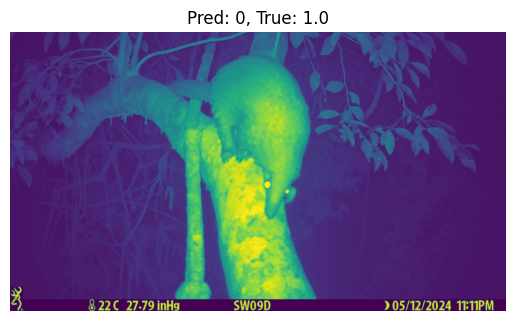

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_0417.JPG
Predicted Label: tensor([1], dtype=torch.int32), True Label: 0.0


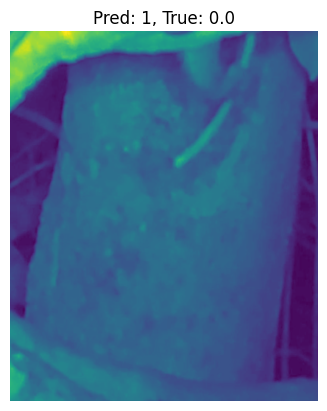

Processing Confusion Matrix for Fold 5


/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/Users/jeenamahajan/Desktop/OP_Species_Identification_Model/.venv/lib/python3.12/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=DenseNet121_Weights.IMAGENET1K_V1`. You can also use `weights=DenseNet121_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


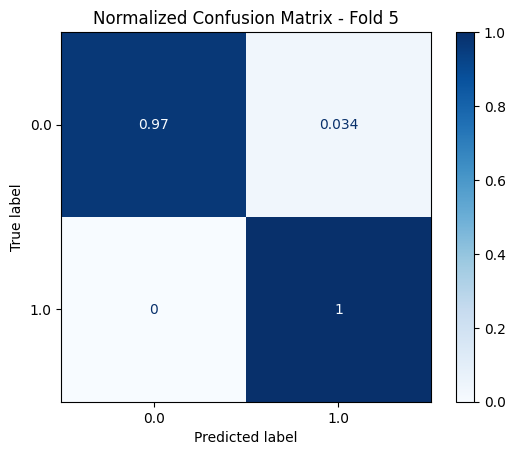

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_1142.JPG
Predicted Label: tensor([1], dtype=torch.int32), True Label: 0.0


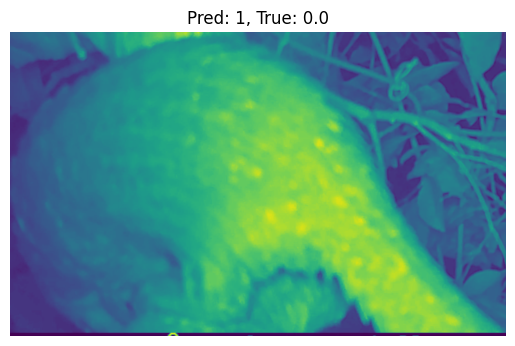

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_0251.JPG
Predicted Label: tensor([1], dtype=torch.int32), True Label: 0.0


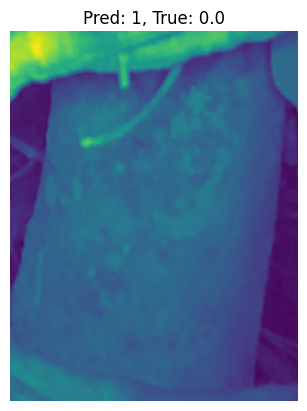

Misclassified Image: Pangolin_Images_3_12_Preprocessed/IMG_1170.JPG
Predicted Label: tensor([1], dtype=torch.int32), True Label: 0.0


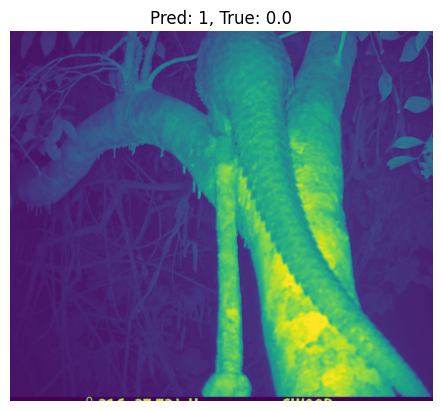

In [46]:
import matplotlib.pyplot as plt
import torchvision.transforms as transforms
from PIL import Image



strat_kf = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)  # Shuffle data with random_seed = 42 for reproducibility

for fold, (train_index, test_index) in enumerate(strat_kf.split(combined_df, y_train)):
    print(f"Processing Confusion Matrix for Fold {fold + 1}")

    # Retrieve the SAME test set as before
    test_data = x_train.iloc[test_index]  # File paths for testing set
    test_labels = y_train[test_index]  # Labels for testing set

    # Filter out .DS_Store files (same as before)
    test_data = test_data[~test_data['filepath'].str.endswith('.DS_Store')]

    # Create dataset and dataloader (must match original format)
    test_dataset = ImagesDataset(test_data, test_labels)
    test_loader = DataLoader(test_dataset, batch_size=32, shuffle=False)

    # Load the trained model for this fold
    model = models.densenet121(pretrained=False)  
    model.classifier = nn.Sequential(  # Replace the classifier layer
        nn.Linear(1024, 100),  # Dense layer takes a 1024-dim input and outputs 100-dim
        nn.ReLU(inplace=True),  # ReLU activation
        nn.Dropout(0.1),  # Dropout for regularization
        nn.Linear(100, 1),  # Final layer for 1 class
        nn.Sigmoid()
    )
    model.load_state_dict(torch.load(f"arboreal_false_best_model_fold_{fold+1}.pth"))
    model.eval()  

    # Get predictions on the test set
    test_preds, test_labels = [], []
    misclassified_images = []  # To store misclassified images and their predictions
    with torch.no_grad():
        for batch in test_loader:
            images, labels = batch['image'], batch['label']
            labels = labels.unsqueeze(1).float()
            outputs = model(images)
            
            # For binary classification, get the probabilities for class 1
            #probs = torch.sigmoid(outputs).squeeze()  # Squeeze to remove extra dimensions
            preds = (outputs > 0.5).int()
            test_preds.extend(preds.cpu().numpy())  # Predicted label: 1 if prob > 0.5, else 0
            test_labels.extend(labels.cpu().numpy())  # Get true labels

            # Check for misclassified samples
            for i in range(len(preds)):
                if preds[i] != labels[i].item():  # If prediction is incorrect
                    misclassified_images.append((test_data.iloc[i]['filepath'], preds[i], labels[i].item(), images[i]))

            #test_outputs.extend(probs.cpu().detach().numpy())  # Get probabilities for the positive class
            #test_probs.extend(outputs.cpu().detach().numpy())  # Store probabilities for AUC calculation


    #test_outputs = np.array(test_probs)
    #test_labels = np.array(test_labels)
    test_labels = np.array(test_labels)
    test_preds = np.array(test_preds)
    #test_probs = np.array(test_probs)
    

    
    # Compute and display the normalized confusion matrix
    disp = ConfusionMatrixDisplay.from_predictions(test_labels, test_preds, normalize='true', cmap='Blues')
    disp.ax_.set_title(f"Normalized Confusion Matrix - Fold {fold+1}")
    plt.show()

    # Now print out the misclassified images
    for file_path, pred, true_label, image in misclassified_images:
        print(f"Misclassified Image: {file_path}")
        print(f"Predicted Label: {pred}, True Label: {true_label}")

        # Load and display the image
        img = Image.open(file_path)
        plt.imshow(img)
        plt.title(f"Pred: {pred.item()}, True: {true_label}")
        plt.axis('off')  # Turn off axis labels
        plt.show()



        



In [10]:
from sklearn.model_selection import StratifiedKFold, train_test_split
import numpy as np
from collections import Counter

# Assume strat_kf, combined_df, x_train, and y_train are already defined
strat_kf = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

for fold, (train_index, test_index) in enumerate(strat_kf.split(combined_df, y_train)):  # Stratified split
    print(f"Fold {fold+1}/{5}")

    # Split data
    train_data = x_train.iloc[train_index]  # File paths for training set
    test_data = x_train.iloc[test_index]  # File paths for testing set
    train_labels = y_train[train_index]  # Labels for training set
    test_labels = y_train[test_index]  # Labels for testing set

    #print(f"Test indices (Fold {fold+1}): {test_index.tolist()}")

    # Further split the training data into training and validation (90/10 split)
    train_data, val_data, train_labels, val_labels, train_idx, val_idx = train_test_split(
        train_data, train_labels,  # Original training data and labels
        train_index,  # Pass train_index to track indices
        test_size=0.1,  # 10% of train_data becomes val_data
        stratify=train_labels,  # Ensures class proportions are preserved
        random_state=42  # For reproducibility
    )

    #print(f"Train indices (Fold {fold+1}): {train_idx.tolist()}")
    #print(f"Validation indices (Fold {fold+1}): {val_idx.tolist()}")
    
    print(f"Train size: {len(train_idx)}, Validation size: {len(val_idx)}, Test size: {len(test_index)}")

    # Print label distributions
    print(f"Train label counts (Fold {fold+1}): {dict(Counter(train_labels))}")
    print(f"Validation label counts (Fold {fold+1}): {dict(Counter(val_labels))}")
    print(f"Test label counts (Fold {fold+1}): {dict(Counter(test_labels))}")
    print("\n")


    

Fold 1/5
Train size: 469, Validation size: 53, Test size: 131
Train label counts (Fold 1): {np.int64(0): 322, np.int64(1): 147}
Validation label counts (Fold 1): {np.int64(0): 36, np.int64(1): 17}
Test label counts (Fold 1): {np.int64(1): 42, np.int64(0): 89}


Fold 2/5
Train size: 469, Validation size: 53, Test size: 131
Train label counts (Fold 2): {np.int64(0): 321, np.int64(1): 148}
Validation label counts (Fold 2): {np.int64(0): 36, np.int64(1): 17}
Test label counts (Fold 2): {np.int64(1): 41, np.int64(0): 90}


Fold 3/5
Train size: 469, Validation size: 53, Test size: 131
Train label counts (Fold 3): {np.int64(0): 321, np.int64(1): 148}
Validation label counts (Fold 3): {np.int64(0): 36, np.int64(1): 17}
Test label counts (Fold 3): {np.int64(1): 41, np.int64(0): 90}


Fold 4/5
Train size: 470, Validation size: 53, Test size: 130
Train label counts (Fold 4): {np.int64(0): 322, np.int64(1): 148}
Validation label counts (Fold 4): {np.int64(0): 36, np.int64(1): 17}
Test label counts

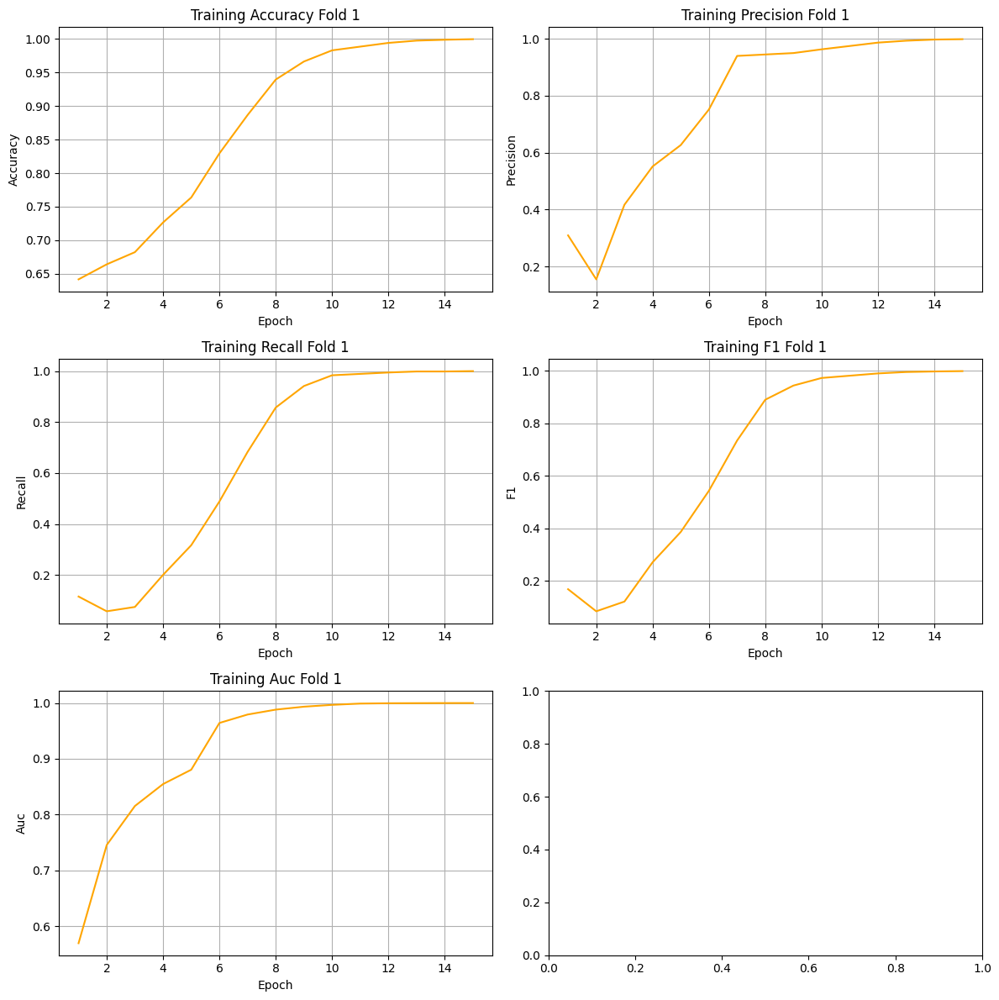

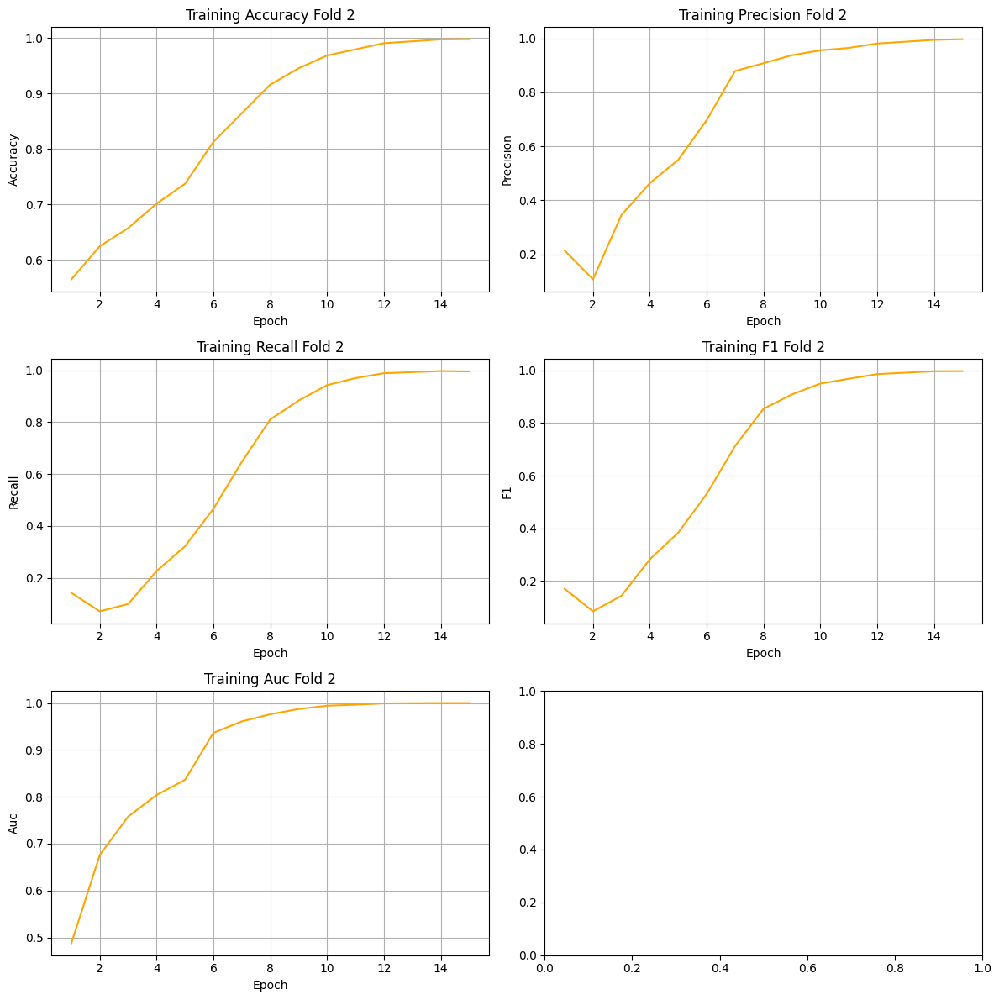

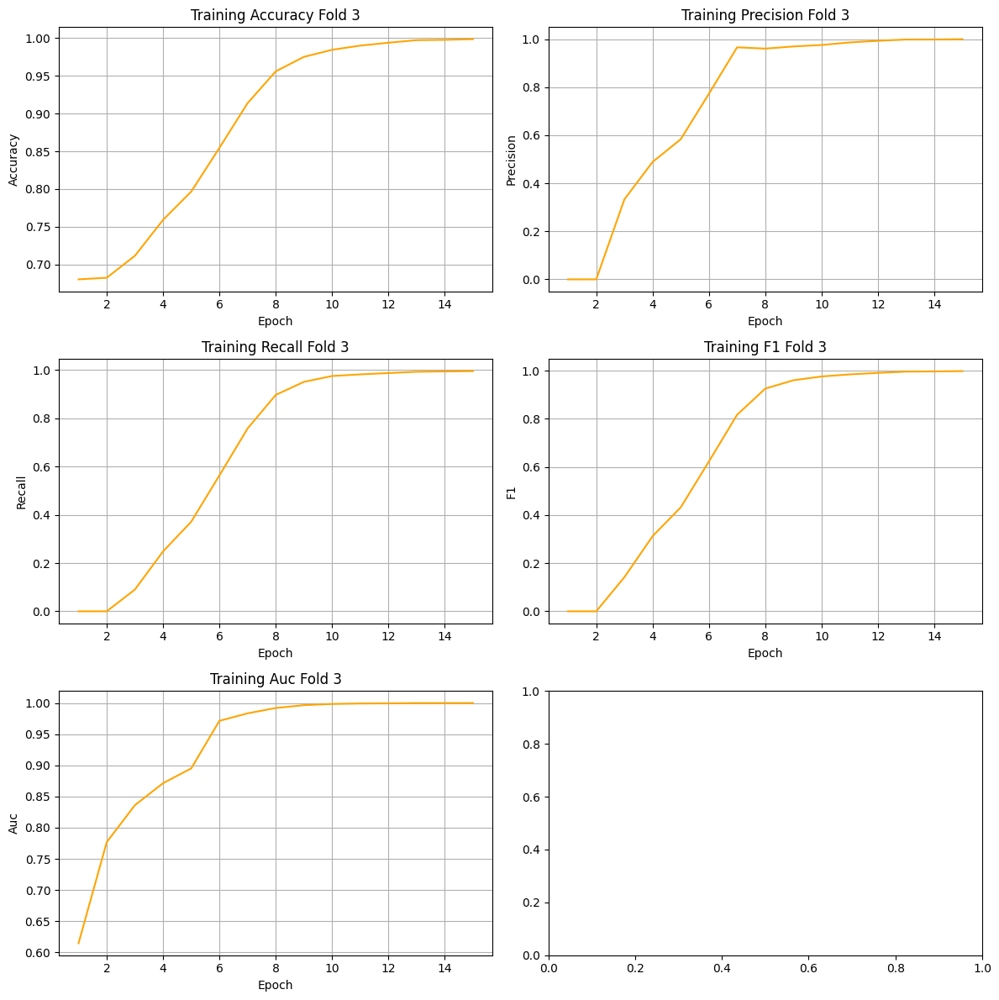

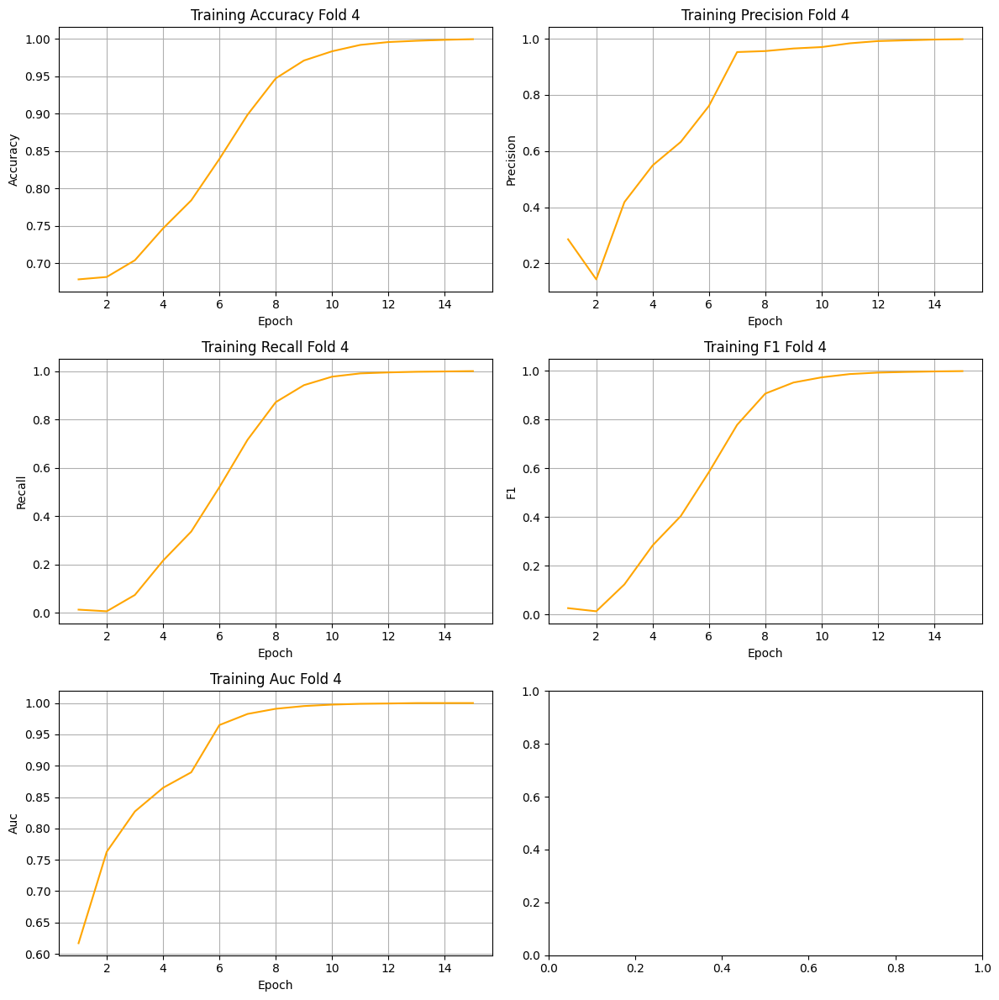

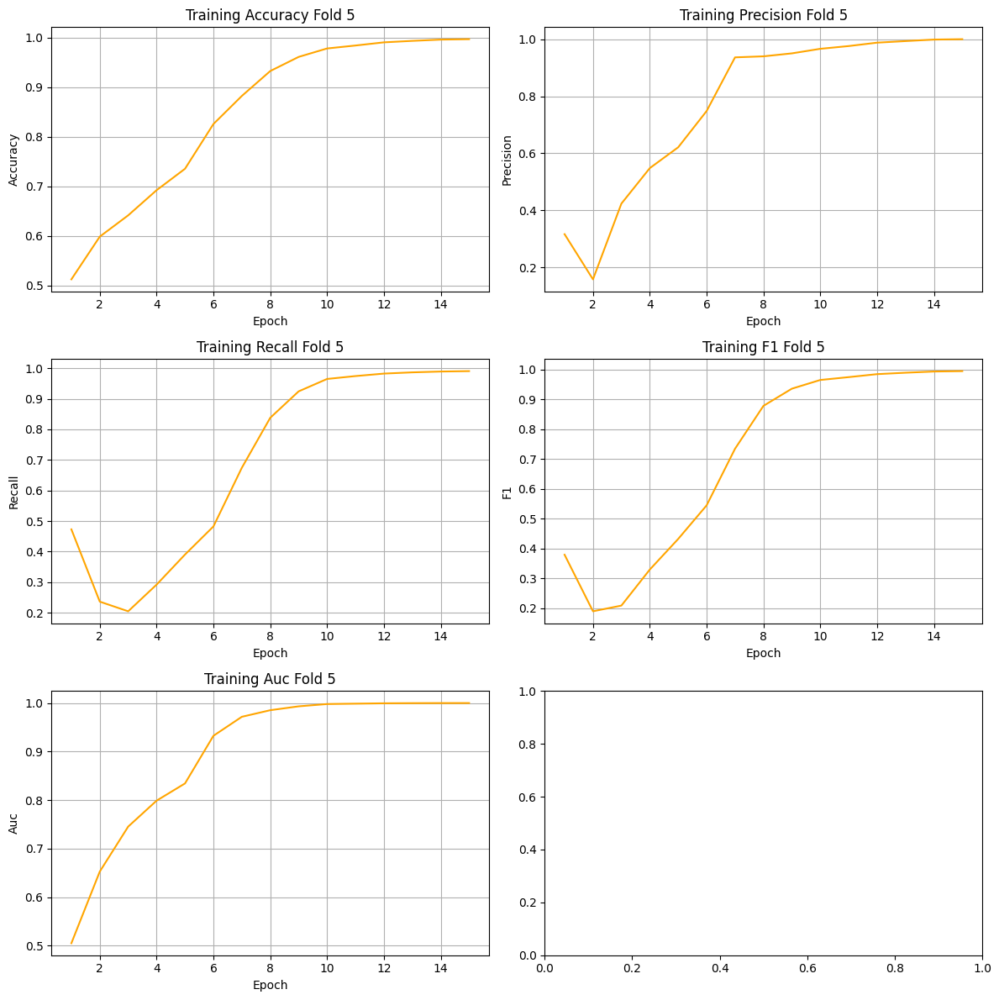

In [43]:
import matplotlib.pyplot as plt
import pandas as pd

# Function to create a DataFrame for Species 1 only
def create_dataframe_species_1(fold_data):
    species_1_values = [data[1] for data in fold_data]  # Extract only Species 1 values
    df = pd.DataFrame({
        "Species 1": species_1_values
    })
    df['Epoch'] = df.index + 1  # Add 'Epoch' column (starting from 1)
    return df

# Function to plot metrics for Species 1
def plot_metrics_for_species_1(fold_number, per_epoch_accuracy, per_epoch_precision, per_epoch_f1, per_epoch_recall, per_epoch_auc):
    metrics = ['accuracy', 'precision', 'recall', 'f1', 'auc']
    
    # Create subplots for each metric (single species)
    fig, axs = plt.subplots(3, 2, figsize=(12, 12))

    # For each metric, plot the values with moving averages
    for i, metric in enumerate(metrics):
        row = i // 2
        col = i % 2

        # Select the appropriate data for the current fold and metric
        if metric == 'accuracy':
            data = per_epoch_accuracy
        elif metric == 'precision':
            data = per_epoch_precision
        elif metric == 'f1':
            data = per_epoch_f1
        elif metric == 'recall':
            data = per_epoch_recall
        elif metric == 'auc':
            data = per_epoch_auc
        
        # Create a DataFrame for the metric data (Species 1 only)
        df = create_dataframe_species_1(data)
        
        # Calculate the moving average for Species 1
        df['Species 1 MA'] = df['Species 1'].rolling(window=5, min_periods=1).mean()

        # Plot the values for Species 1
        axs[row, col].plot(df['Epoch'], df['Species 1 MA'], label='Species 1', color='orange')
        axs[row, col].set_title(f'Training {metric.capitalize()} Fold {fold_number}')
        axs[row, col].set_xlabel('Epoch')
        axs[row, col].set_ylabel(f'{metric.capitalize()}')
        #axs[row, col].legend()
        axs[row, col].grid(True)

    # Adjust layout
    plt.tight_layout()
    plt.show()

# Plot metrics for each fold (Species 1 only)
for fold_number in range(1, 6):
    plot_metrics_for_species_1(fold_number, 
                               all_per_species_train_metrics['accuracy'][fold_number-1], 
                               all_per_species_train_metrics['precision'][fold_number-1], 
                               all_per_species_train_metrics['f1'][fold_number-1], 
                               all_per_species_train_metrics['recall'][fold_number-1], 
                               all_per_species_train_metrics['auc'][fold_number-1])
